# Experiment 5: Generalize experiment 1 to compare more classifiers and features

This notebook repeats and extends experiment 1 to include additional classifier models and compare different forms of features to see if any consistently improve image verfication.  


Broadly speaking, we'll compare:
1. Naive Bayes (NB) using log-likelihood ratios as scores (LLR)
1. Naive Bayes (NB), using other scores which are NOT LLR scores
1. Random Forest (RF)
1. XGBoost (XGB)

We'll compare a few different kinds of features too.

## Features

* One NB classifier will use compression levels only as a feature (CL).
* In remaining classifiers, we'll test encoding tuples (Filetype, CompressionLevel, (QuantizationMatrix)) into 1D categorical features, with Label Encoding. Since features are represented by 1 combined categorical feature, we'll call these features "QM1f".  (Note that quantization matrices are only present for jpeg images; that's ok, tuples without a quantization matrix can be encoded to a categorical variable as easily as tuples with quantization matrices.)
* We'll also test splitting the 3 compression settings into 3 separate features (Filetype),(CompressionLevel),(QuantizationMatrix), which we'll denote collectivley as "QM3f", and see if it makes a difference vs QM1f features.


## List of experiments
Here's the list of Naive Bayes classifier variants to compare:
1. "NB_LLR_CL": Using CL features only. Fits NB model, and computes classifier score as LLR score $score = \log \frac{P(c|\overline{s})}{P(c|s)}$.  (In Experiment 1, I called this simply "CL". Interpretation: this is the log of the likelihood to see compression setting c from sources NOT S, divided by the likelihood to see compression setting c from source S.)
1. "NB_LLR_QM1f": Use LLR score, but use "QM1f" features. (In experiment 1 this was called simply "QM".)
1. "NB_Ps_QM1f": Re-use the NB classifier fit in the previous step, but for the classifier score use $score = \frac{1}{P(c|s)}$. (This is the likelihood that this feature came from source $s$; so this is analogous to a max likelihood method, though with the inverse it's not really a max.) Uses feature "QM1f"
1. "NB_Psbar_QM1f": Re-use the NB classifier from step 2, but use a different classifier score: $score = P(c|\overline{s})$. (We're directly predicting the likelhood this compression setting came from the complement of source $s$.)
using full features including quantization matrices, with 3 different score functions


Also, try a binary classifier not based on Naive Bayes: directly predict if each image is from source $s$ or the complement $\overline{s}$. Algorithms are:
1. "RF_QM3f": Random Forest, using the 3 features separately.
1. "XGB_QM3f": XGBoost, using the 3 features separately.
1. "XGB_QM1f": XGBoost, using the combined single categorical feature.
1. "IF_QM3f": Isolation Forest, using 3 separate features.
1. "IF_QM1f": Isolation Forest, using 1 combined feature



# Experiment 05
Perform source verification, comparing multiple different classifiers and features.

In [1]:
%matplotlib widget
%load_ext autoreload
%autoreload 2

In [2]:
import os
import sys
import subprocess
import random
import pickle
import numpy as np
import pandas as pd

from sklearn import preprocessing
from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
# from tqdm.autonotebook import tqdm
from tqdm.notebook import tqdm

import uncertainties

from image_compression_attribution.common.code.models import quant_matrices, compr_levels
from image_compression_attribution.common.code.summarize_quant_matrices import summarize_compression_features

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 500)
pd.set_option('display.max_colwidth', 500)

from sklearn.metrics import make_scorer, roc_curve
from scipy.optimize import brentq
from scipy.interpolate import interp1d

#WARNING: this method does not seem to work well when there are large gaps
#in the ROC curve. Hence, only use this if you have interpolated between
#ROC curve data points to fill in the roc curve on a grid with small intervals.
#https://github.com/scikit-learn/scikit-learn/issues/15247#issuecomment-542138349
def calculate_eer(fpr, tpr):
    '''
    Returns the equal error rate for a binary classifier output.
    '''
    eer = brentq(lambda x : 1. - x - interp1d(fpr, tpr)(x), 0., 1.)
    return eer
  
#---------------------------------------------------------------
#Code to combine mean value and uncertainty estimate into
#one formatted string, like 3.14 +/- .02 becomes "3.14(2)"

import string

class ShorthandFormatter(string.Formatter):
  """https://pythonhosted.org/uncertainties/user_guide.html"""

  def format_field(self, value, format_spec):
    if isinstance(value, uncertainties.UFloat):
      return value.format(format_spec+'S')  # Shorthand option added
    # Special formatting for other types can be added here (floats, etc.)
    else:
      # Usual formatting:
      return super(ShorthandFormatter, self).format_field(
        value, format_spec)

def uncertainty_format_arrays(mean_vals, uncertainty_vals):
  frmtr_uncertainty = ShorthandFormatter()
  
  vals_formatted = []
  for mean, uncert in zip(mean_vals, uncertainty_vals):
    number = uncertainties.ufloat(mean, uncert)
    str_formatted = frmtr_uncertainty.format("{0:.1u}", number)
    vals_formatted.append(str_formatted)
  return vals_formatted


/app/image_compression_attribution/common/code/summarize_quant_matrices.py:11: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm  #works in notebooks or scripts


In [3]:
RND_SEED=1234
np.random.seed(RND_SEED)

In [4]:
SUMMARY_FILE = "/app/dataset/data.csv"

RESULTS_FOLDER = "results/exp_05"
os.makedirs(RESULTS_FOLDER, exist_ok=True)

df = pd.read_csv(SUMMARY_FILE)

#Drop non-image files, e.g. html files returned
#due to download errors

df, df_dropped = df[ df['mime'].str.startswith('image') ].reset_index(drop=True), \
  df[ ~df['mime'].str.startswith('image') ].reset_index(drop=True)

sources = sorted(list(df['source'].unique()))


In [5]:
df

,articleUrl,articleHash,imageUrl,source,mime,compression,q_hash,q_name,timestamp
0,https://www.abc.net.au/news/2020-05-25/toowoomba-unemployment-hits-horrific-level/12282346,4de7b04b17622bc838468486216f9878,https://live-production.wcms.abc-cdn.net.au/10d55dfa1fef3ec5f4f20cdac0b64df5?impolicy=wcms_crop_resize&cropH=528&cropW=938&xPos=1&yPos=0&width=862&height=485,abc.net.au,image/webp,92,NaN,webp_092,2020-05-25 00:00:00
1,https://www.abc.net.au/news/2017-01-11/trade-war-between-us-and-china-a-major-threat-to-australia/8172562,99770eadd0f12e1c63df525a8c739f8c,https://live-production.wcms.abc-cdn.net.au/bcbaa4880d63e1b7c46ac95773583381?impolicy=wcms_crop_resize&cropH=1037&cropW=1851&xPos=0&yPos=0&width=862&height=485,abc.net.au,image/webp,92,NaN,webp_092,2017-01-11 00:00:00
2,https://www.abc.net.au/news/2021-01-31/trainee-guide-dogs-go-for-test-runs-with-handlers/13107128,90c0fcf3f9dd12d2770ac4092ca9f612,https://live-production.wcms.abc-cdn.net.au/28314158cc17db94d2062a7539d49fd9?impolicy=wcms_crop_resize&cropH=1515&cropW=2272&xPos=0&yPos=0&width=862&height=575,abc.net.au,image/webp,92,NaN,webp_092,2021-01-31 00:00:00
3,https://www.abc.net.au/news/2021-01-31/trainee-guide-dogs-go-for-test-runs-with-handlers/13107128,90c0fcf3f9dd12d2770ac4092ca9f612,https://live-production.wcms.abc-cdn.net.au/be7013fd935ad10ecd612700c2973c9b?impolicy=wcms_crop_resize&cropH=2250&cropW=2250&xPos=375&yPos=0&width=862&height=862,abc.net.au,image/webp,92,NaN,webp_092,2021-01-31 00:00:00
4,https://www.abc.net.au/news/2021-01-31/trainee-guide-dogs-go-for-test-runs-with-handlers/13107128,90c0fcf3f9dd12d2770ac4092ca9f612,https://live-production.wcms.abc-cdn.net.au/b639a168ddb98a55e2c46628278f6063?impolicy=wcms_crop_resize&cropH=2001&cropW=3000&xPos=0&yPos=0&width=862&height=575,abc.net.au,image/webp,92,NaN,webp_092,2021-01-31 00:00:00
...,...,...,...,...,...,...,...,...,...
64680,https://www.voanews.com/usa/police-ohio-city-pledge-thorough-probe-black-teens-shooting,59bf6d29b76b4ecb4f52770f5d0f83db350da788309498666ca0a9ebfcb6bcb5,https://im-media.voltron.voanews.com/Drupal/01live-166/styles/892x501/s3/2019-04/DC772857-F881-4A9E-B36A-B693023E9514.jpg,voanews,image/jpeg,50,48c9be01d998be93be725587386b3028,jpeg_050_48c9b,2016-09-15 18:20:00
64681,https://www.voanews.com/usa/police-ohio-city-pledge-thorough-probe-black-teens-shooting,59bf6d29b76b4ecb4f52770f5d0f83db350da788309498666ca0a9ebfcb6bcb5,https://im-media.voltron.voanews.com/Drupal/01live-166/styles/sourced_737px_wide/s3/2019-04/48F9FC10-1A1C-4D52-949E-93D7CA7AEF2A.png?itok=DnRzA_-G,voanews,image/webp,92,NaN,webp_092,2016-09-15 18:20:00
64682,https://www.voanews.com/usa/police-ohio-city-pledge-thorough-probe-black-teens-shooting,59bf6d29b76b4ecb4f52770f5d0f83db350da788309498666ca0a9ebfcb6bcb5,https://im-media.voltron.voanews.com/Drupal/01live-166/styles/sourced_737px_wide/s3/2019-04/48F9FC10-1A1C-4D52-949E-93D7CA7AEF2A.png,voanews,image/webp,92,NaN,webp_092,2016-09-15 18:20:00
64683,https://www.voanews.com/usa/text-trump-kim-summit-agreement,a211274edc80df58940fa8d981593dcede819f348f3056f247303b03019f20b0,https://im-media.voltron.voanews.com/Drupal/01live-166/styles/892x501/s3/2019-04/42E315BD-BBDD-4C79-BB40-387CAB29E6AB.jpg?itok=xnZSXjXB,voanews,image/jpeg,50,48c9be01d998be93be725587386b3028,jpeg_050_48c9b,2018-06-12 04:55:00


In [6]:
print(" Size of dataset: {}\n".format(len(df)))

print(" Number of unique compression levels observed: {}\n".format(len(df['compression'].unique())))
print(" Number of unique compression settings: {}".format(len(df['q_name'].unique())))

 Size of dataset: 64685

 Number of unique compression levels observed: 55

 Number of unique compression settings: 255


## What file formats are present in this dataset?

In [7]:
df['mime'].unique()

array(['image/webp', 'image/jpeg', 'image/png', 'image/gif'], dtype=object)

In [8]:
df.groupby('source')['imageUrl'].count()

source
abc.net.au              4000
airforcetimes.com        391
aljazeera               4000
allafrica.com            171
americanfreepress       1098
asahi.com                602
bbc                     4000
canadiandimension       2789
ceasefire               3855
centurywire              133
egypttoday              4000
france24                4000
ghanaiantimes.com.gh     122
globaltimes              604
hindustantimes.com      1827
japantimes.co.jp        1282
koreatimes.co.kr        4000
militarytimes.com       1349
navytimes.com            474
nst                      213
oneindia.com            1512
rferl                    251
russiatoday              190
sbs.com.au              2925
straitstimes            4000
taipeitimes             4000
thestar.com             4000
timesofindia            4000
trtworld                4000
voanews                  897
Name: imageUrl, dtype: int64

## Summarize dataset:

In [9]:
# print("saving data summaries:")

print("saving data summaries:")

print(" number of sources: {}\n".format(len(df['source'].unique())))
# with open(os.path.join(RESULTS_FOLDER,"num_sources.txt"),"w") as file1:
#   file1.write("{}".format(len(df['source'].unique())))

print(" Number of unique articles: {}".format(len(df['articleHash'].unique())))
# with open(os.path.join(RESULTS_FOLDER,"num_articles_full_dataset.txt"),"w") as file1:
#   file1.write("{}".format(len(df['articleHash'].unique())))

print(" Number of images, excluding dropped samples: {}".format(len(df)))
# with open(os.path.join(RESULTS_FOLDER,"num_samples_full_dataset.txt"),"w") as file1:
#   file1.write("{}".format(len(df)))

print(" Number of unique compression levels observed: {}".format(len(df['compression'].unique())))
# with open(os.path.join(RESULTS_FOLDER,"num_compression_levels.txt"),"w") as file1:
#   file1.write("{}".format(len(df['compression'].unique())))

print(" Number of unique values of 'q_name': {}".format(len(df['q_name'].unique())))
# with open(os.path.join(RESULTS_FOLDER,"num_q_name_values.txt"),"w") as file1:
#   file1.write("{}".format(len(df['q_name'].unique())))

saving data summaries:
 number of sources: 30

 Number of unique articles: 34740
 Number of images, excluding dropped samples: 64685
 Number of unique compression levels observed: 55
 Number of unique values of 'q_name': 255


# Experiment 5: Extend Experiment 1

Do a conventional attribution experiment, asking "Is the image from the claimed source, or not?"
Randomly sample articles, by URL.  This repeats and extends experiment 1 by including additional classifier models and features.

In [15]:
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc
#Guide to LabelEncoder:  
#https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.LabelEncoder.html


#create numerical class labels for quantization categorical names (suitable for 
#use as  ML training feature vector)
le_qs = preprocessing.LabelEncoder()
le_qs.fit(df['q_name'])
df['q_name_class'] = le_qs.transform(df['q_name'])

sources = sorted(list(df['source'].unique()))
le_sources = preprocessing.LabelEncoder()
le_sources.fit(sources)
df['source_class'] = le_sources.transform(df['source'])

#----------------------------------------------------------------------------
#Make 3 separate encoded features, for use with non-naive bayes classifiers
le_compression = preprocessing.LabelEncoder()
le_compression.fit(df['compression'])
df['compression_class'] = le_compression.transform(df['compression'])

le_mime = preprocessing.LabelEncoder()
le_mime.fit(df['mime'])
df['mime_class'] = le_mime.transform(df['mime'])

le_quant_matrix = preprocessing.LabelEncoder()
le_quant_matrix.fit(df['q_hash'])
df['q_hash_class'] = le_quant_matrix.transform(df['q_hash'])

In [16]:
df.head(7)

,articleUrl,articleHash,imageUrl,source,mime,compression,q_hash,q_name,timestamp,q_name_class,compression_class,mime_class,q_hash_class,source_class
0,https://www.abc.net.au/news/2020-05-25/toowoomba-unemployment-hits-horrific-level/12282346,4de7b04b17622bc838468486216f9878,https://live-production.wcms.abc-cdn.net.au/10d55dfa1fef3ec5f4f20cdac0b64df5?impolicy=wcms_crop_resize&cropH=528&cropW=938&xPos=1&yPos=0&width=862&height=485,abc.net.au,image/webp,92,NaN,webp_092,2020-05-25 00:00:00,254,46,3,252,0
1,https://www.abc.net.au/news/2017-01-11/trade-war-between-us-and-china-a-major-threat-to-australia/8172562,99770eadd0f12e1c63df525a8c739f8c,https://live-production.wcms.abc-cdn.net.au/bcbaa4880d63e1b7c46ac95773583381?impolicy=wcms_crop_resize&cropH=1037&cropW=1851&xPos=0&yPos=0&width=862&height=485,abc.net.au,image/webp,92,NaN,webp_092,2017-01-11 00:00:00,254,46,3,252,0
2,https://www.abc.net.au/news/2021-01-31/trainee-guide-dogs-go-for-test-runs-with-handlers/13107128,90c0fcf3f9dd12d2770ac4092ca9f612,https://live-production.wcms.abc-cdn.net.au/28314158cc17db94d2062a7539d49fd9?impolicy=wcms_crop_resize&cropH=1515&cropW=2272&xPos=0&yPos=0&width=862&height=575,abc.net.au,image/webp,92,NaN,webp_092,2021-01-31 00:00:00,254,46,3,252,0
3,https://www.abc.net.au/news/2021-01-31/trainee-guide-dogs-go-for-test-runs-with-handlers/13107128,90c0fcf3f9dd12d2770ac4092ca9f612,https://live-production.wcms.abc-cdn.net.au/be7013fd935ad10ecd612700c2973c9b?impolicy=wcms_crop_resize&cropH=2250&cropW=2250&xPos=375&yPos=0&width=862&height=862,abc.net.au,image/webp,92,NaN,webp_092,2021-01-31 00:00:00,254,46,3,252,0
4,https://www.abc.net.au/news/2021-01-31/trainee-guide-dogs-go-for-test-runs-with-handlers/13107128,90c0fcf3f9dd12d2770ac4092ca9f612,https://live-production.wcms.abc-cdn.net.au/b639a168ddb98a55e2c46628278f6063?impolicy=wcms_crop_resize&cropH=2001&cropW=3000&xPos=0&yPos=0&width=862&height=575,abc.net.au,image/webp,92,NaN,webp_092,2021-01-31 00:00:00,254,46,3,252,0
5,https://www.abc.net.au/news/2021-04-07/where-to-next-covid-travel-bubble-australia-new-zealand/100053326,10d1a02cdf85fd639f4c778bab98780e,https://live-production.wcms.abc-cdn.net.au/93fab4c1241d7bea88d681fa3259c87b?impolicy=wcms_crop_resize&cropH=576&cropW=1023&xPos=0&yPos=0&width=862&height=485,abc.net.au,image/webp,92,NaN,webp_092,2021-04-07 00:00:00,254,46,3,252,0
6,https://www.abc.net.au/news/2016-04-21/true-history-of-wwi-i-lost-on-australians-historian-says/7337454,f1b09c3dead25024ba38d31a8aa77efe,https://live-production.wcms.abc-cdn.net.au/18cbd7b9c13d3e241c114ce6e8f61e7a?impolicy=wcms_crop_resize&cropH=1455&cropW=2176&xPos=66&yPos=153&width=862&height=575,abc.net.au,image/webp,92,NaN,webp_092,2016-04-21 00:00:00,254,46,3,252,0


## Sample data to form train and test splits, then compute results.

Procedure:
1. Randomly sample e.g. 40% of articles from a source.
1. Randomly sample equal number of articles not from the source. Those two form the test set, which is roughly balanced.
1. All remaining data constitute the training data.

In [17]:
from sklearn.ensemble import RandomForestClassifier
import xgboost as xgb
from sklearn.ensemble import IsolationForest

In [ ]:
#Prepare Train and Test Split.
#Do random sampling to make train/test split. 
#Stratify on classes = news sources.
PERCENT_TEST = 0.40

all_q_name_vals = sorted(df['q_name'].unique())

#Sample from articles (so we can keep images from articles grouped together)
df_articles = df[['articleHash', 'source', 'source_class']].drop_duplicates()

NUM_TRIALS = 5

model_names = ["NB_LLR_CL", 
               "NB_LLR_QM1f",
               "NB_Ps_QM1f",
               "NB_Psbar_QM1f",
               "RF_QM3f",
               "XGB_QM3f",
               "XGB_QM1f",
               "IF_QM3f",
               "IF_QM1f"]

models = {}

#Create nested dict to store results, like results[source][model_name][trial]
results = {}
for source in sources:
  results[source] = {}
  for model_name in model_names:
    results[source][model_name] = []  

for trial in tqdm(range(NUM_TRIALS)):

  numsamples_balanced_testset=[]

  for source in sources:

    #=============================================
    #Form train/test data split

    #get all articles from the source, or not from the source
    df_articles_from_source = df_articles[df_articles['source']==source]
    df_articles_not_from_source = df_articles[df_articles['source']!=source]
    
    #Randomly sample articles to build test set, e.g. 40% of articles from the source:
    num_test_articles_from_source = int(PERCENT_TEST*len(df_articles_from_source))
    df_test_articles_from_source = df_articles_from_source.sample(num_test_articles_from_source)
    #then sample equal number of articles not from the source
    df_test_articles_not_from_source = df_articles_not_from_source.sample(num_test_articles_from_source)
    df_test_articles = pd.concat([df_test_articles_from_source, df_test_articles_not_from_source])

    df_train_articles = df_articles[ ~df_articles['articleHash'].isin(df_test_articles['articleHash'])]


    #Get all images articles in train/test splits:
    df_train = df[ df['articleHash'].isin(df_train_articles['articleHash']) ].reset_index()
    df_test = df[ df['articleHash'].isin(df_test_articles['articleHash']) ].reset_index()

    #Set ground truth label: 1 if image misattributed, else 0
    df_test['is_misattributed'] = np.array(df_test['source']!=source, dtype=int)
    df_train['is_misattributed'] = np.array(df_train['source']!=source, dtype=int)

    #===========================================================================
    #Fit models

    #Naive Bayes models:
    
    #compression levels as features
    models["NB_LLR_CL"] = compr_levels.attribution_compression_levels()
    models["NB_LLR_CL"].fit(df[['source', 'compression']])
    
    #quantization matrices as features
    models["NB_LLR_QM1f"] = quant_matrices.attribution_quant_matrices()
    models["NB_LLR_QM1f"].fit(df_train[['source', 'q_name']], compr_category_names=all_q_name_vals)
    
    #---------------
    #Random Forest model: predict if misattributed
    models["RF_QM3f"] = RandomForestClassifier()
    models["RF_QM3f"] = models["RF_QM3f"].fit(df_train[["compression_class", "mime_class", "q_hash_class"]], 
                            df_train['is_misattributed'])
    
    #XGBoost model: also predict if misattributed (image NOT from the source)
    models["XGB_QM3f"] = xgb.XGBClassifier()
    models["XGB_QM3f"].fit(df_train[["compression_class", "mime_class", "q_hash_class"]], 
                            df_train['is_misattributed'])
    
    #Train XGBoost variant for comparision
    #Instead of 3 separate features, use the single q_name feature (includes (filetype, compression level, quantization matrix) in one)
    models["XGB_QM1f"] = xgb.XGBClassifier()
    models["XGB_QM1f"].fit(df_train[["q_name_class"]], 
                            df_train['is_misattributed'])
    
    #Train Isolation Forest:
    models["IF_QM3f"] = IsolationForest()
    models["IF_QM3f"] = models["IF_QM3f"].fit(df_train[["compression_class", "mime_class", "q_hash_class"]])
    
    #Train Isolation Forest:
    models["IF_QM1f"] = IsolationForest()
    models["IF_QM1f"] = models["IF_QM1f"].fit(df_train[["q_name_class"]])
    
    #===========================================================================
    #prediction on test set
    claimed_source_list = [source]*len(df_test)

    #NB, CL features:
    scores, _, _, _ = \
      models["NB_LLR_CL"].predict(df_test['compression'], claimed_source_list)
    df_test['scores_NB_LLR_CL'] = scores
    
    #----------
    #NB, QM features
    
    scores, probs_fromsource_qm, probs_notfromsource_qm, \
      unrecognized_sources_qm = models["NB_LLR_QM1f"].predict(df_test['q_name'], claimed_source_list)
    df_test['scores_NB_LLR_QM1f'] = scores
    
    #Alternative scores (not LLR), for other Naive Bayes Variants:
    df_test['scores_NB_Ps_QM1f'] = 1.0/np.array(probs_fromsource_qm)
    
    df_test['scores_NB_Psbar_QM1f'] = probs_notfromsource_qm
    
    #----------
    #RF model
    scores = models["RF_QM3f"].predict_proba(df_test[["compression_class", "mime_class", "q_hash_class"]])
    df_test['scores_RF_QM3f'] = scores[:,1]
    
    #XGBoost: using 3 separate features
    scores = models["XGB_QM3f"].predict_proba(df_test[["compression_class", "mime_class", "q_hash_class"]])
    df_test['scores_XGB_QM3f'] = scores[:,1]
    
    #XGBoost: using 1 combined feature
    scores = models["XGB_QM1f"].predict_proba(df_test[["q_name_class"]])
    df_test['scores_XGB_QM1f'] = scores[:,1]
    
    #IsolationForest: 3 separate features
    scores = models["IF_QM3f"].decision_function(df_test[["compression_class", "mime_class", "q_hash_class"]])
    #Warning: shorter scores are more anomalous (likely not from the claimed source) so negate
    df_test['scores_IF_QM3f'] = - scores
    
    #IsolationForest: 1 combined feature
    scores = models["IF_QM1f"].decision_function(df_test[["q_name_class"]])
    #Warning: shorter scores are more anomalous (likely not from the claimed source) so negate
    df_test['scores_IF_QM1f'] = - scores
    
    #===========================================================================
    #Compute ROC curves for this source, for all models, over all trials:
    
    numsamples_balanced_testset.append(len(df_test))
    
    for model_name in model_names:
      score_name = "scores_" + model_name

      fpr, tpr, thresholds = roc_curve(df_test['is_misattributed'], df_test[score_name], pos_label=1)
      roc_auc = auc(fpr, tpr)

      results_tmp = {'fpr': fpr, 'tpr':tpr, 
                     'auc':roc_auc, 'numsamples':len(df_test),
                     'scores_isfake': df_test[score_name],
                     'label_isfake': df_test['is_misattributed']}
      results[source][model_name].append(results_tmp)


In [21]:
#Compute summaries of results

FPR_THRESHOLD = 0.005  # compute TPR @ this FPR = 0.5%

# numsamples_balanced_testset = []


roc_summaries = {}
#Make nested dict to hold summaries, like roc_summaries[source][model_name]
for source in sources:
  roc_summaries[source] = {}
#   numsamples_balanced_testset.append(results[source][model_names[0]])
  
for source in sources:
  for model_name in model_names:
    AUCs_per_trial = []
    tpr_per_trial = []
    fpr_per_trial = []
    tprs_at_fpr_threshold = []
    for trial in range(NUM_TRIALS):
      AUCs_per_trial.append(results[source][model_name][trial]['auc'])
      fpr = results[source][model_name][trial]['fpr']
      tpr = results[source][model_name][trial]['tpr']
      fpr_per_trial.append(fpr)
      tpr_per_trial.append(tpr)
      tprs_at_fpr_threshold.append( np.interp(FPR_THRESHOLD, fpr, tpr) )
    AUCs_mean = np.mean(AUCs_per_trial)
    AUCs_std = np.std(AUCs_per_trial)
    tpr_at_fpr_mean = np.mean(tprs_at_fpr_threshold)
    
    roc_summaries[source][model_name] = {'AUC_mean':AUCs_mean, 'AUC_std':AUCs_std, 
                                         'tpr_at_fpr_mean':tpr_at_fpr_mean}

#---------------------------------------
#Pack ROC summaries into a dataframe

#number of images varies a little per trial, since we sample by articles not by images
#so compute mean # of images across trials. Make integer to avoid reader confusion.
test_sizes_mean = []
for source in sources:
  test_sizes = [results[source][model_names[0]][trial]['numsamples'] for trial in range(NUM_TRIALS)]
  test_sizes_mean.append(int(np.mean(np.array(test_sizes))))

summary_dict = {'source':sources, 'test_size_mean': test_sizes_mean}
for metric_name in ['AUC_mean', 'AUC_std', 'tpr_at_fpr_mean']:
  for model_name in model_names:
    column_name = metric_name + "_" + model_name
    metric_array = [ roc_summaries[source][model_name][metric_name] for source in sources ]
    summary_dict[column_name] = metric_array

df_summary = pd.DataFrame(summary_dict)

In [22]:
df_summary.head(10)

,source,test_size_mean,AUC_mean_NB_LLR_CL,AUC_mean_NB_LLR_QM1f,AUC_mean_NB_Ps_QM1f,AUC_mean_NB_Psbar_QM1f,AUC_mean_RF_QM3f,AUC_mean_XGB_QM3f,AUC_mean_XGB_QM1f,AUC_mean_IF_QM3f,AUC_mean_IF_QM1f,AUC_std_NB_LLR_CL,AUC_std_NB_LLR_QM1f,AUC_std_NB_Ps_QM1f,AUC_std_NB_Psbar_QM1f,AUC_std_RF_QM3f,AUC_std_XGB_QM3f,AUC_std_XGB_QM1f,AUC_std_IF_QM3f,AUC_std_IF_QM1f,tpr_at_fpr_mean_NB_LLR_CL,tpr_at_fpr_mean_NB_LLR_QM1f,tpr_at_fpr_mean_NB_Ps_QM1f,tpr_at_fpr_mean_NB_Psbar_QM1f,tpr_at_fpr_mean_RF_QM3f,tpr_at_fpr_mean_XGB_QM3f,tpr_at_fpr_mean_XGB_QM1f,tpr_at_fpr_mean_IF_QM3f,tpr_at_fpr_mean_IF_QM1f
0,abc.net.au,3044,0.886784,0.899313,0.881207,0.335246,0.896354,0.899465,0.900356,0.439156,0.676881,0.013907,0.010433,0.011879,0.022772,0.010642,0.010806,0.011227,0.059329,0.024441,0.474841,0.428431,0.156653,0.138469,0.168449,0.363887,0.361304,0.038178,0.009373
1,airforcetimes.com,455,0.880578,0.880233,0.900806,0.177688,0.905129,0.905842,0.904813,0.475216,0.685700,0.018681,0.013608,0.020522,0.018303,0.019321,0.018680,0.019732,0.034040,0.042809,0.720026,0.596524,0.715856,0.000982,0.715312,0.752497,0.778791,0.142225,0.119335
2,aljazeera,2150,0.947289,0.958426,0.901325,0.869751,0.956296,0.957396,0.957492,0.198108,0.150552,0.005827,0.006160,0.006396,0.024190,0.004507,0.003524,0.003359,0.034410,0.019399,0.288713,0.528564,0.176164,0.329136,0.304787,0.405149,0.426483,0.001130,0.001130
3,allafrica.com,179,1.000000,1.000000,1.000000,0.977026,1.000000,1.000000,1.000000,0.246568,0.112348,0.000000,0.000000,0.000000,0.028287,0.000000,0.000000,0.000000,0.063507,0.023717,1.000000,1.000000,1.000000,0.975994,1.000000,1.000000,1.000000,0.246568,0.112348
4,americanfreepress,584,0.950334,0.976640,0.969569,0.879950,0.983158,0.984012,0.983160,0.248744,0.194778,0.008312,0.002563,0.002935,0.021422,0.002531,0.002054,0.002822,0.036546,0.031183,0.327499,0.632023,0.550639,0.408250,0.662099,0.690450,0.638215,0.001727,0.001727
5,asahi.com,513,0.957075,0.964268,0.968800,0.597473,0.970729,0.970729,0.970729,0.733560,0.399752,0.013899,0.010320,0.012377,0.047118,0.012521,0.012521,0.012521,0.123320,0.047679,0.701989,0.933322,0.939689,0.537871,0.939841,0.939841,0.939841,0.000961,0.000161
6,bbc,1752,0.955057,0.957135,0.894660,0.666715,0.958764,0.959141,0.958980,0.500210,0.503598,0.026786,0.025205,0.068558,0.021983,0.025096,0.025442,0.025294,0.013876,0.032983,0.594751,0.822048,0.701937,0.260149,0.705738,0.729820,0.698506,0.062249,0.096211
7,canadiandimension,2700,0.958306,0.970872,0.972906,0.578841,0.972906,0.973080,0.973307,0.731622,0.467424,0.007396,0.007086,0.007149,0.014879,0.007199,0.007286,0.007398,0.015058,0.011245,0.685959,0.896679,0.910650,0.537934,0.912308,0.912308,0.912443,0.030006,0.064031
8,ceasefire,2029,0.912938,0.932785,0.898134,0.680758,0.927900,0.929806,0.929602,0.527371,0.363483,0.022025,0.021240,0.023186,0.021758,0.020267,0.020830,0.021463,0.026471,0.017182,0.231443,0.507271,0.116725,0.302680,0.266878,0.426475,0.434219,0.030715,0.007588
9,centurywire,99,0.876505,0.946972,0.892897,0.865488,0.892094,0.911760,0.919754,0.227532,0.190826,0.045501,0.031592,0.020798,0.035359,0.028585,0.033606,0.039336,0.046187,0.066195,0.330468,0.585837,0.025757,0.463106,0.025757,0.132254,0.097590,0.023796,0.007500


In [23]:
df_summary.loc[:,df_summary.columns.str.startswith("AUC_mean")].head(10)

,AUC_mean_NB_LLR_CL,AUC_mean_NB_LLR_QM1f,AUC_mean_NB_Ps_QM1f,AUC_mean_NB_Psbar_QM1f,AUC_mean_RF_QM3f,AUC_mean_XGB_QM3f,AUC_mean_XGB_QM1f,AUC_mean_IF_QM3f,AUC_mean_IF_QM1f
0,0.886784,0.899313,0.881207,0.335246,0.896354,0.899465,0.900356,0.439156,0.676881
1,0.880578,0.880233,0.900806,0.177688,0.905129,0.905842,0.904813,0.475216,0.685700
2,0.947289,0.958426,0.901325,0.869751,0.956296,0.957396,0.957492,0.198108,0.150552
3,1.000000,1.000000,1.000000,0.977026,1.000000,1.000000,1.000000,0.246568,0.112348
4,0.950334,0.976640,0.969569,0.879950,0.983158,0.984012,0.983160,0.248744,0.194778
5,0.957075,0.964268,0.968800,0.597473,0.970729,0.970729,0.970729,0.733560,0.399752
6,0.955057,0.957135,0.894660,0.666715,0.958764,0.959141,0.958980,0.500210,0.503598
7,0.958306,0.970872,0.972906,0.578841,0.972906,0.973080,0.973307,0.731622,0.467424
8,0.912938,0.932785,0.898134,0.680758,0.927900,0.929806,0.929602,0.527371,0.363483
9,0.876505,0.946972,0.892897,0.865488,0.892094,0.911760,0.919754,0.227532,0.190826


In [24]:
print("printing mean AUCs -- averaged across all sources -- for each model\n")
df_summary.loc[:,df_summary.columns.str.startswith("AUC_mean")].mean().sort_values(ascending=False)

printing mean AUCs -- averaged across all sources -- for each model



AUC_mean_XGB_QM3f         0.941929
AUC_mean_XGB_QM1f         0.941373
AUC_mean_RF_QM3f          0.939649
AUC_mean_NB_LLR_QM1f      0.939461
AUC_mean_NB_LLR_CL        0.927370
AUC_mean_NB_Ps_QM1f       0.920510
AUC_mean_NB_Psbar_QM1f    0.602142
AUC_mean_IF_QM1f          0.434830
AUC_mean_IF_QM3f          0.428298
dtype: float64

## Plot single roc curves with uncertainty bands, comparing quantization features and compression levels. AND compute mean EERs.

Note on calculation details:
1. We compute the mean equal error rate EER by first computing the mean roc curve, then computing where the mean roc curve hits the antidiagonal. (Mean roc curve is found by fixing and x-axis interpolation grid, then interpolating y values at each x point across the 5 trials, then computing the mean y value at each interpolated x value.)  Why? if someone looked at a roc curve, they would see the mean curve, and they would expect that where that mean curve hits the antidiagonal is the EER.
2. We DO NOT compute the mean EER by taking the mean of 5 EER values from the 5 separate ROC curves. (1 gives similar but slightly different results vs 2.)
3. We compute standard deviation of EER by taking the 5 EER values from the 5 roc curves and computing the std dev spread in them.

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
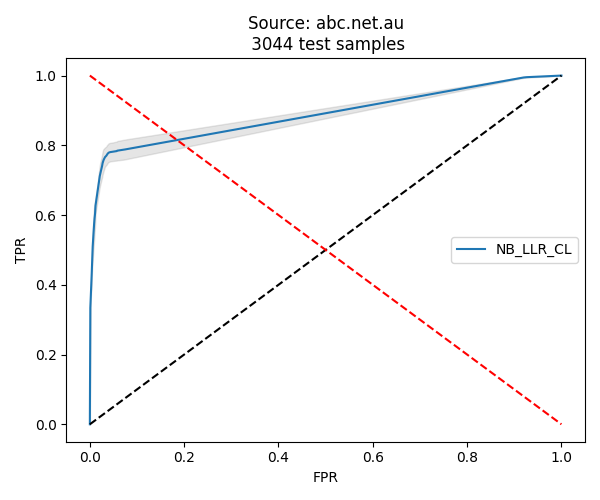

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
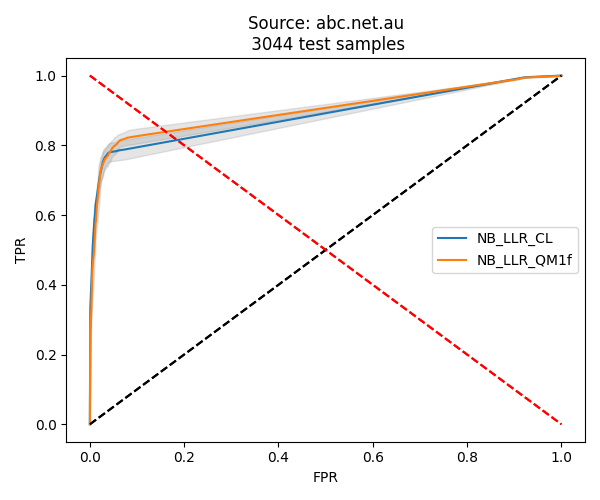

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
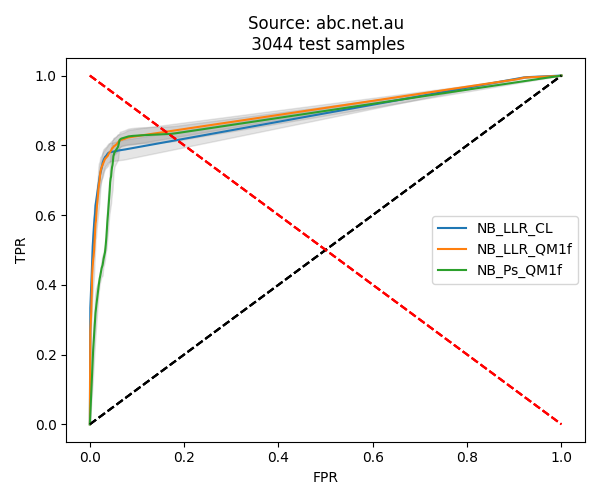

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
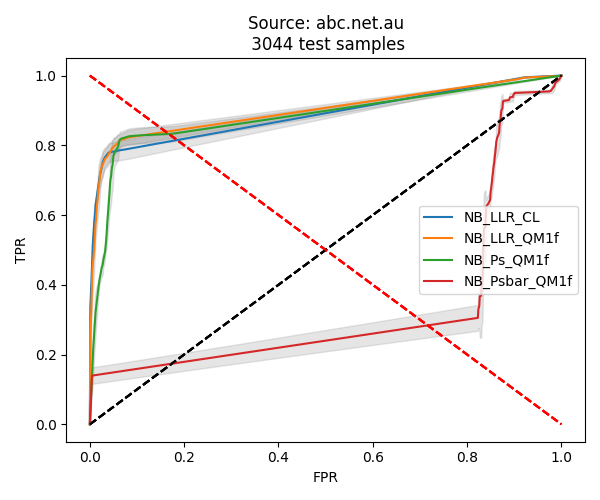

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
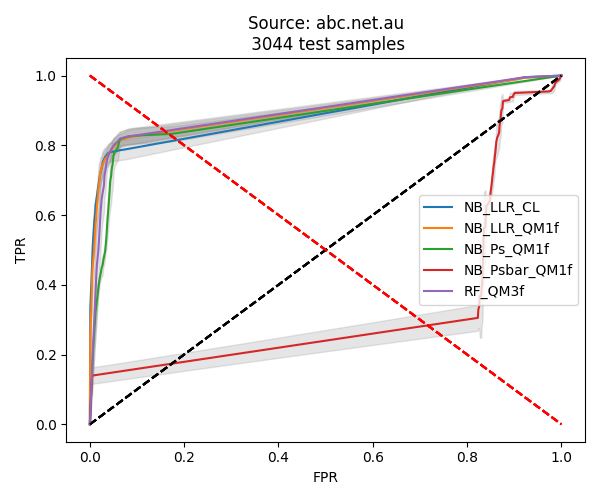

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
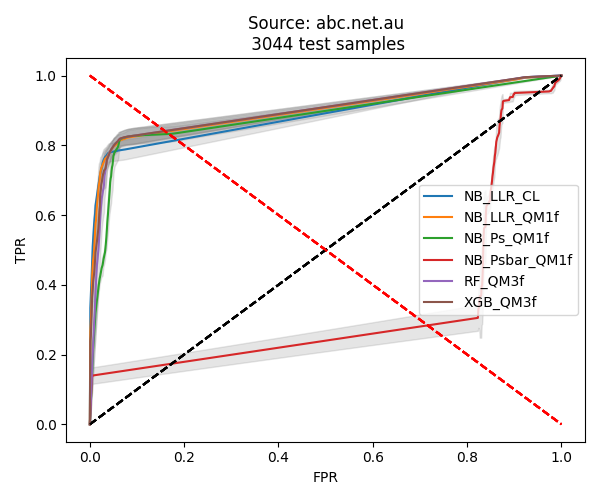

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
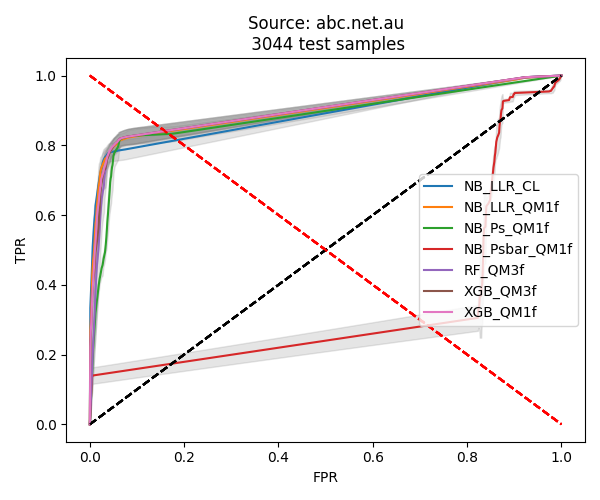

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
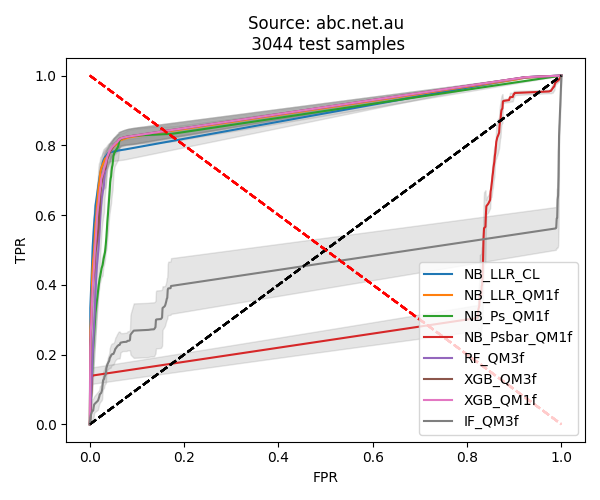

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
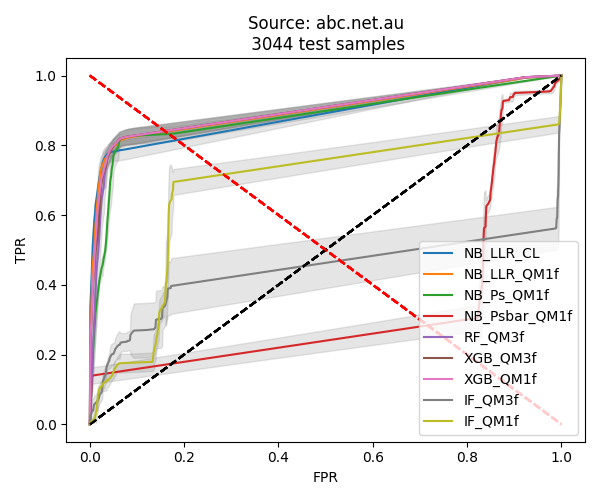

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
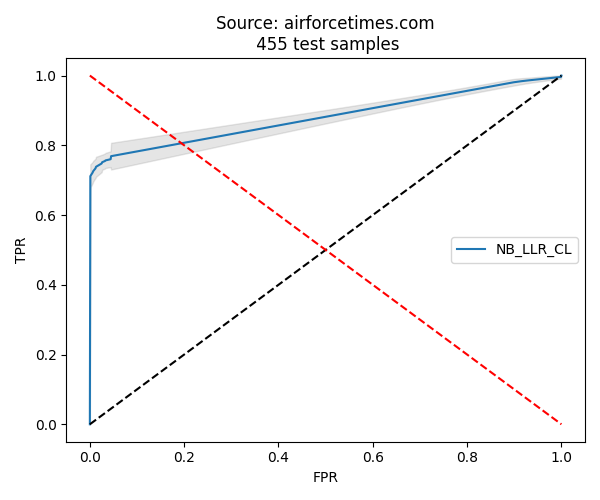

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
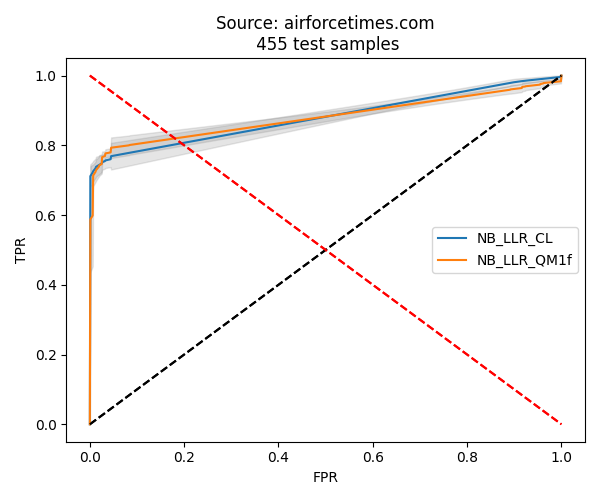

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
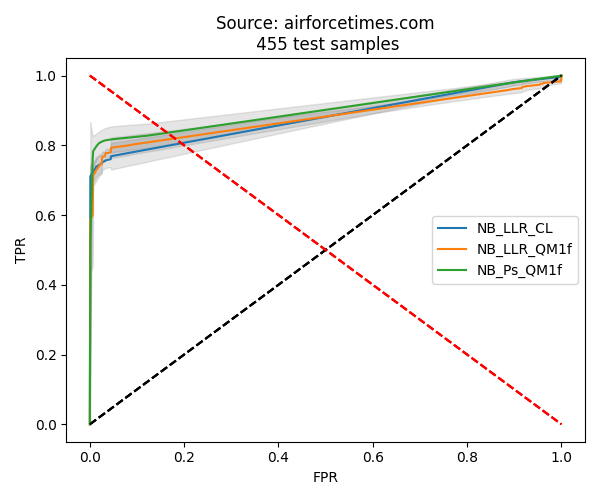

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
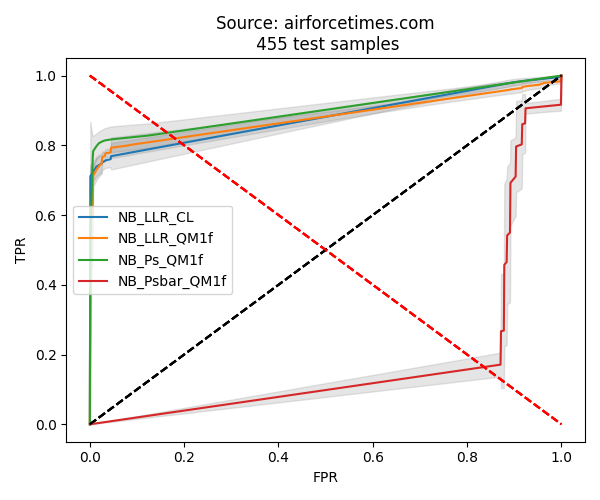

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
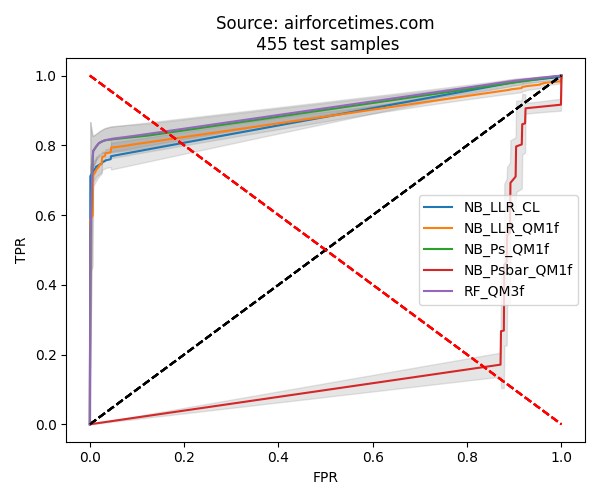

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
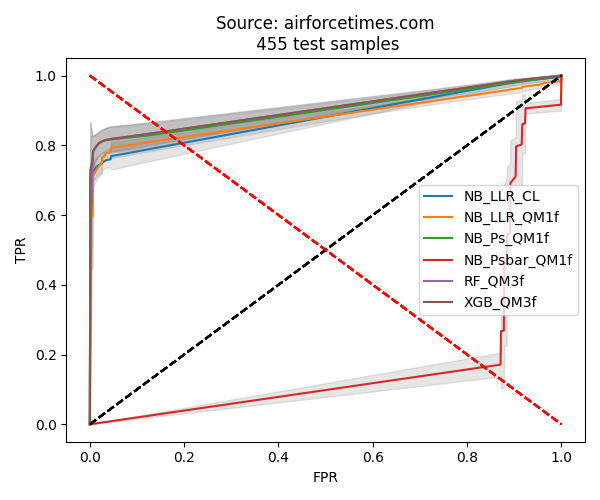

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
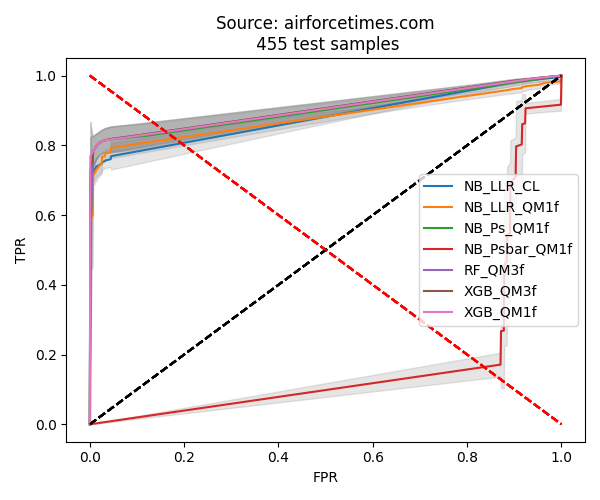

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
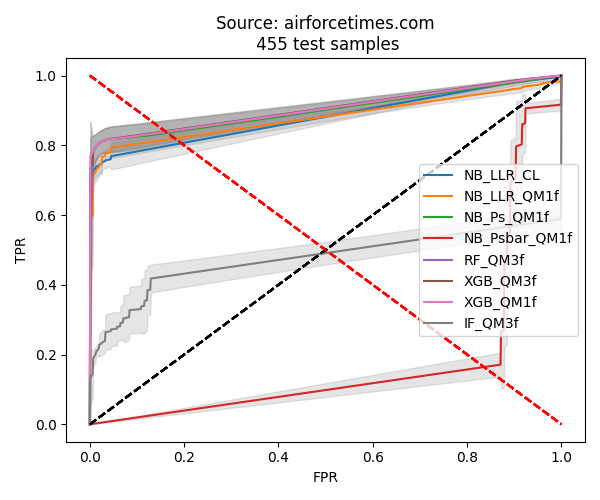

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
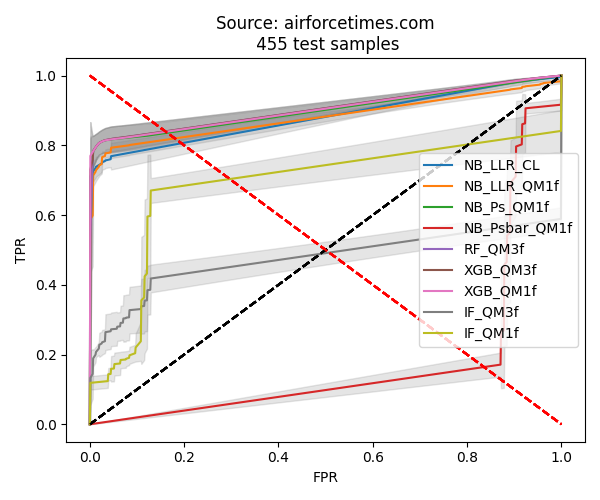

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
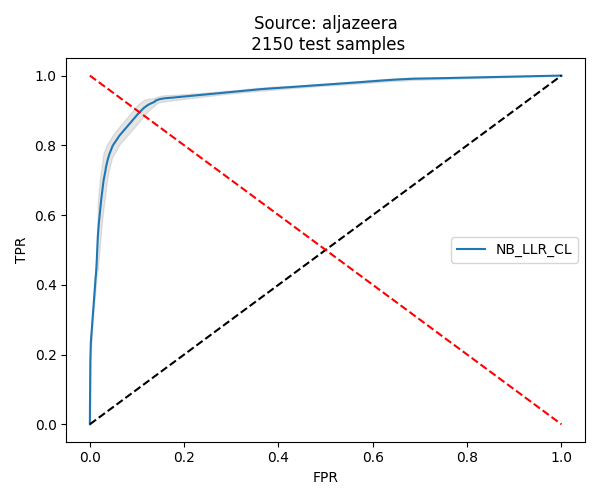

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
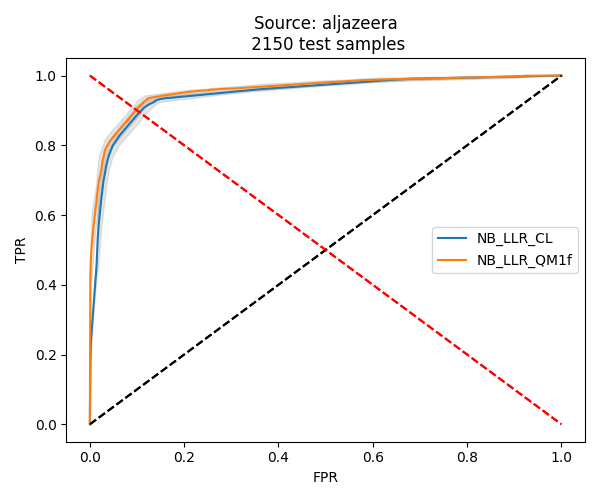

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
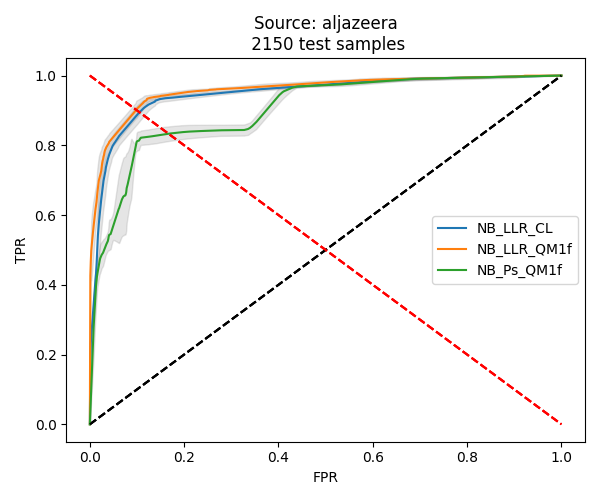

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
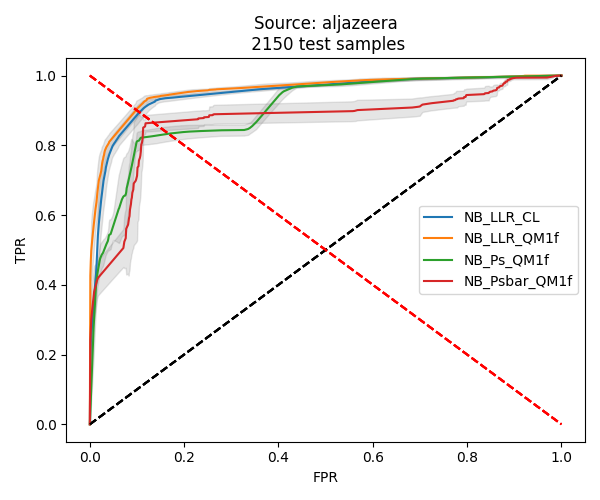

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
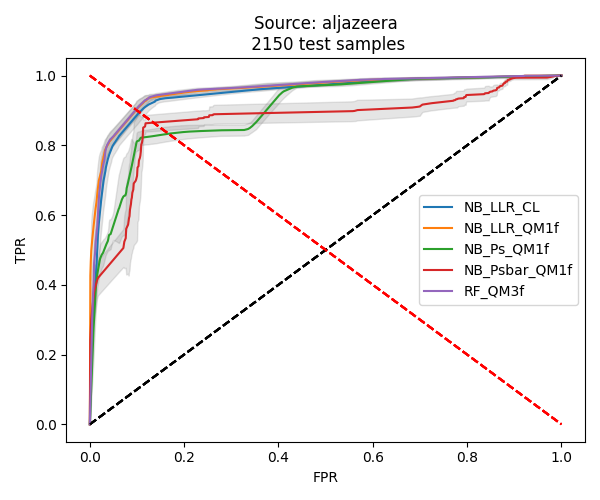

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
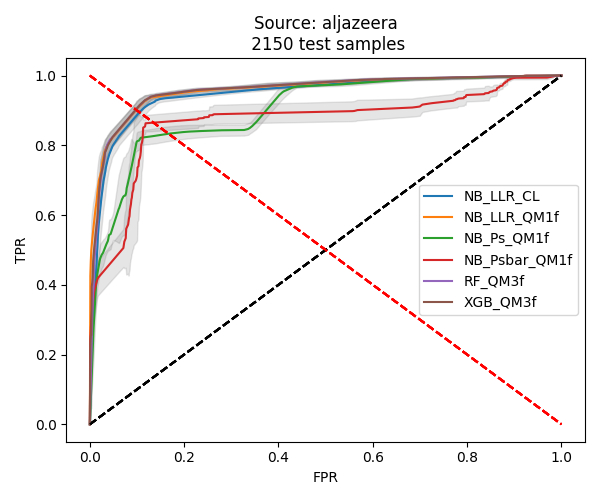

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
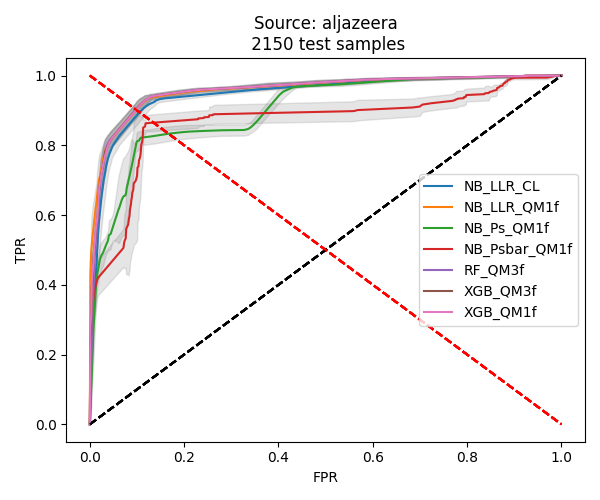

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
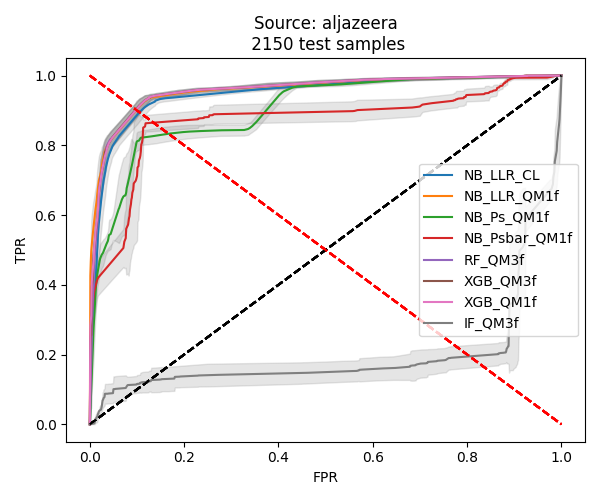

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
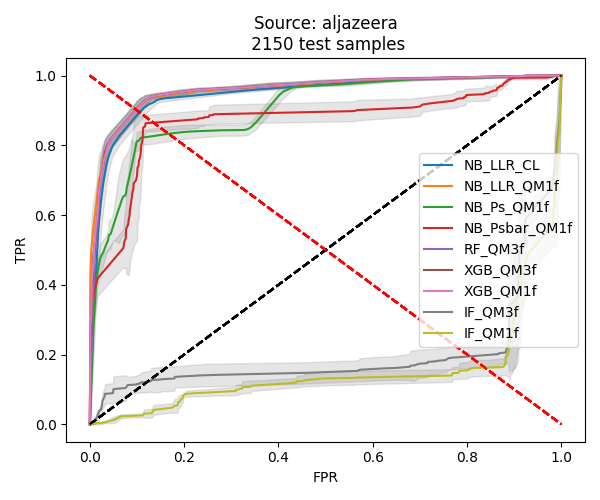

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
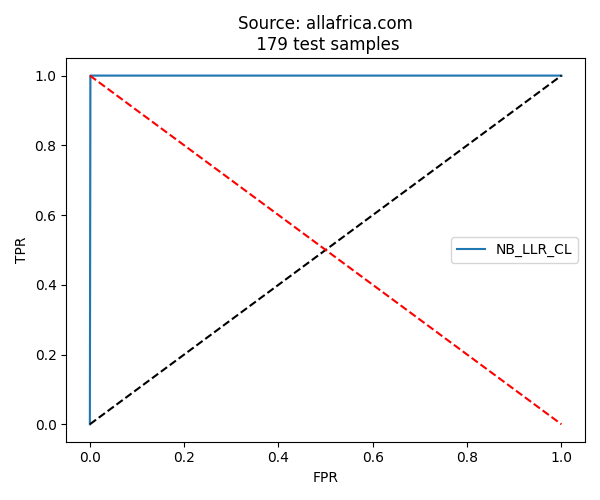

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
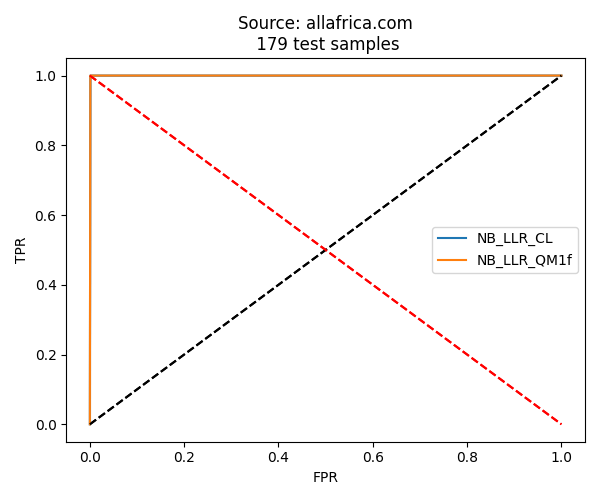

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
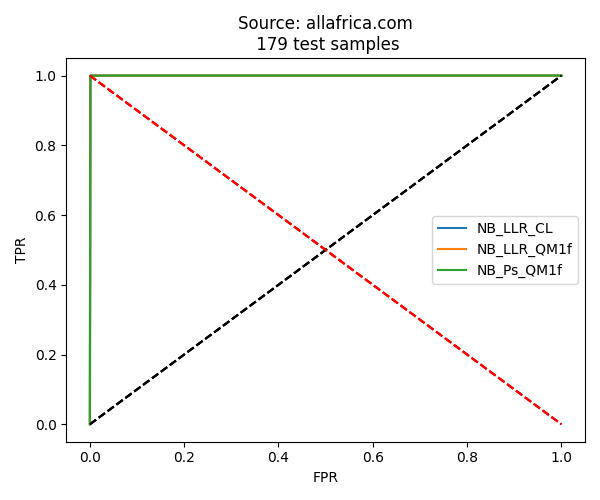

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
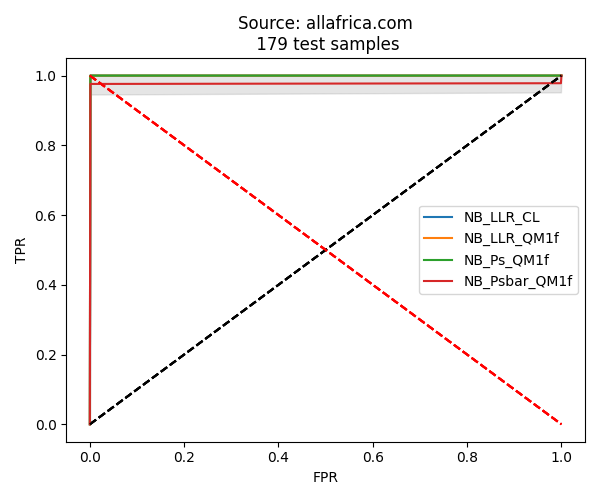

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
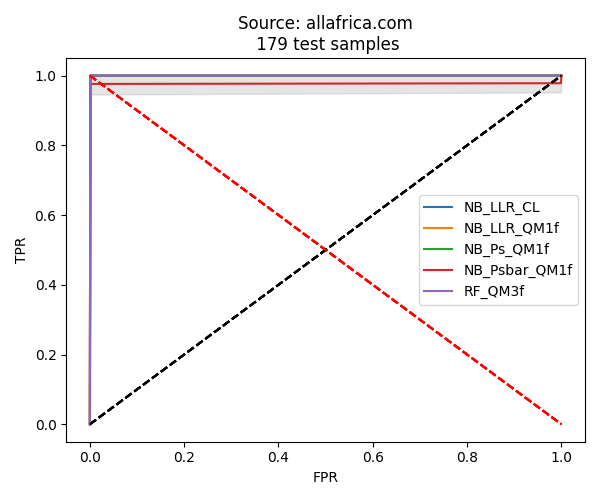

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
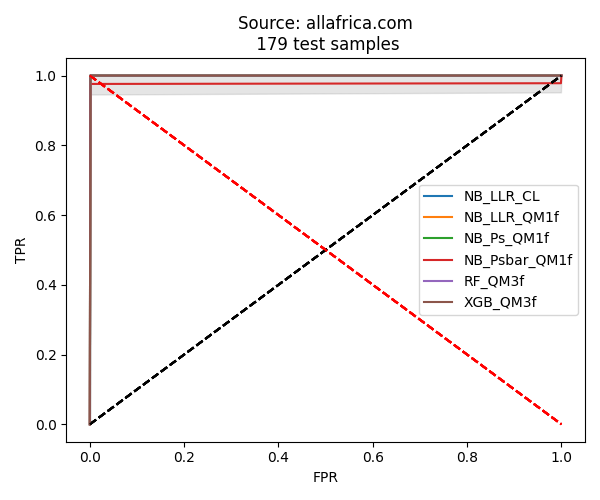

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
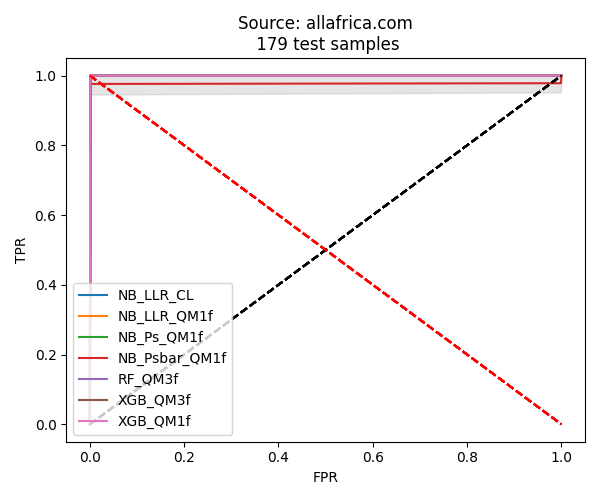

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
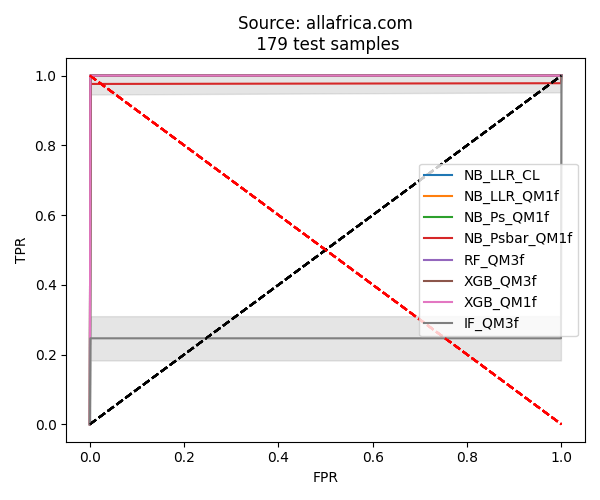

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
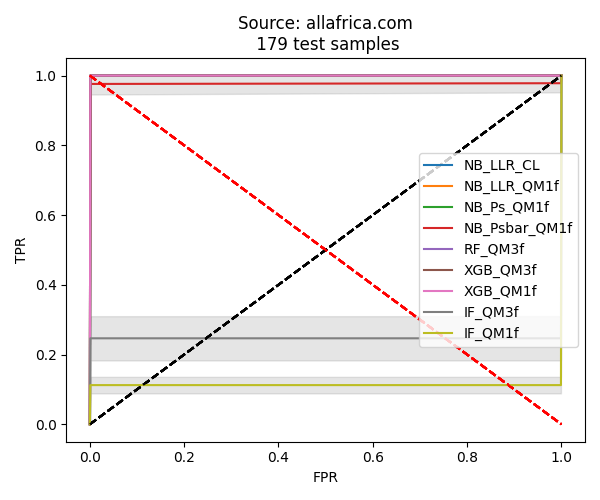

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
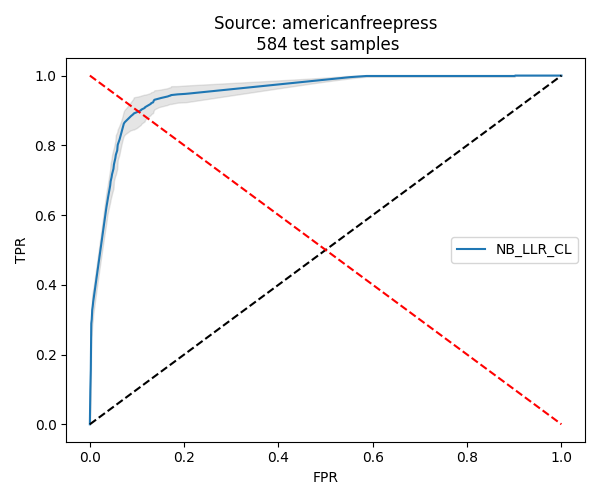

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
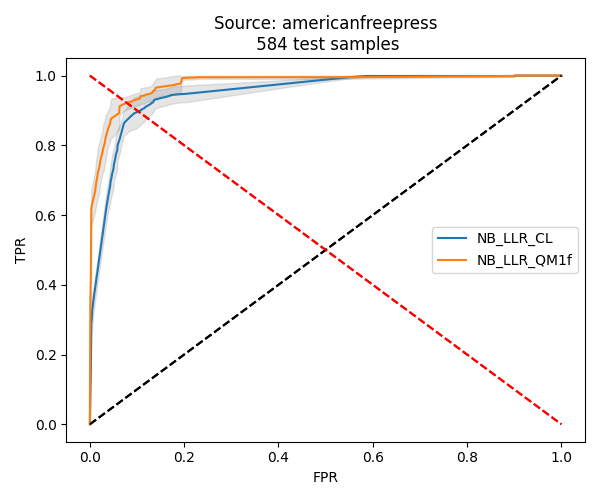

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
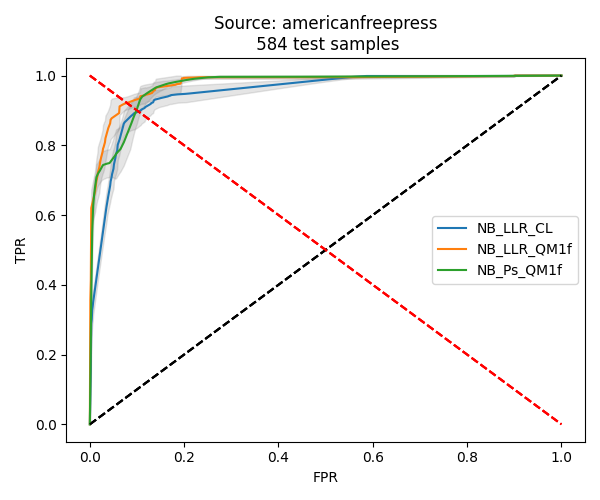

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
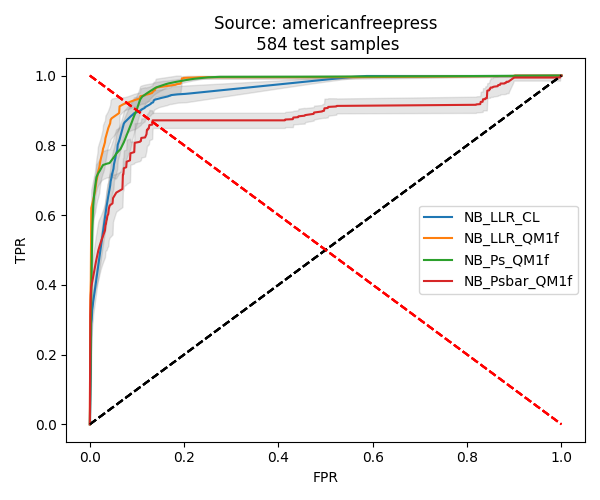

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
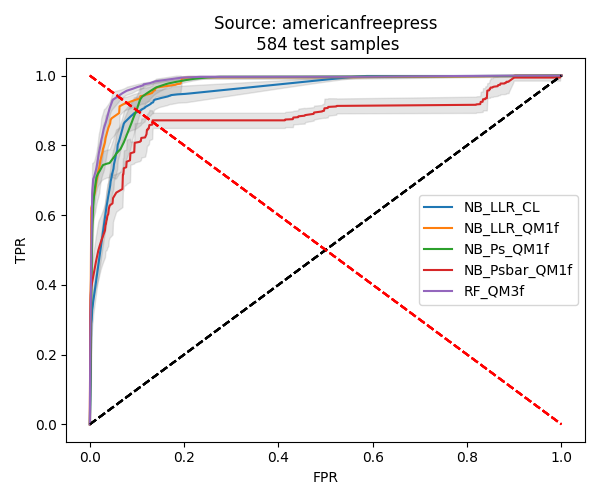

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
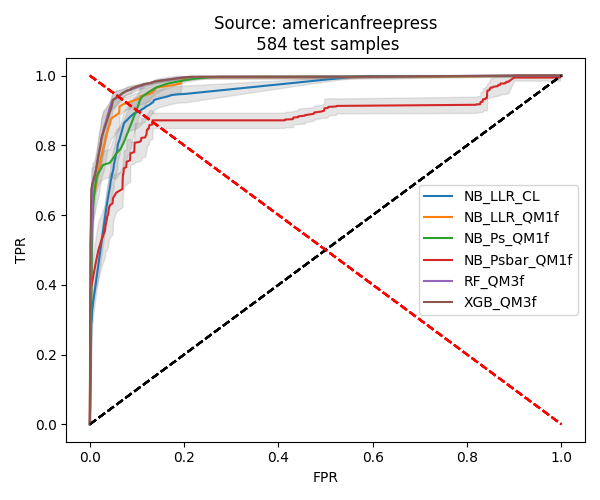

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
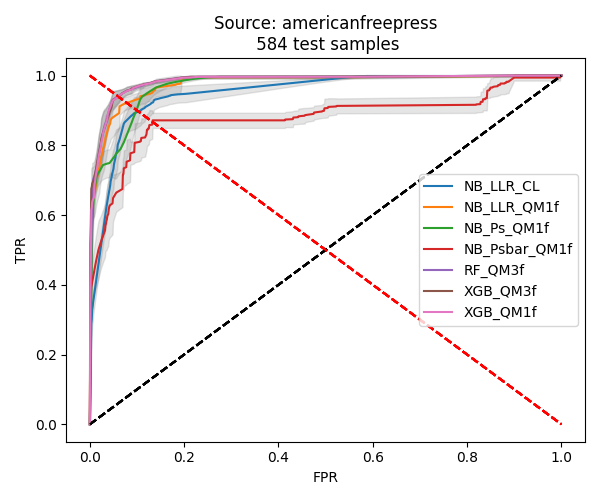

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
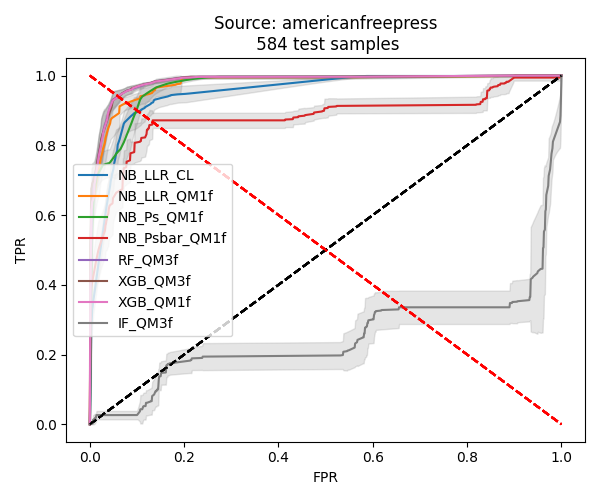

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
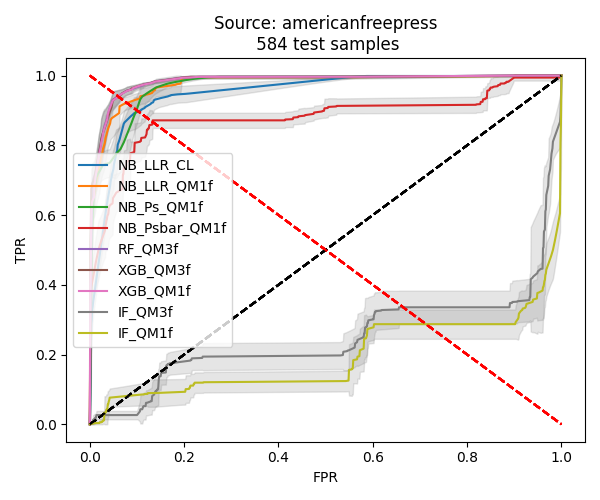

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
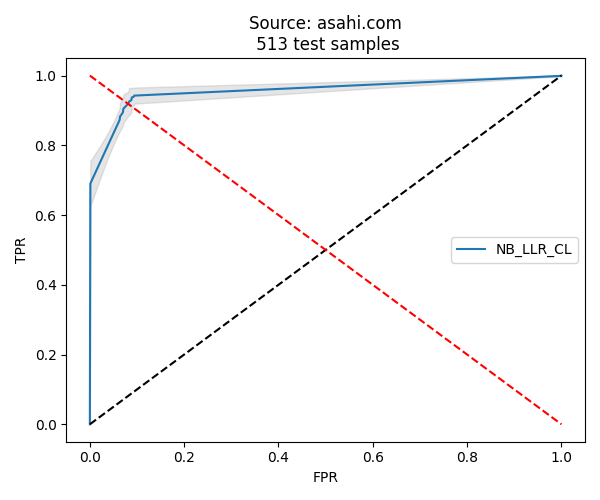

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
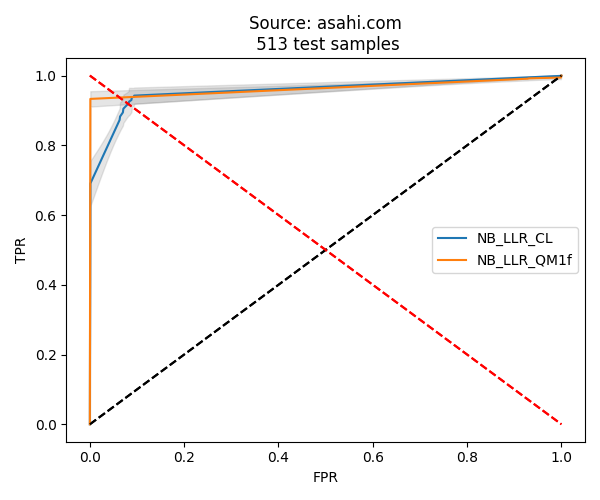

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
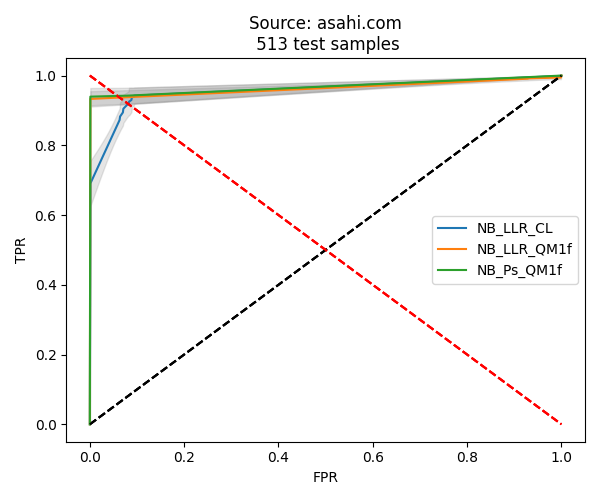

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
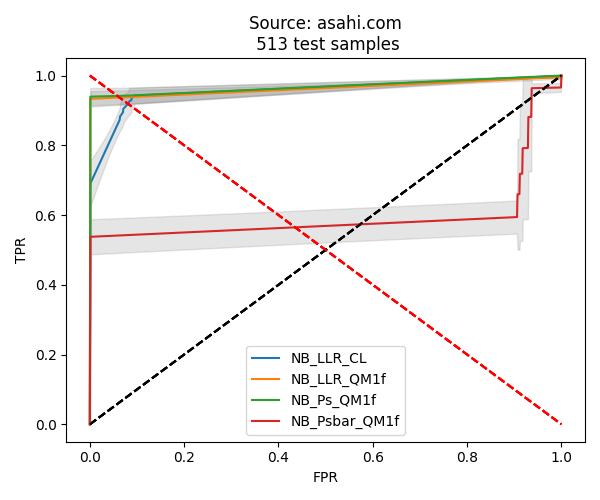

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
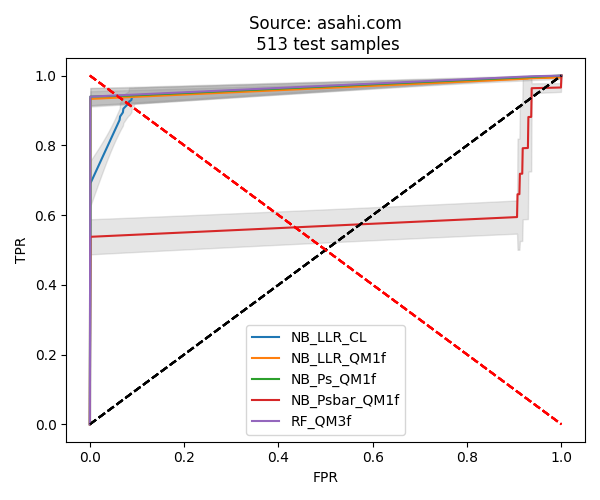

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
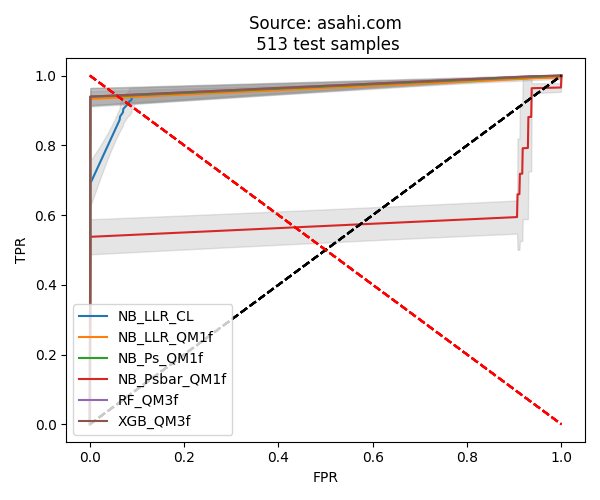

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
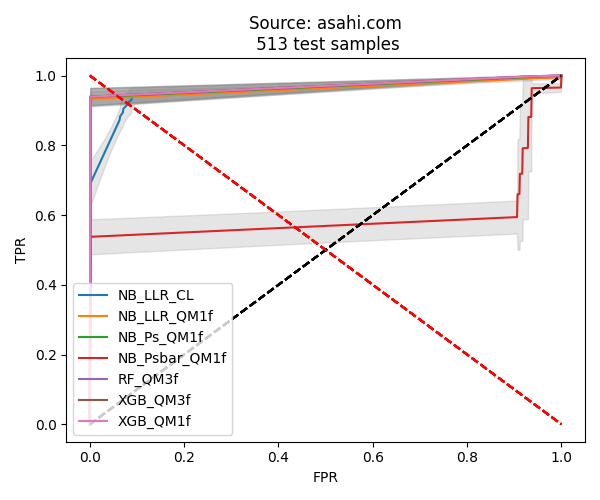

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
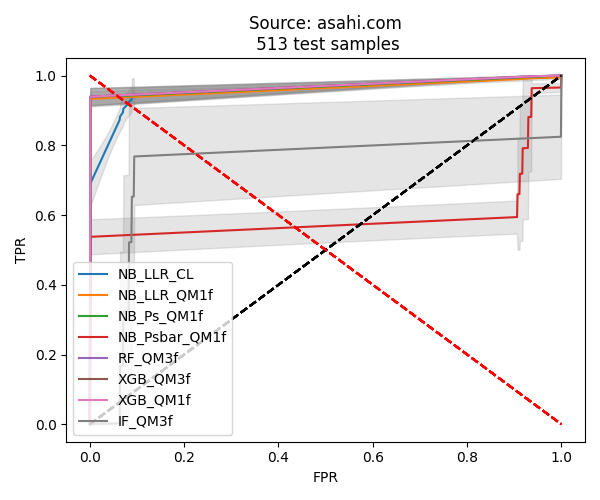

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
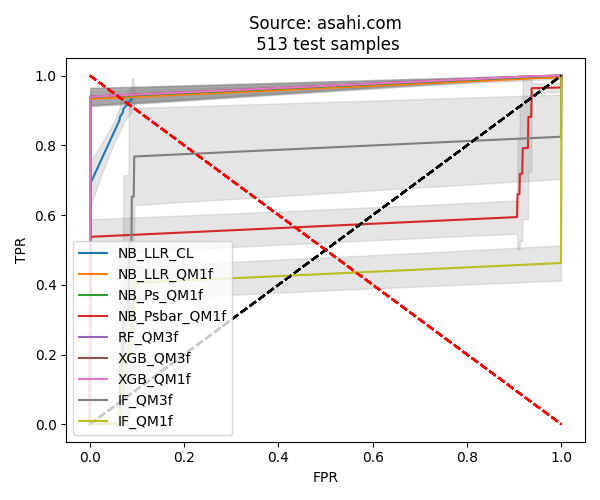

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
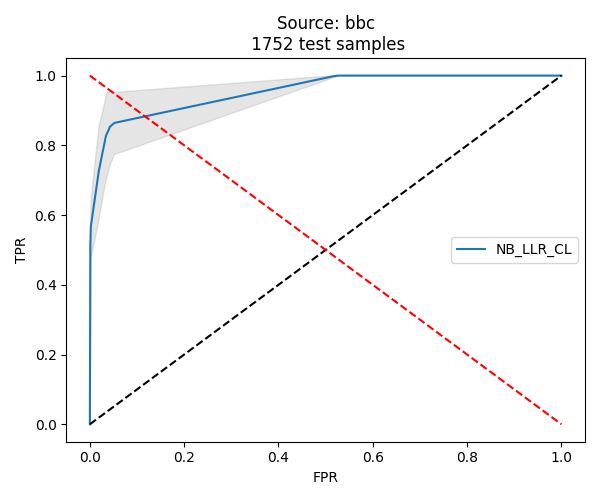

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
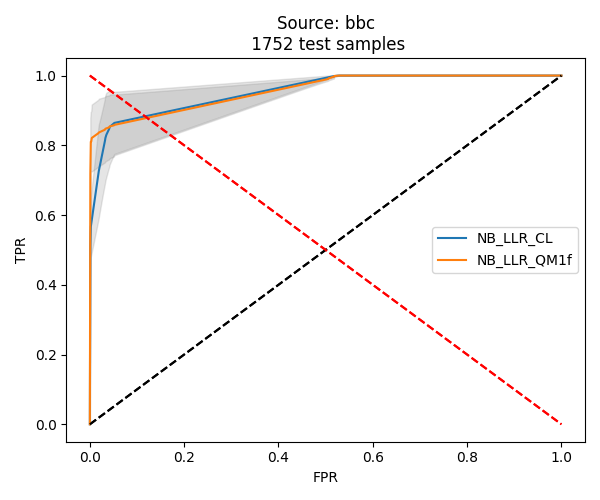

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
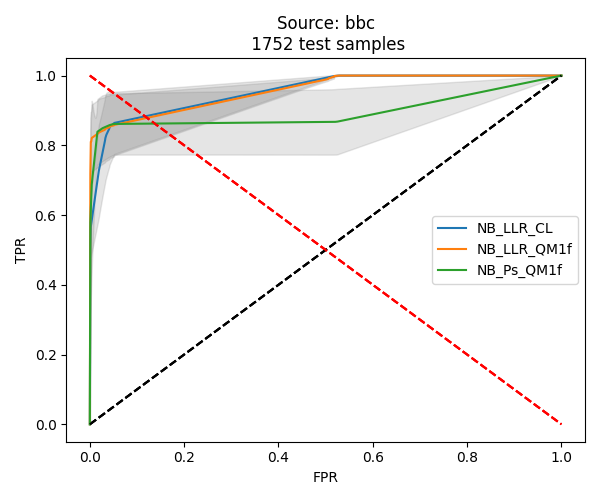

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
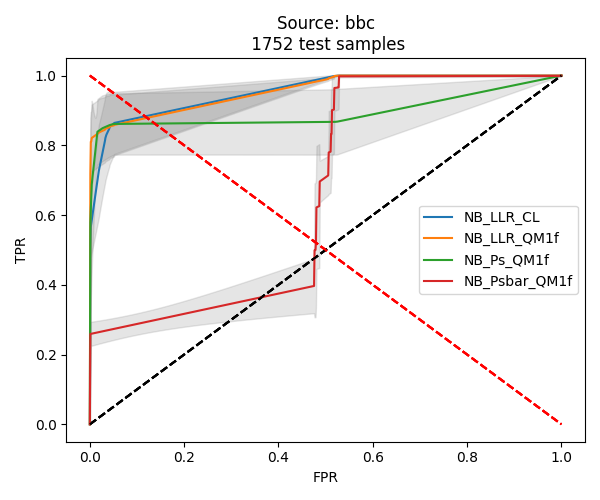

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
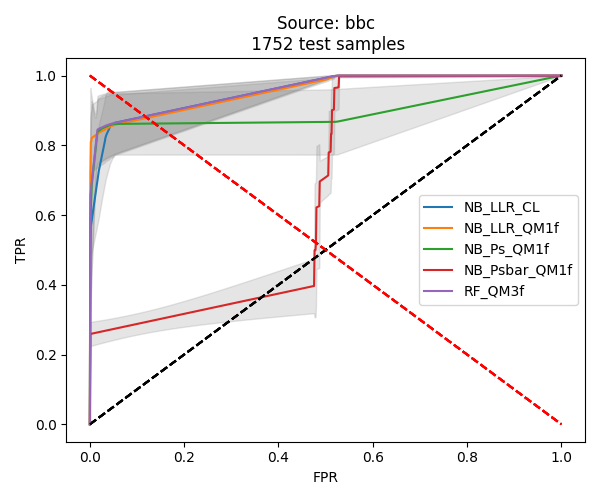

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
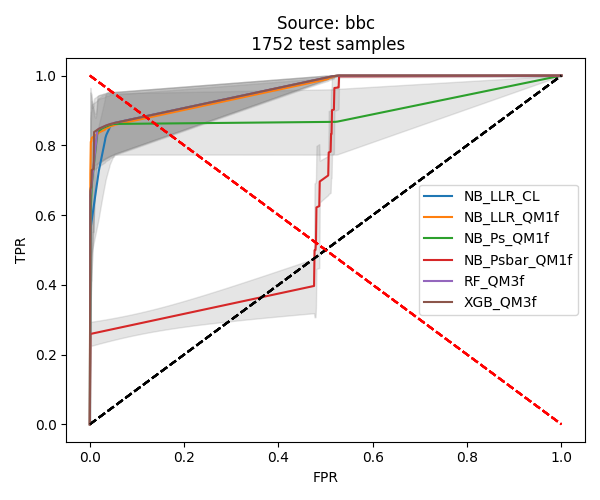

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
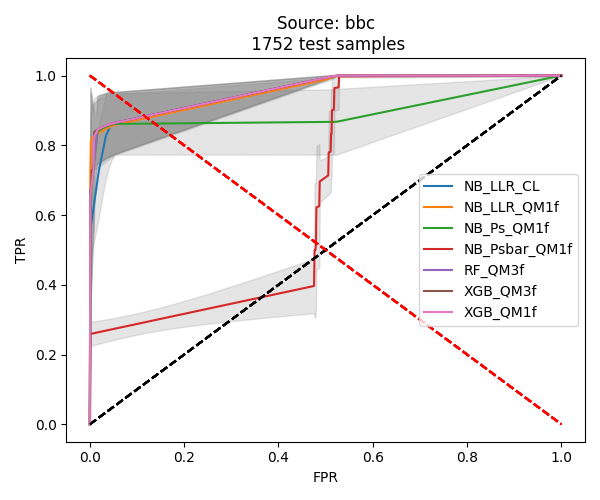

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
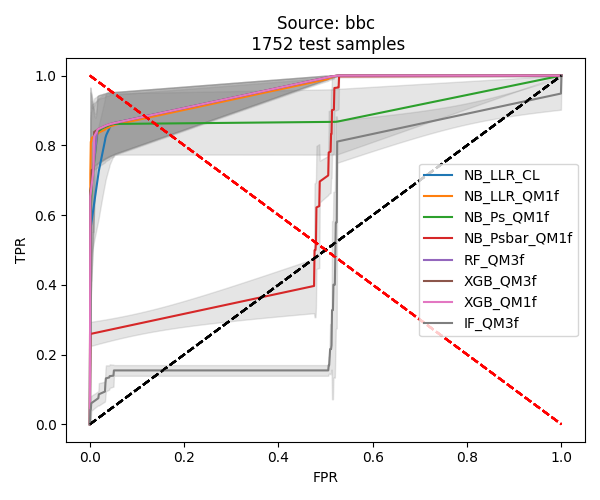

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
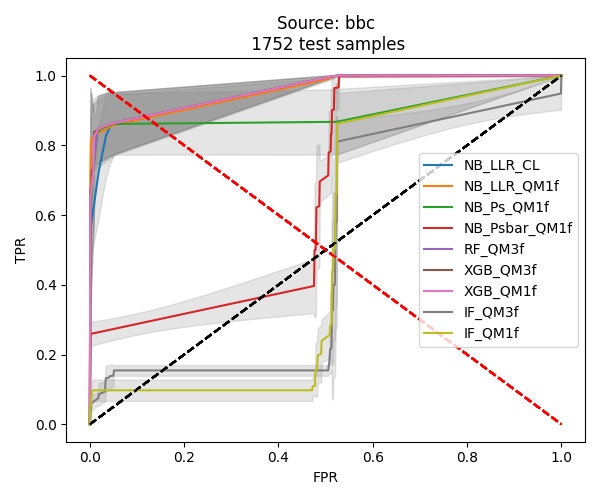

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
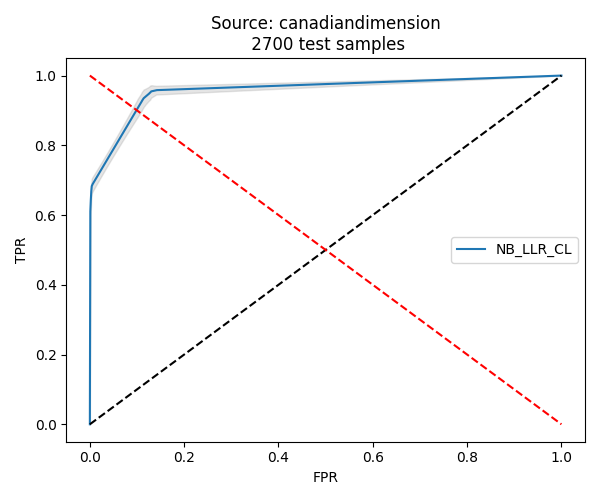

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
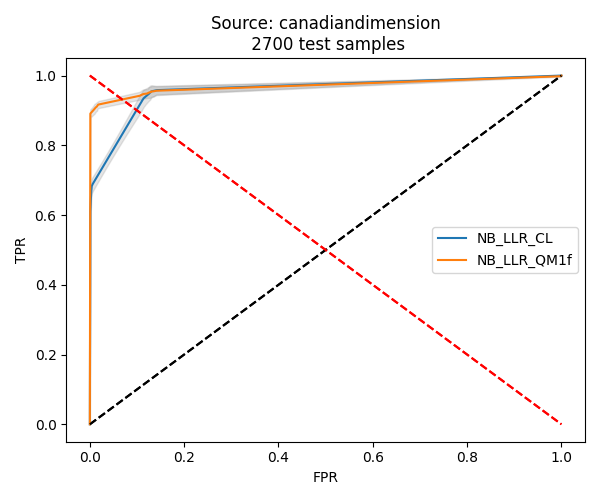

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
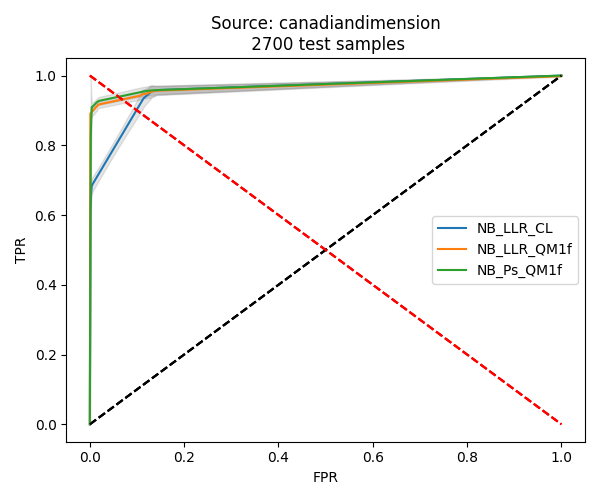

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
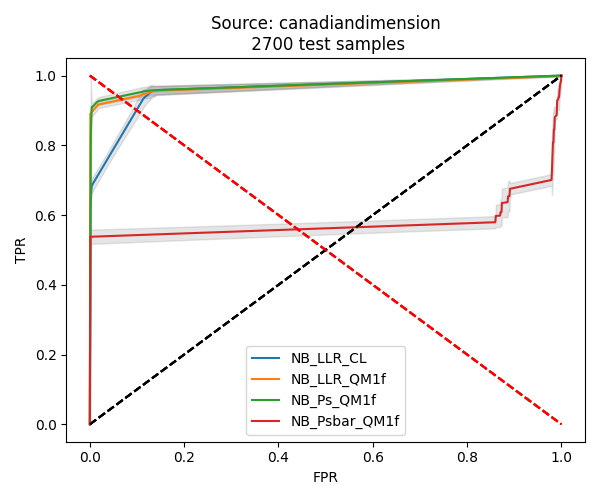

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
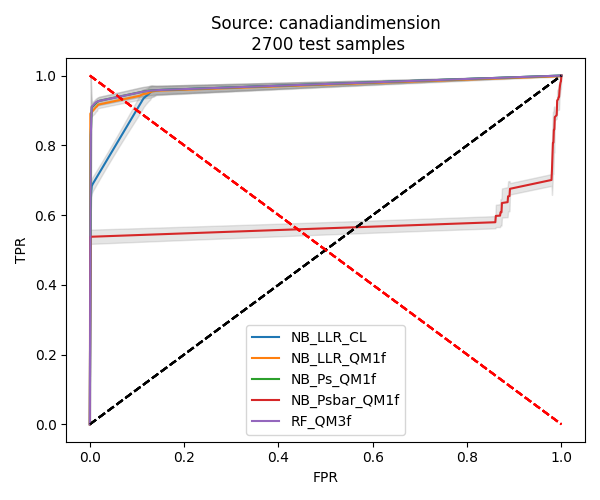

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
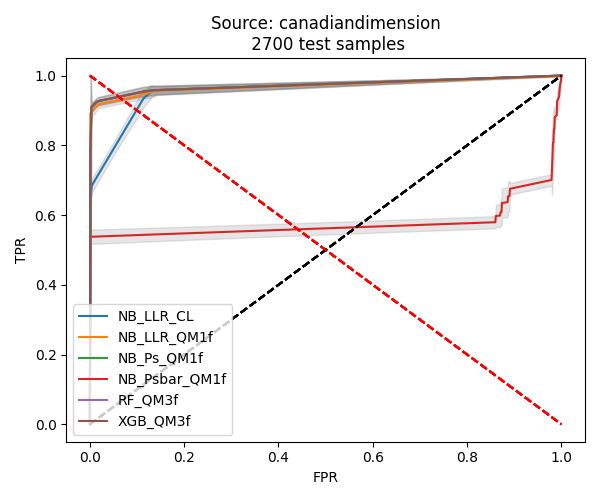

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
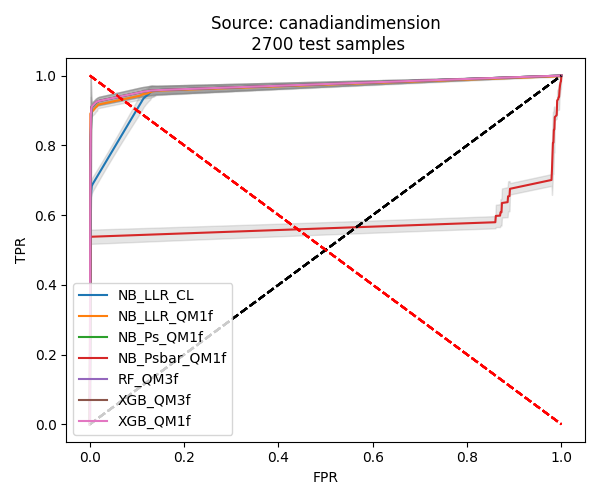

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
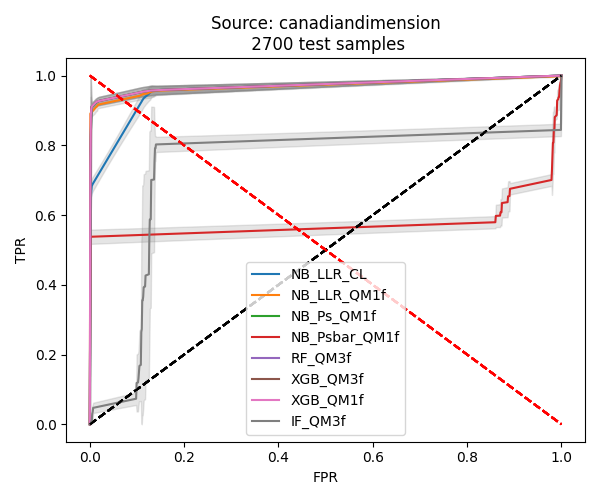

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
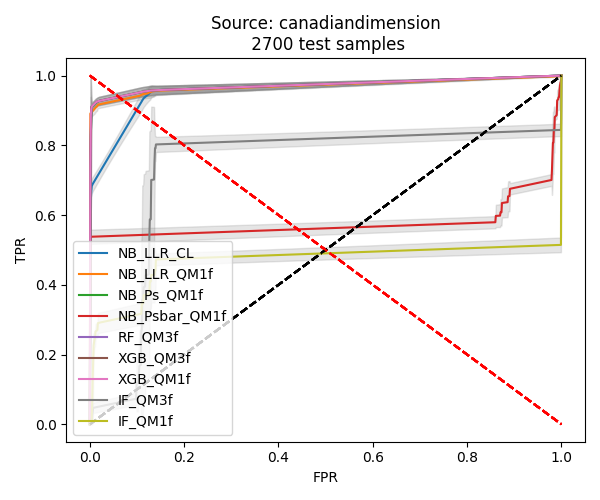

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
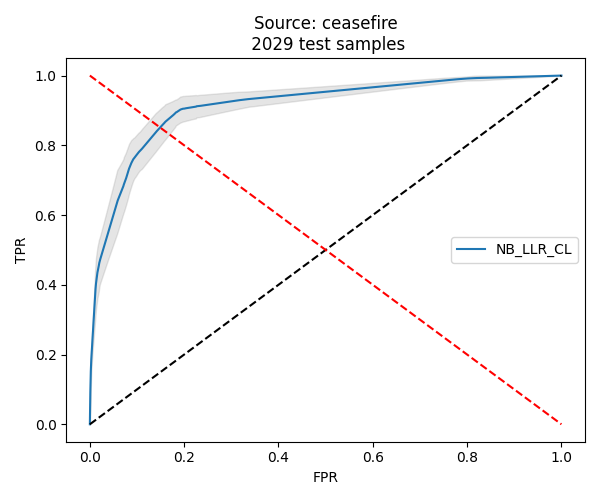

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
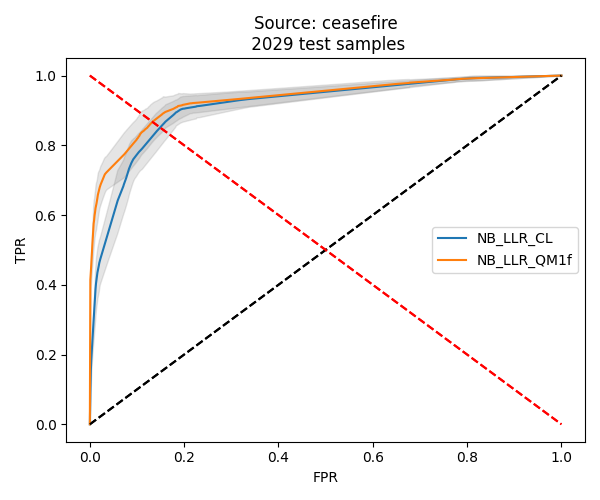

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
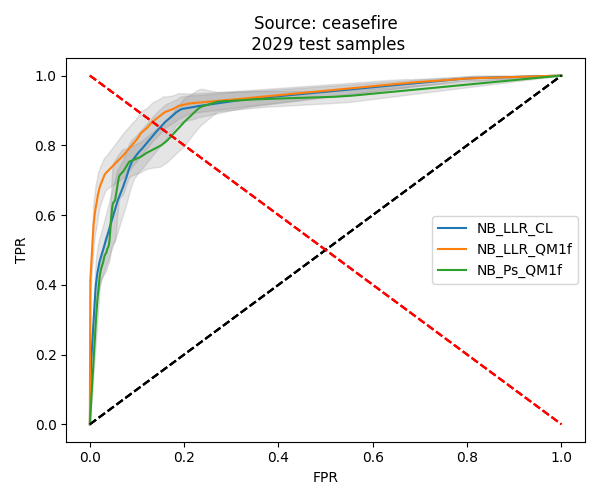

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
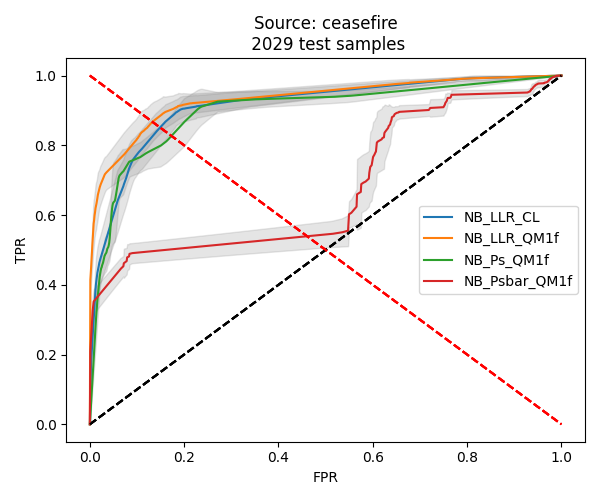

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
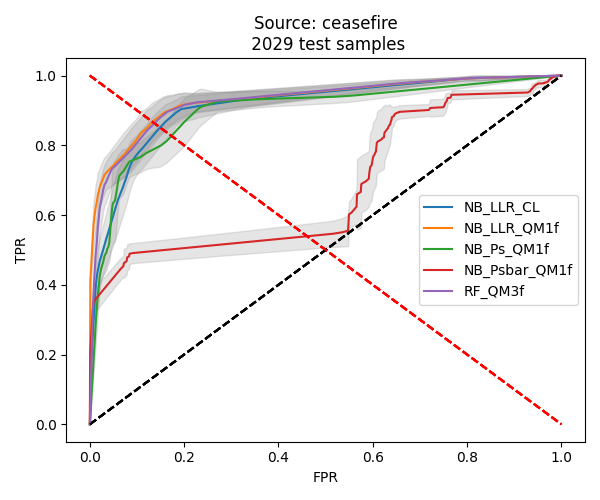

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
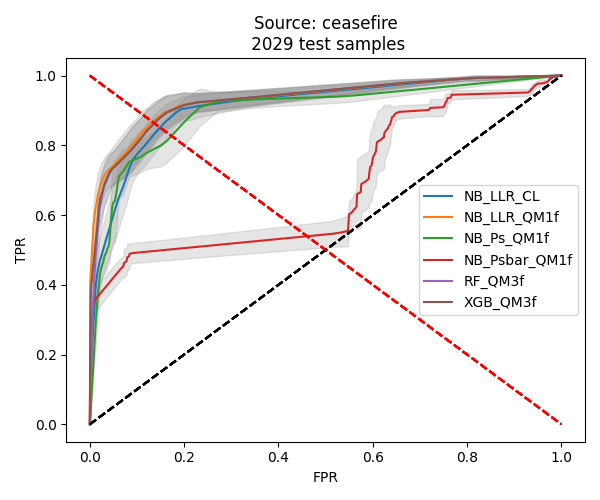

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
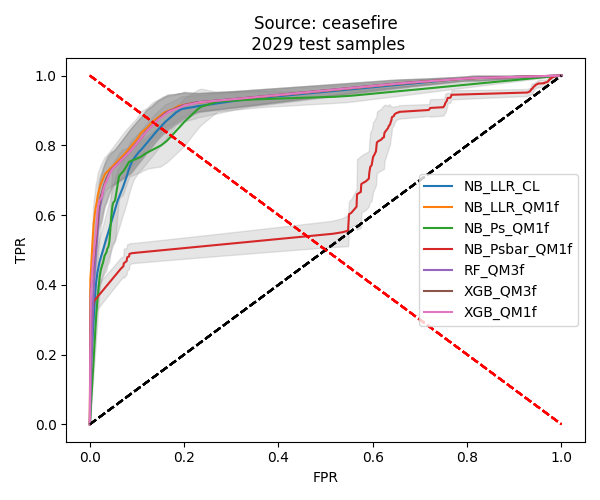

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
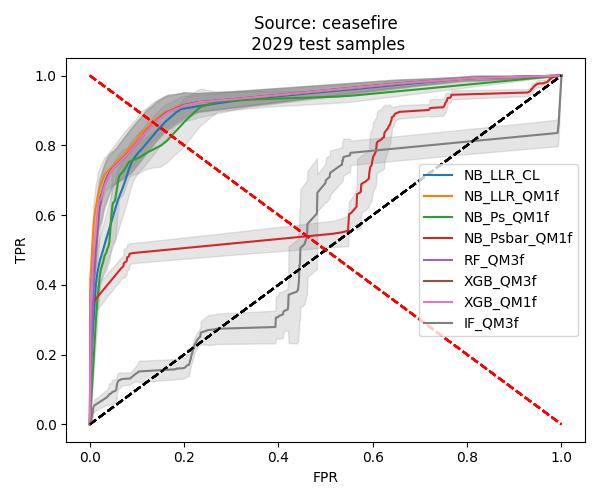

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
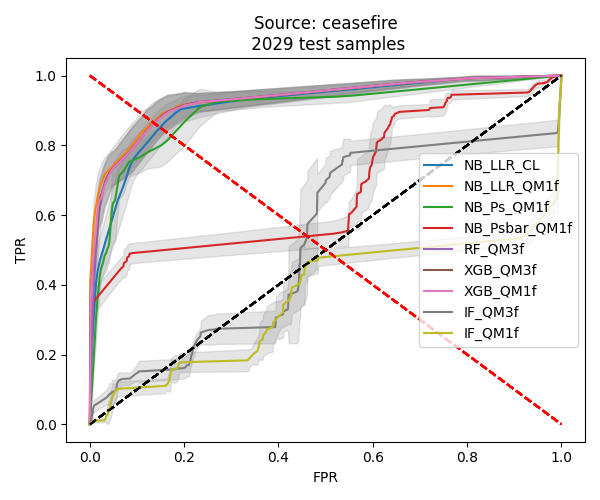

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
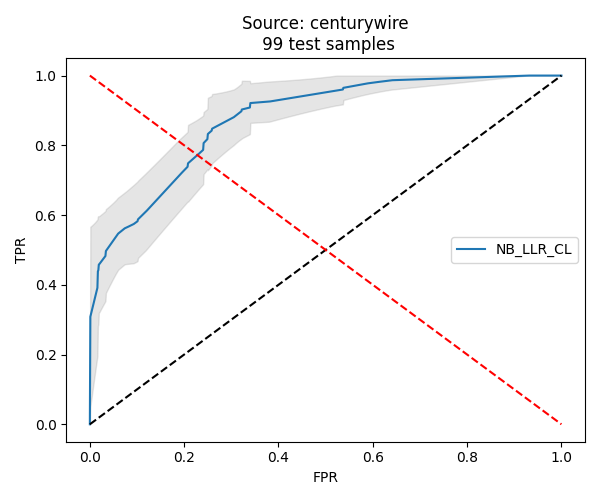

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
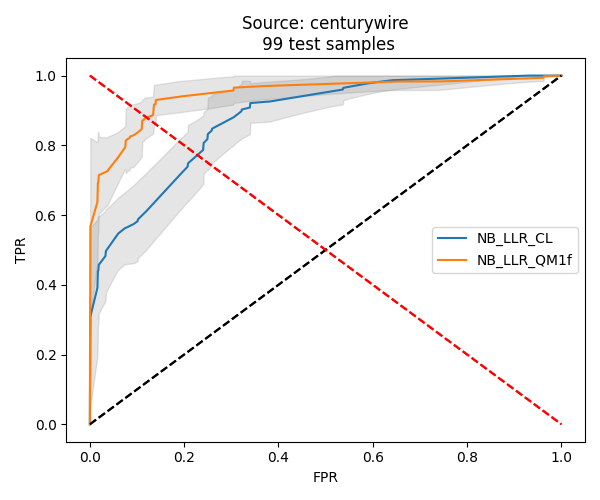

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
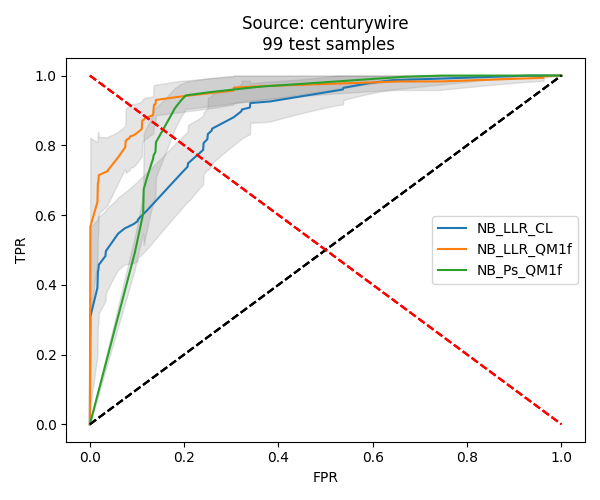

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
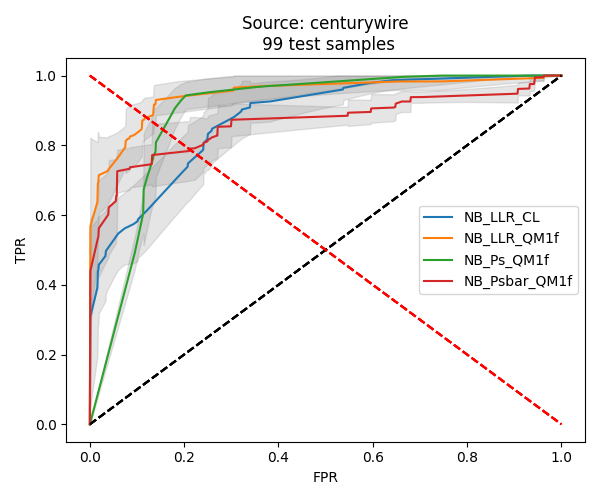

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
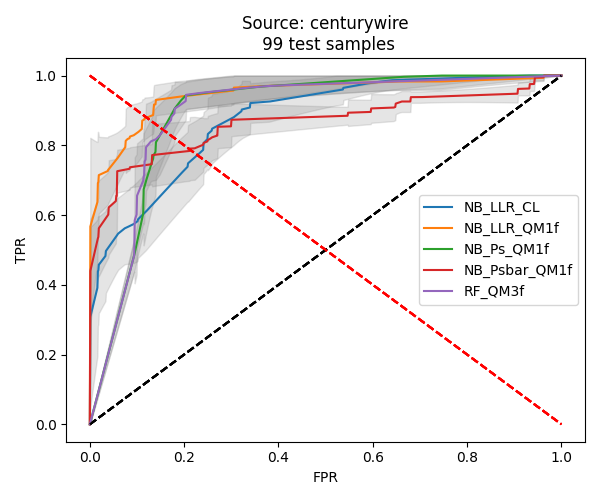

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
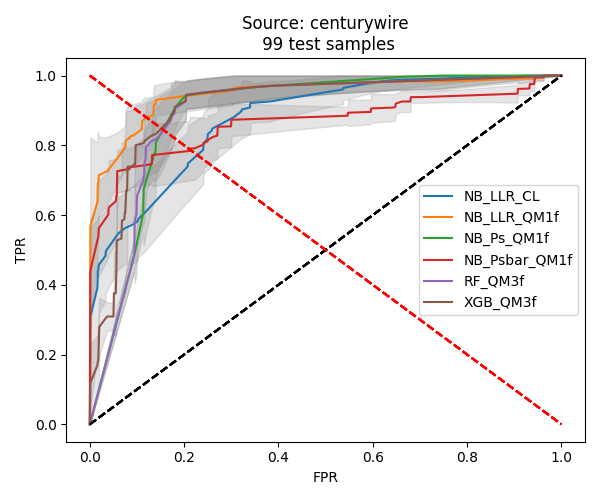

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
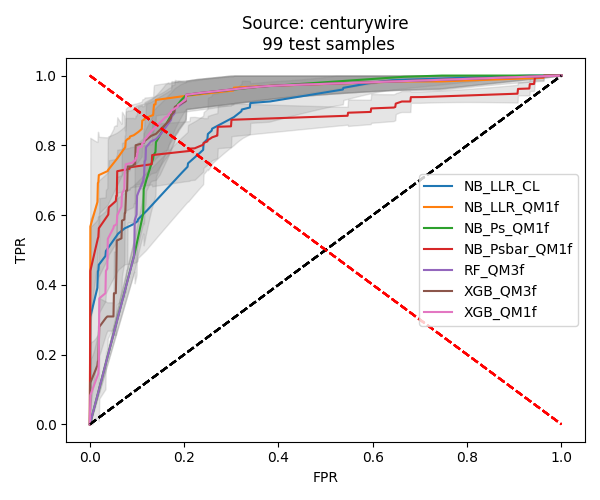

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
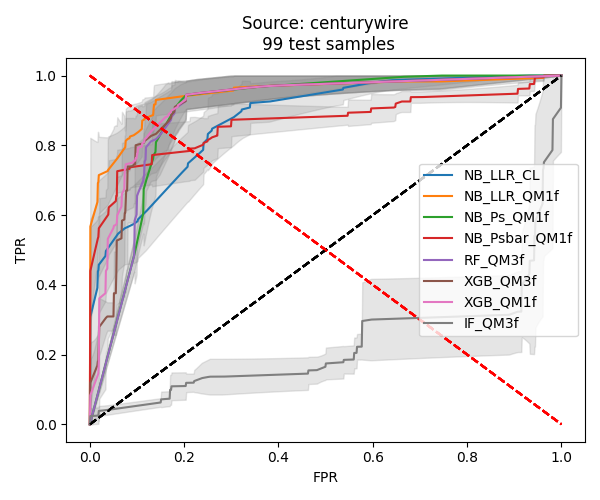

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
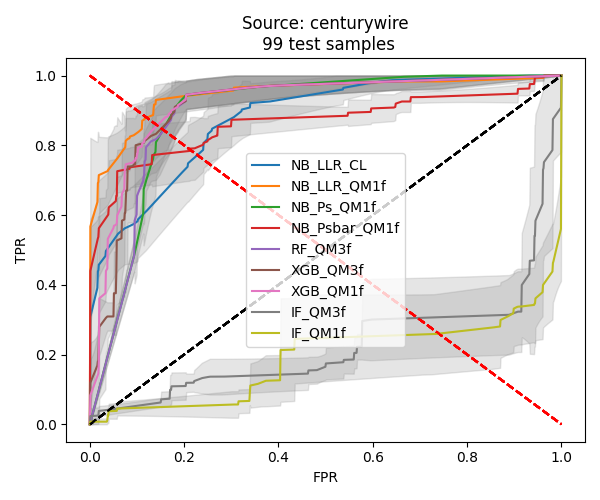

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
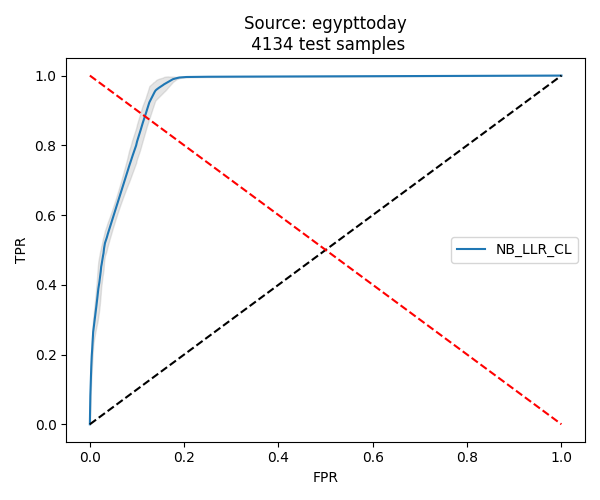

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
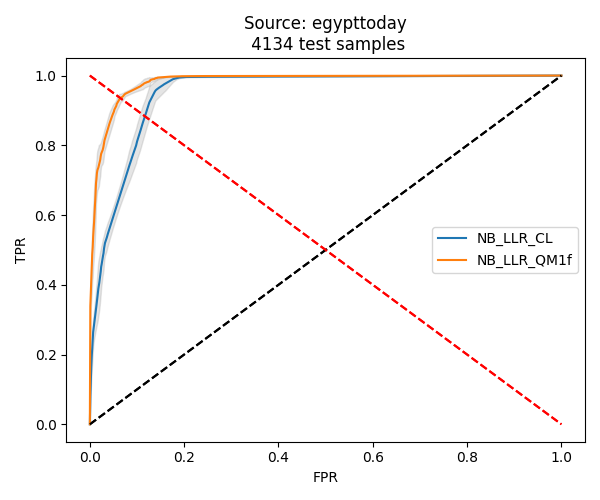

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
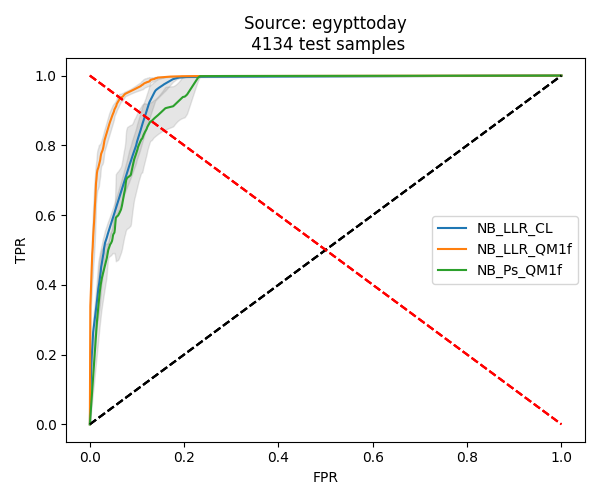

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
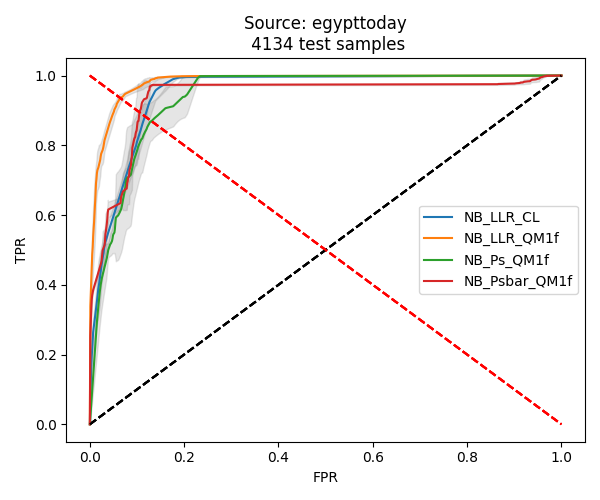

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
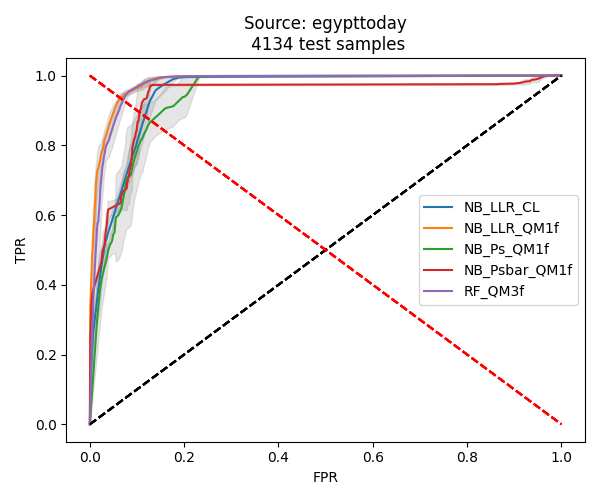

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
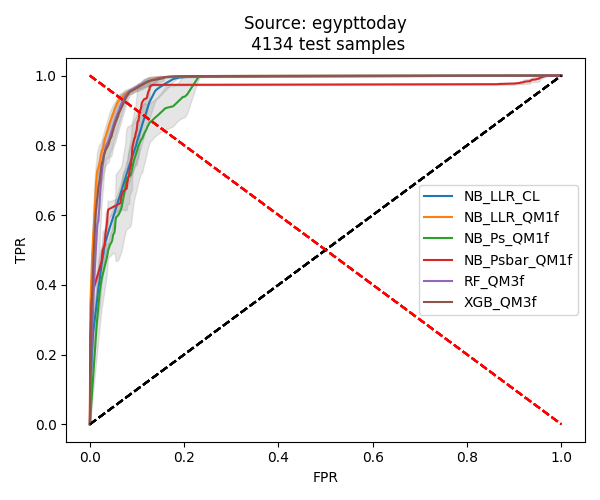

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
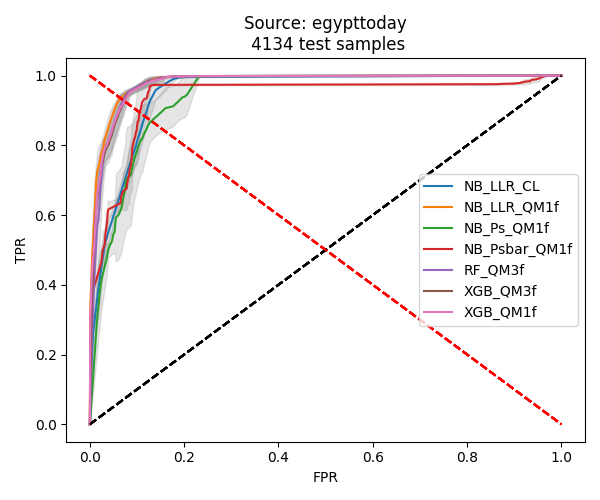

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
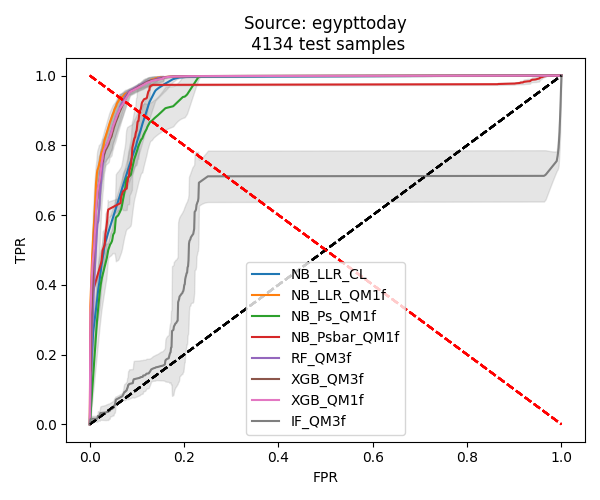

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
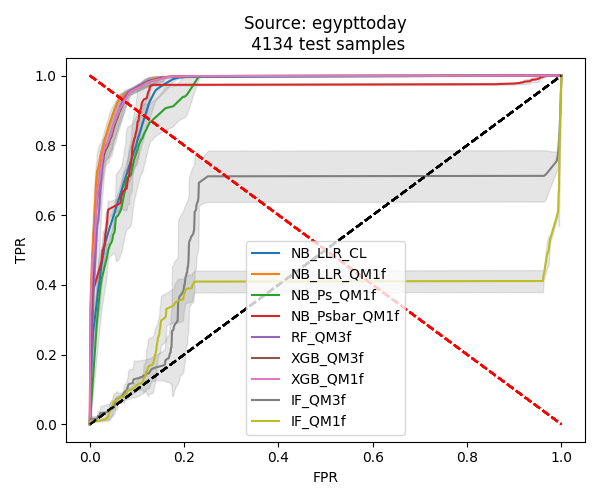

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
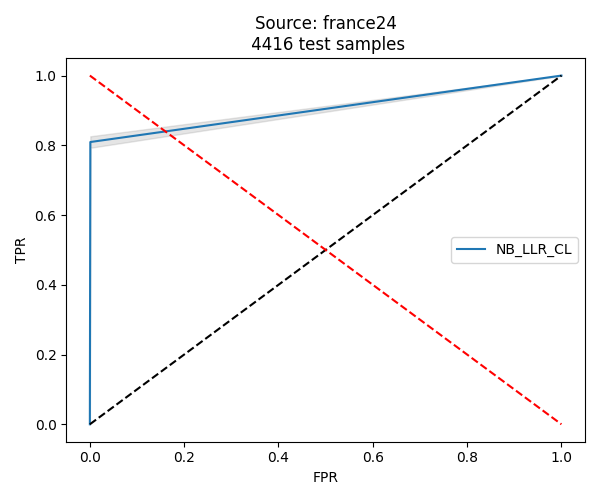

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
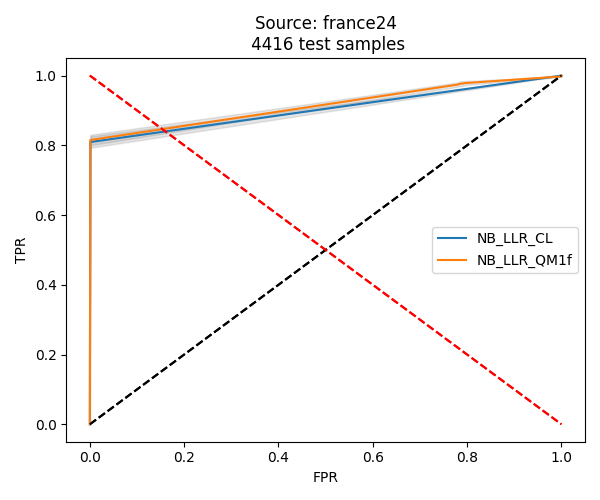

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
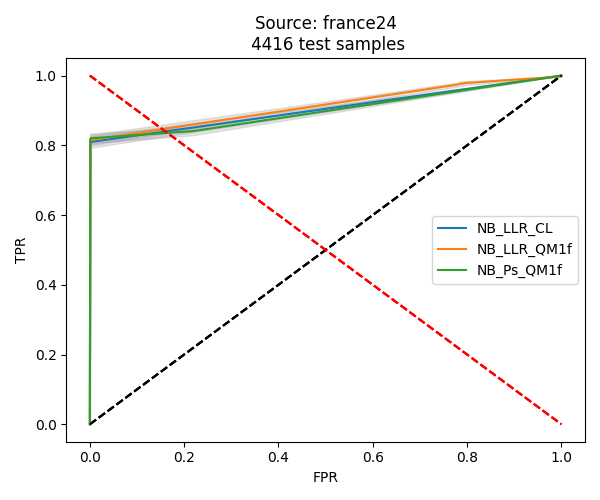

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
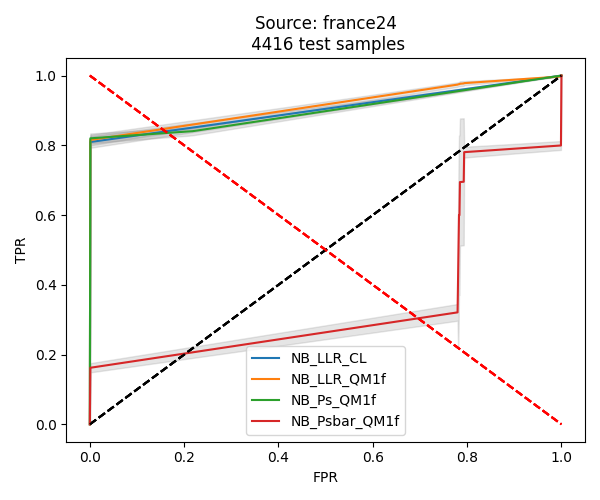

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
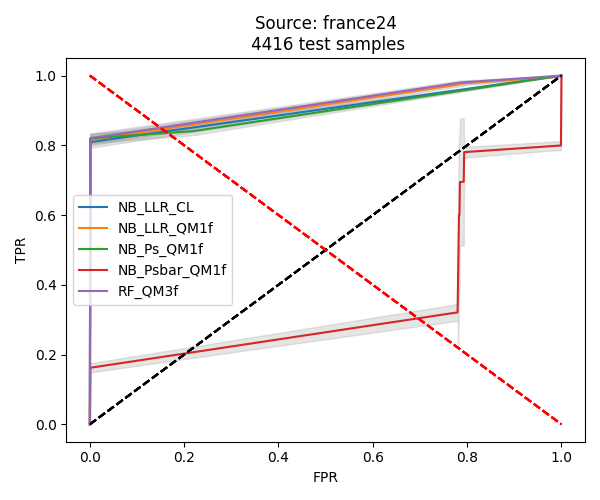

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
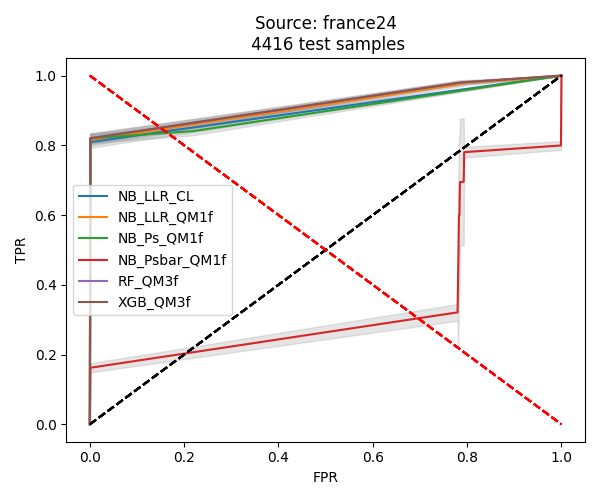

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
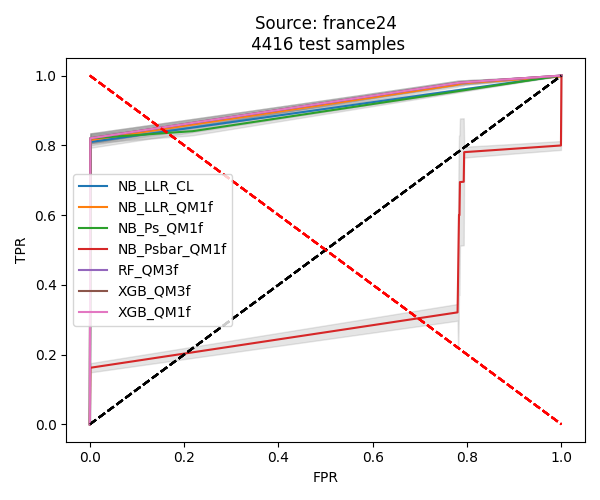

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
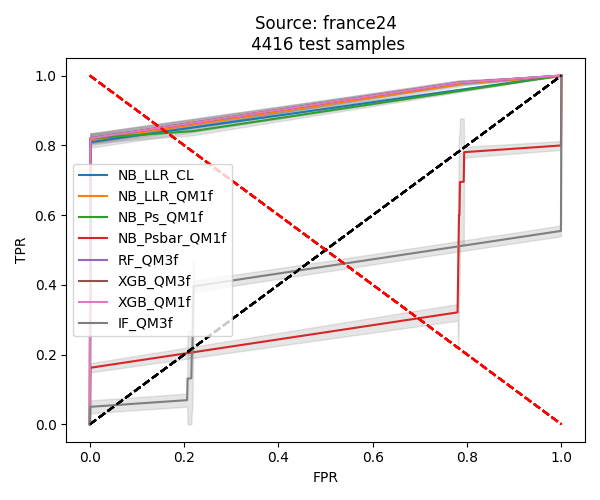

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
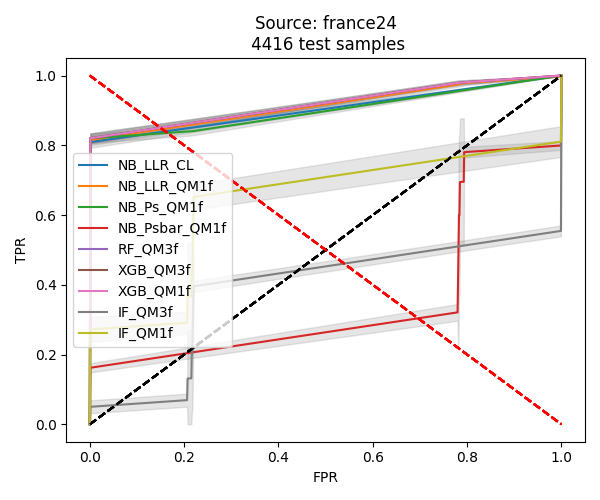

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
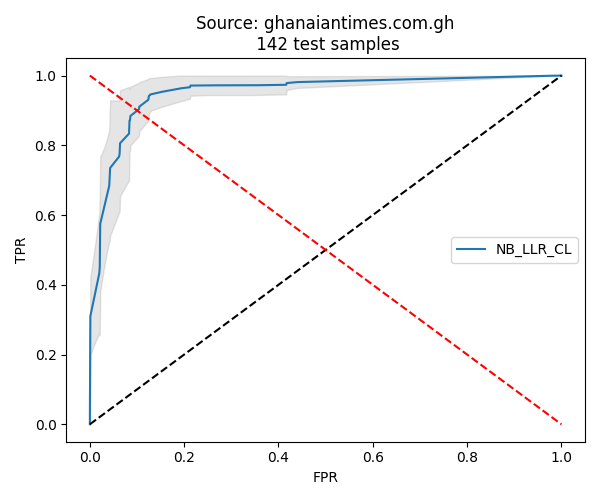

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
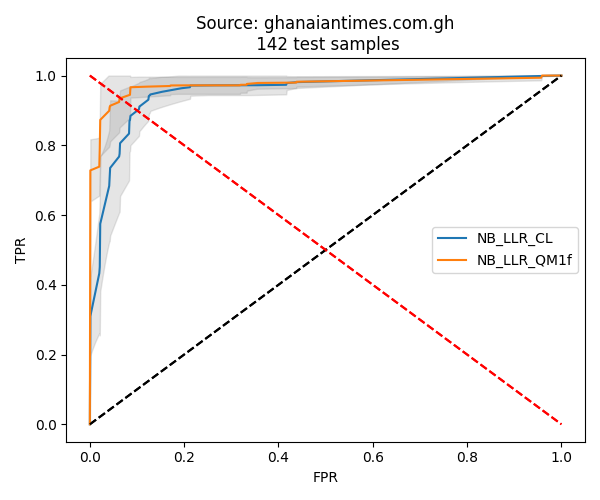

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
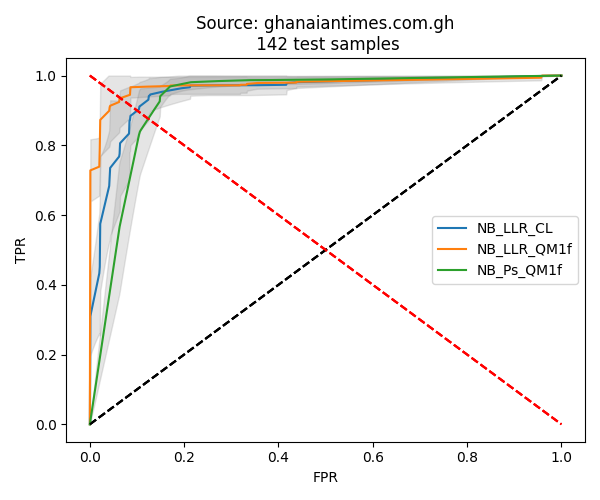

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
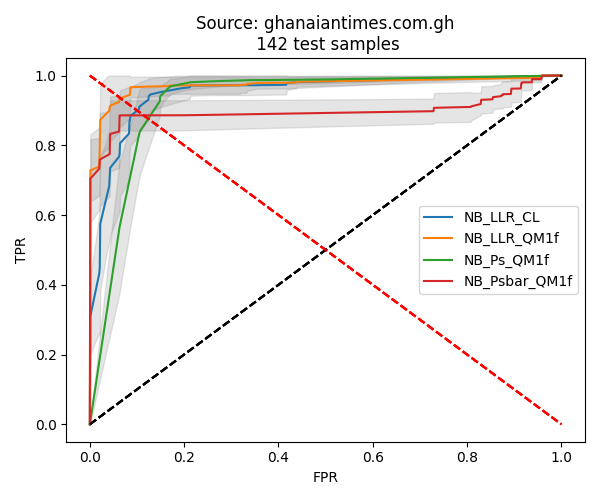

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
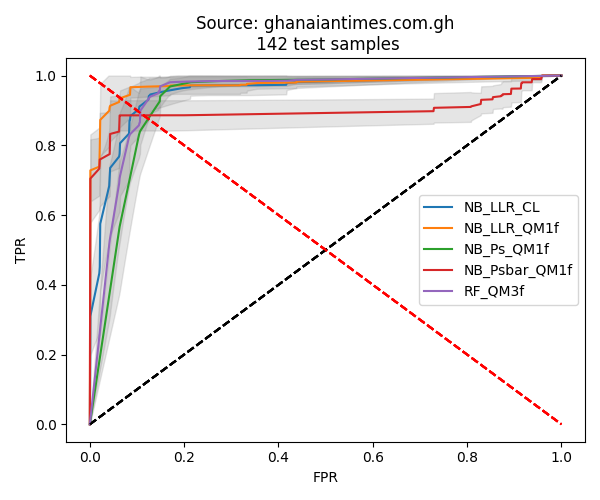

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
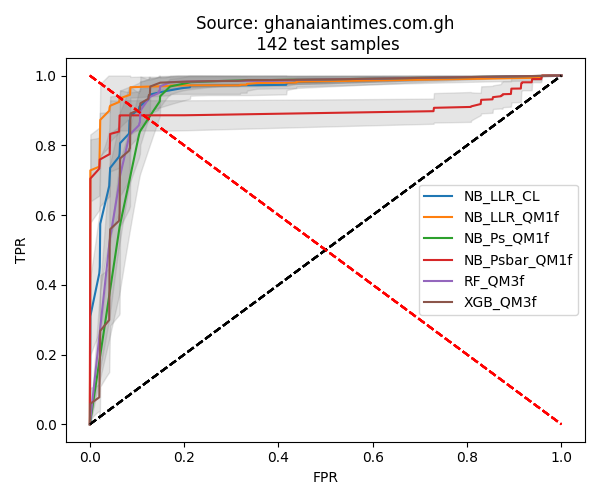

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
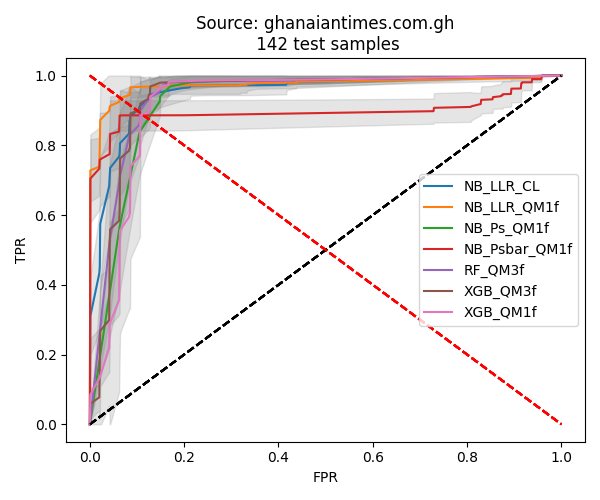

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
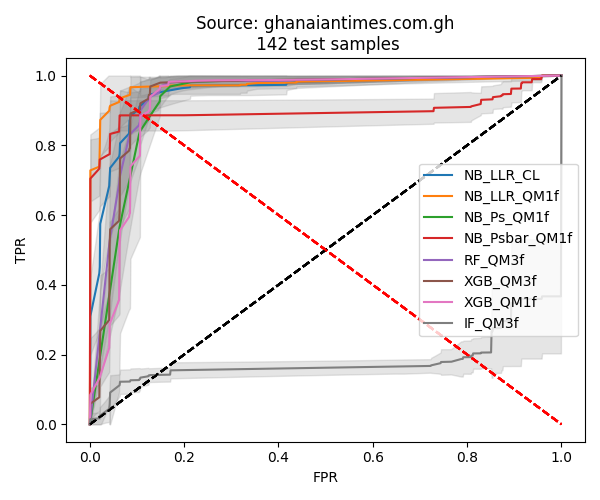

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
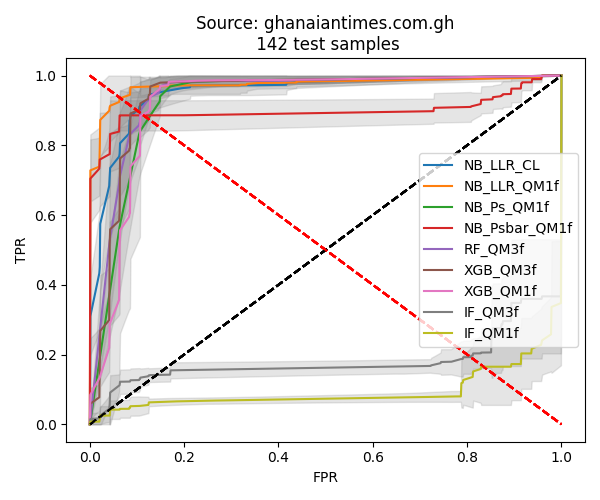

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
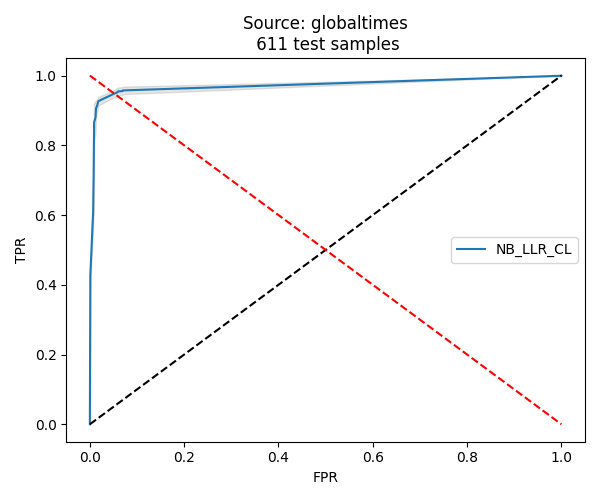

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
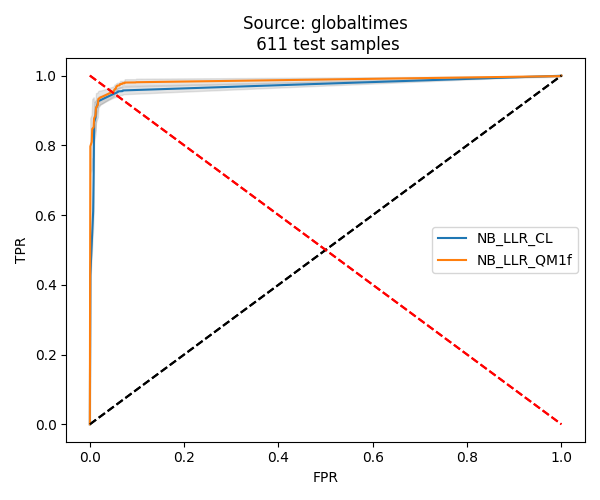

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
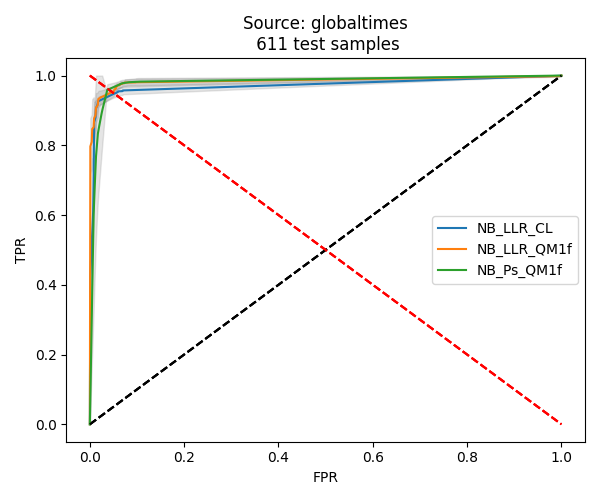

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
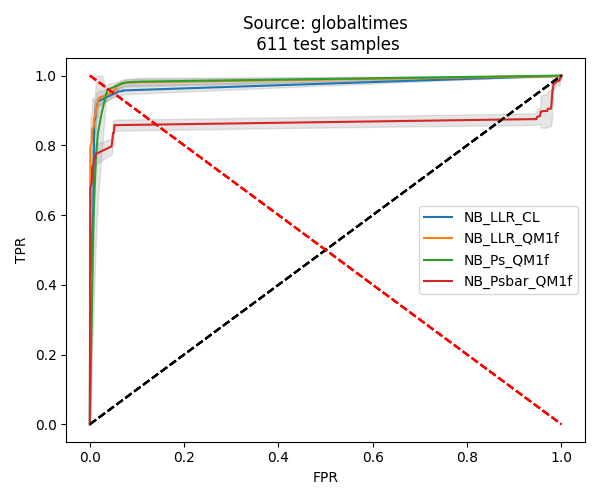

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
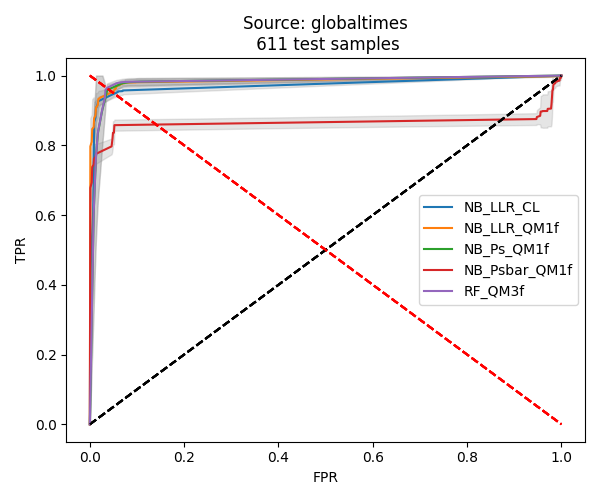

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
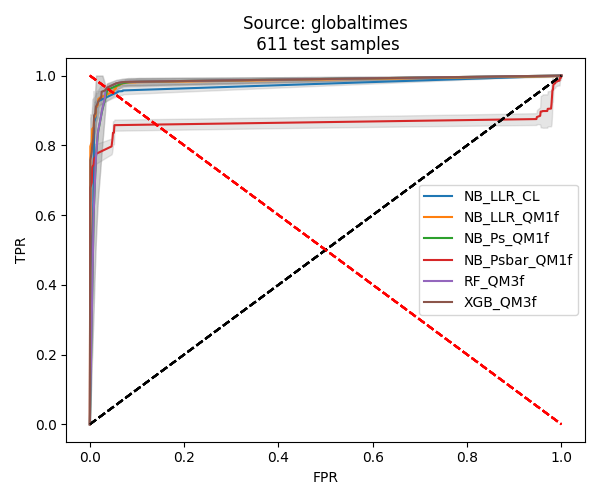

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
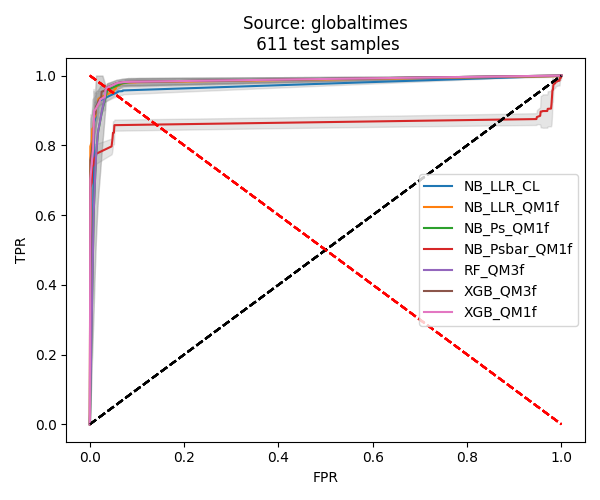

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
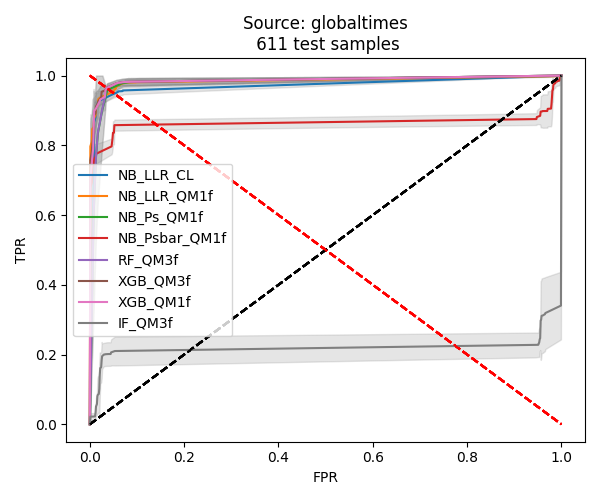

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
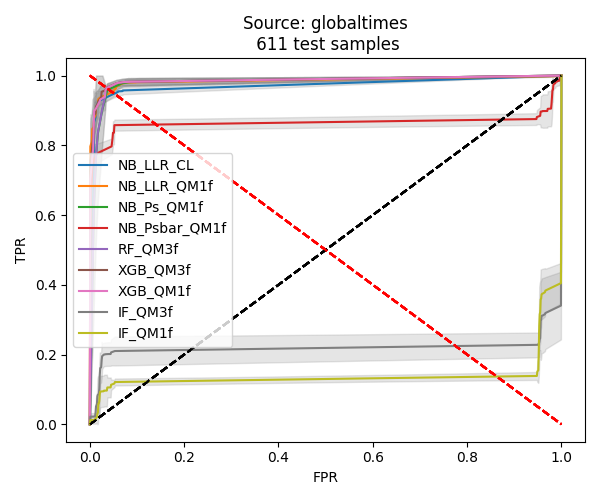

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
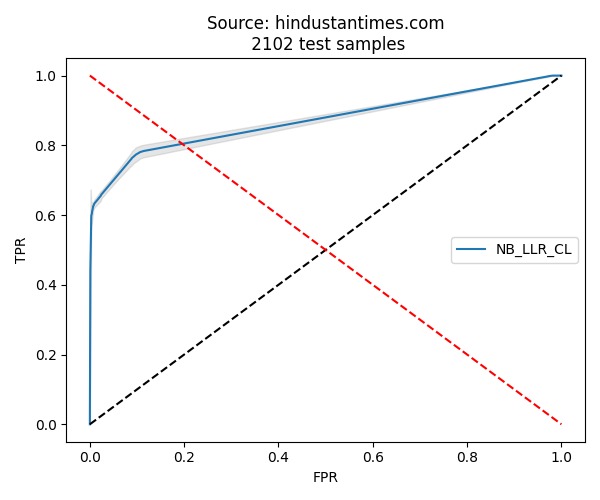

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
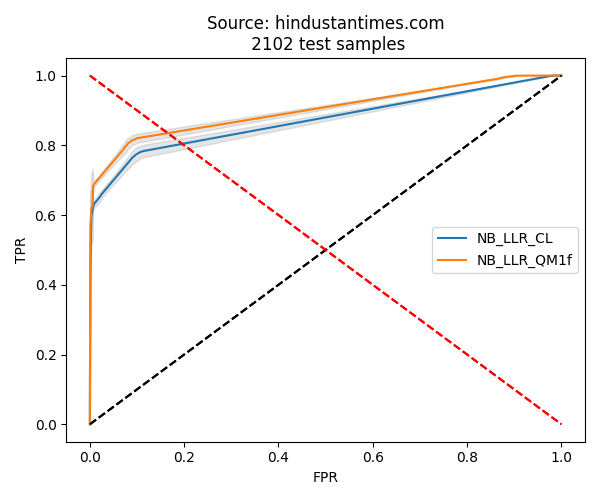

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
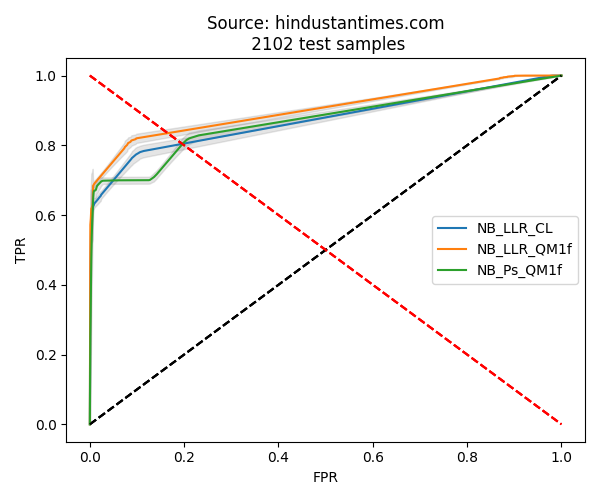

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
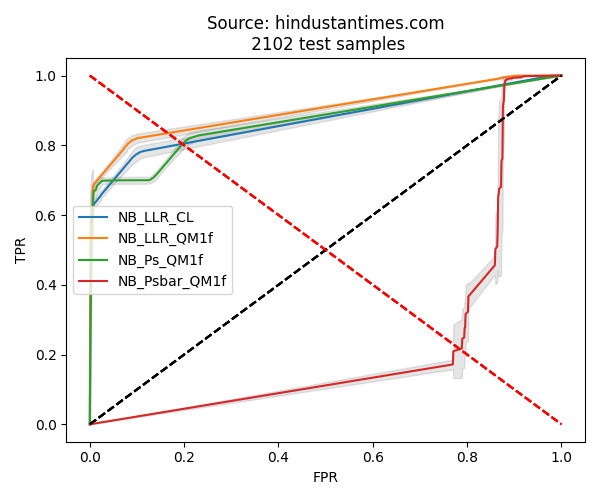

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
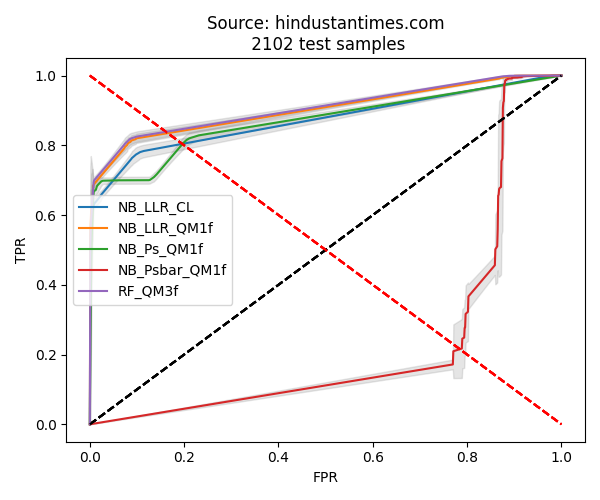

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
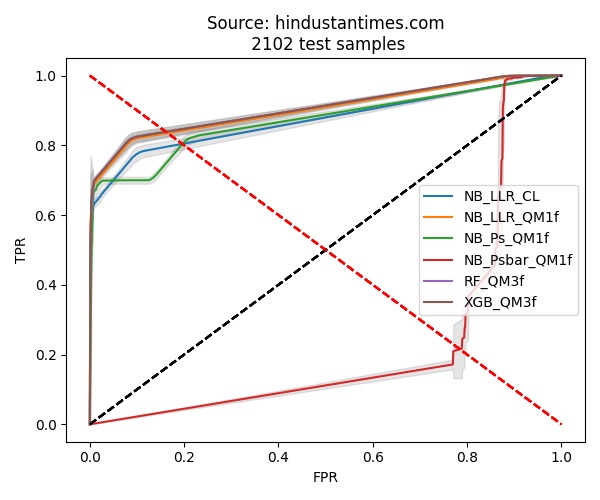

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
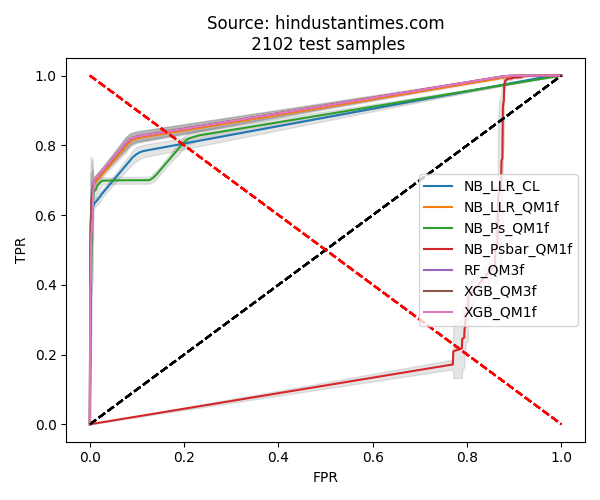

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
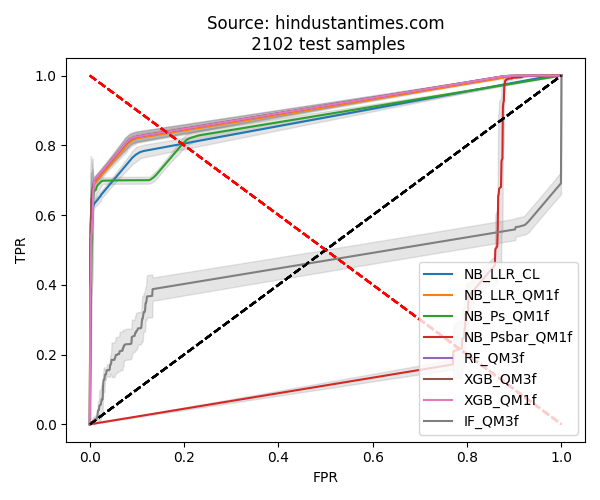

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
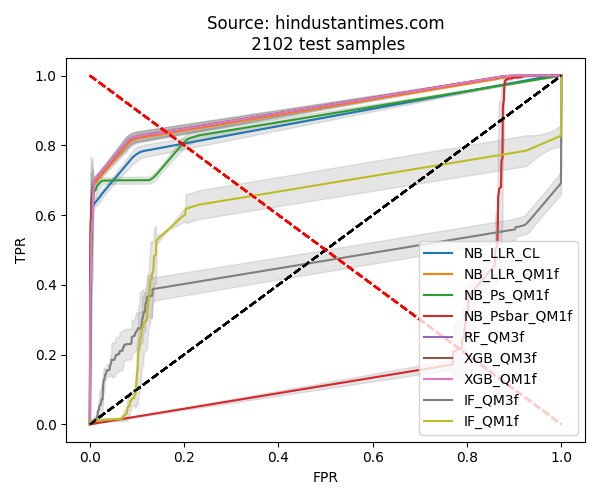

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
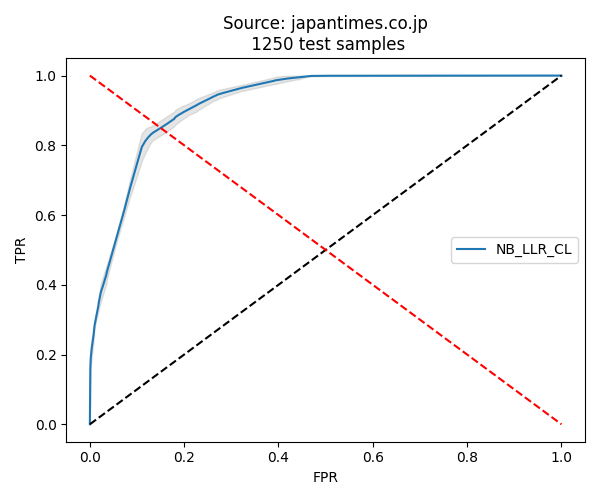

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
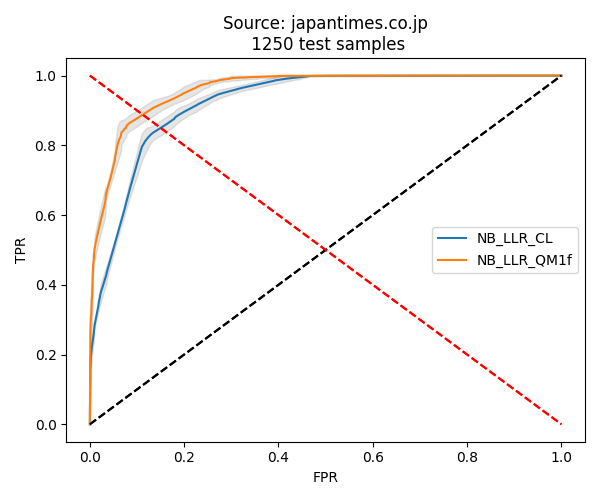

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
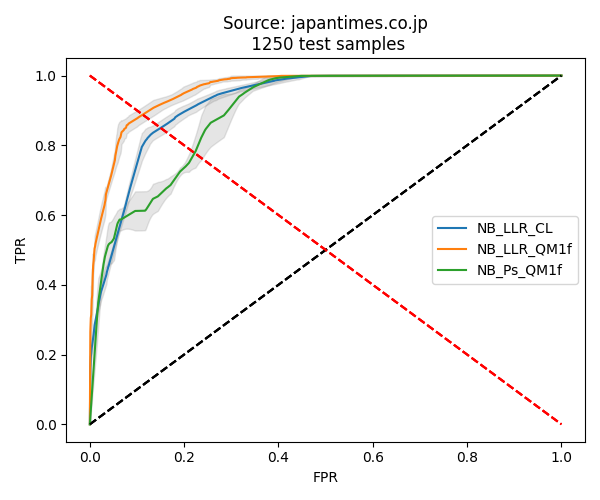

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
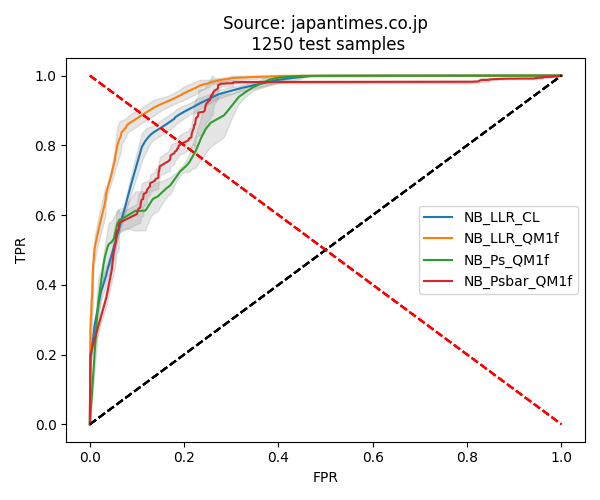

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
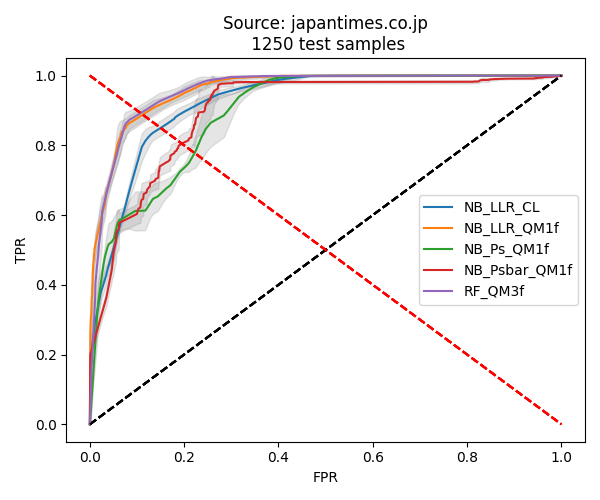

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
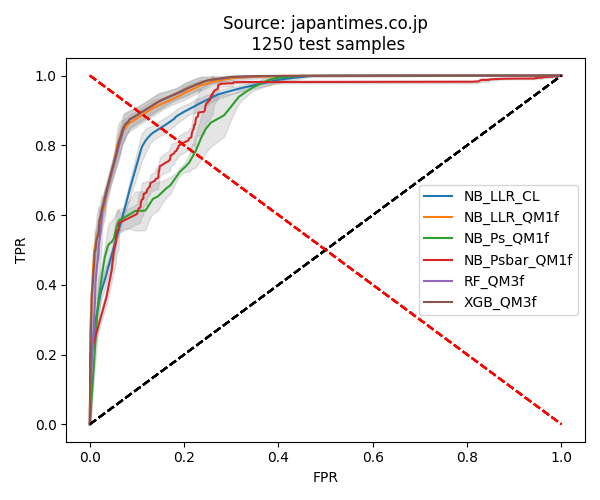

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
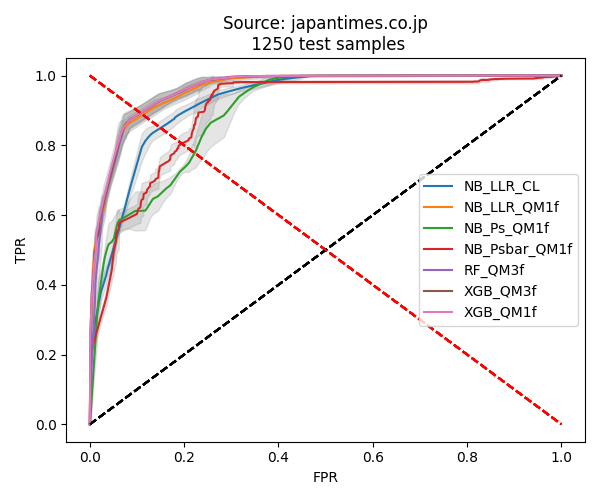

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
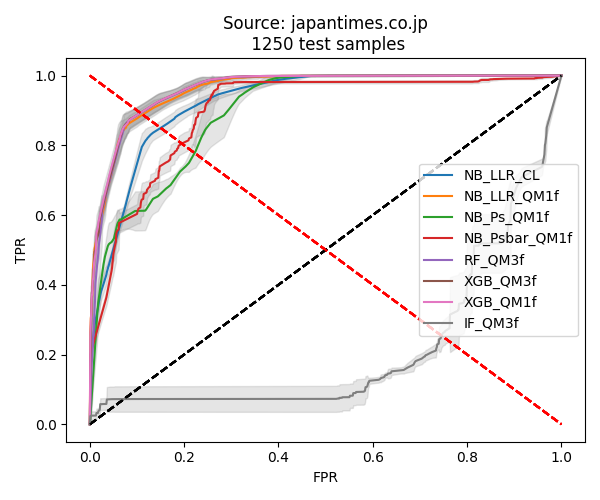

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
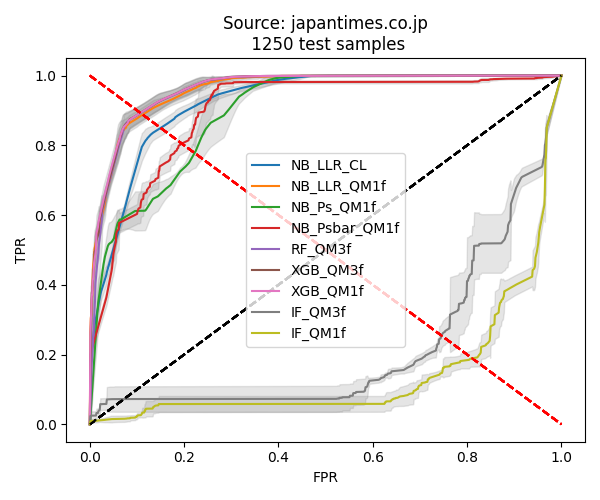

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
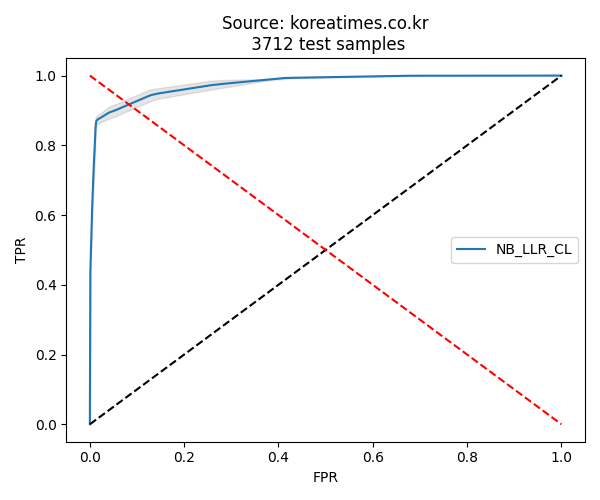

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
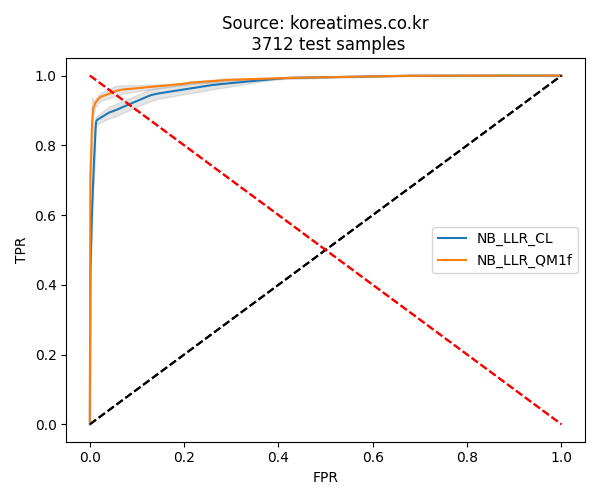

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
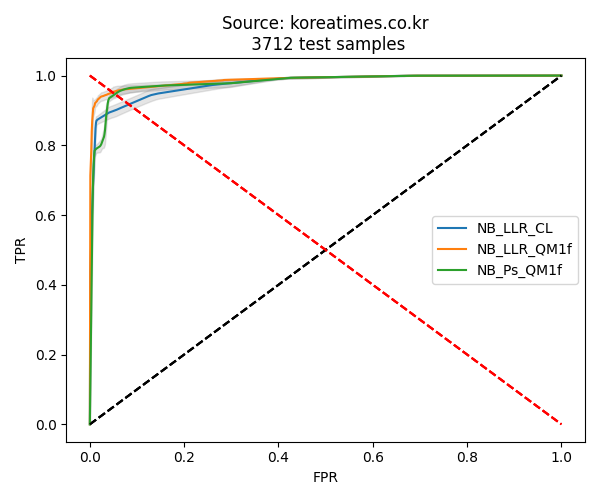

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
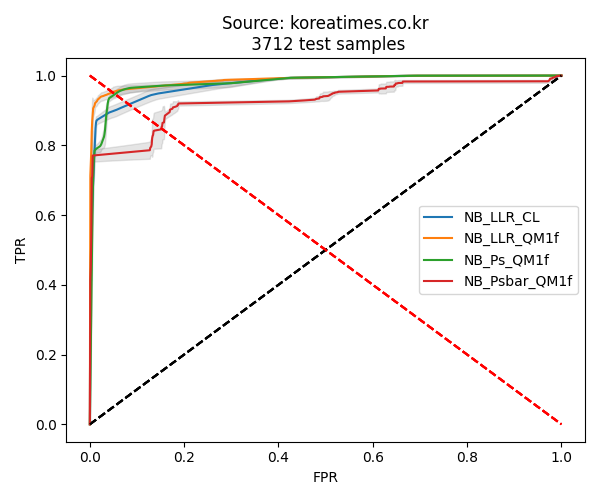

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
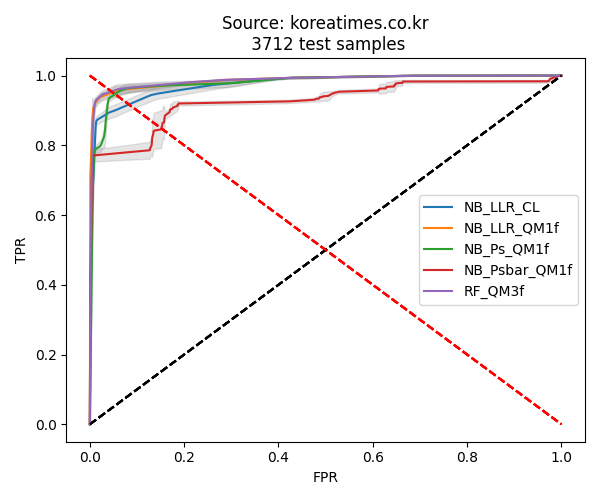

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
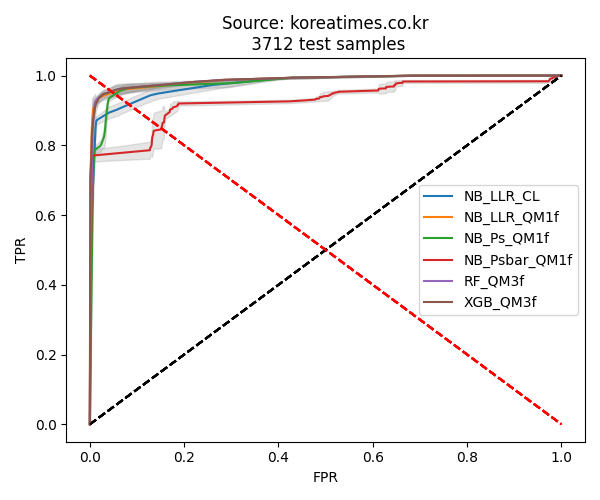

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
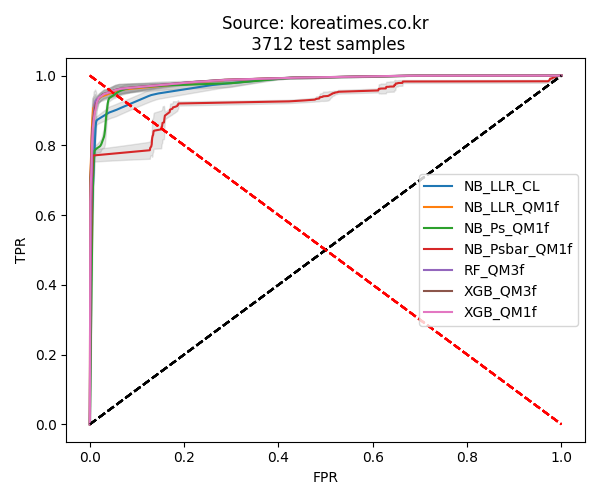

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
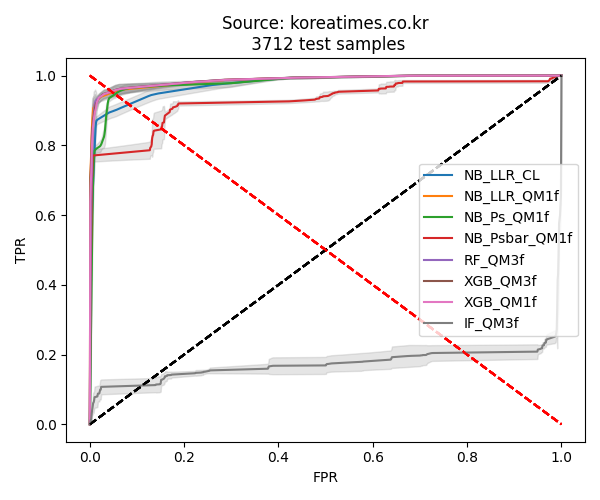

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
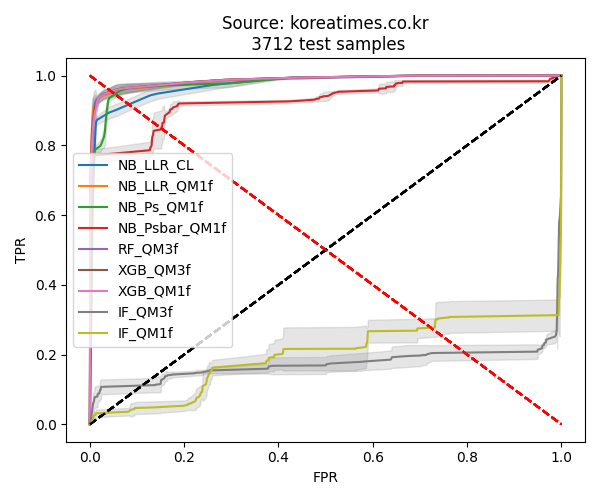

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
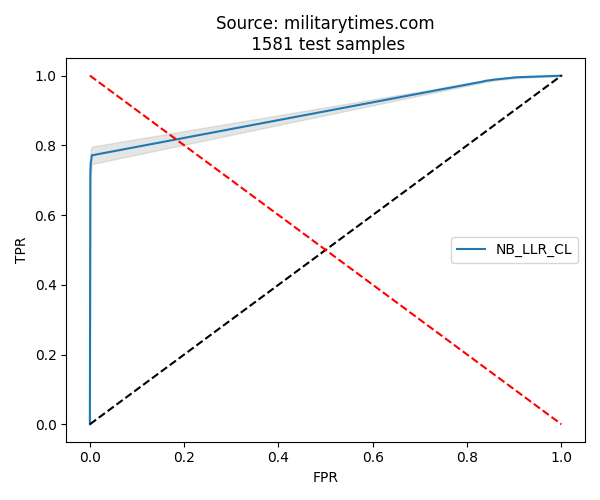

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
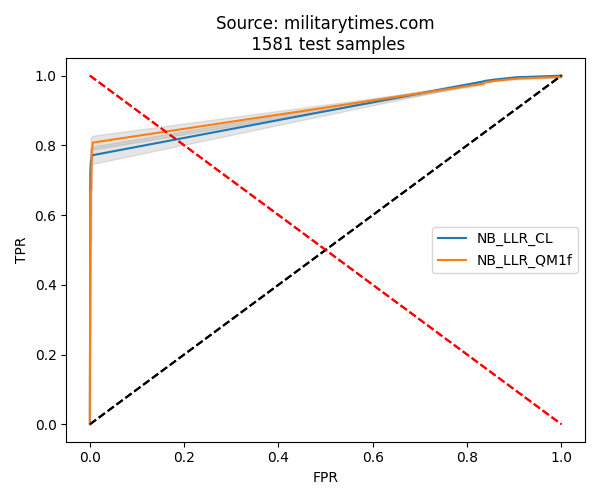

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
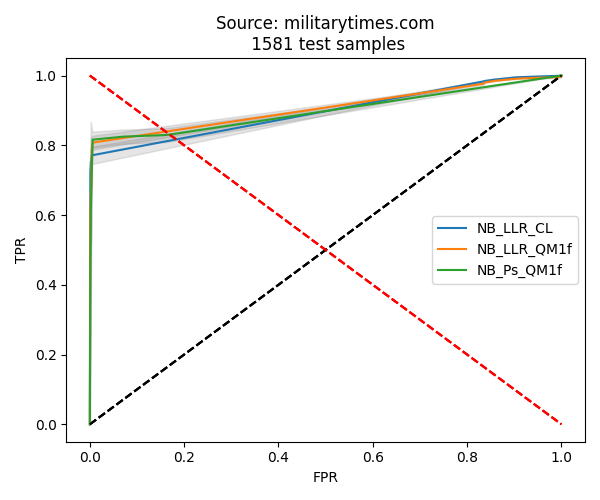

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
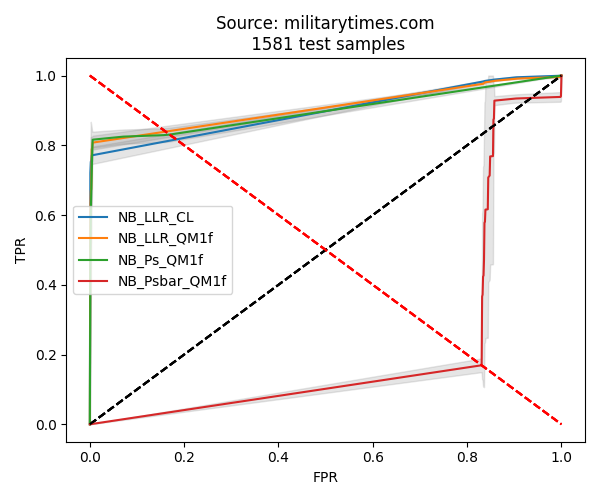

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
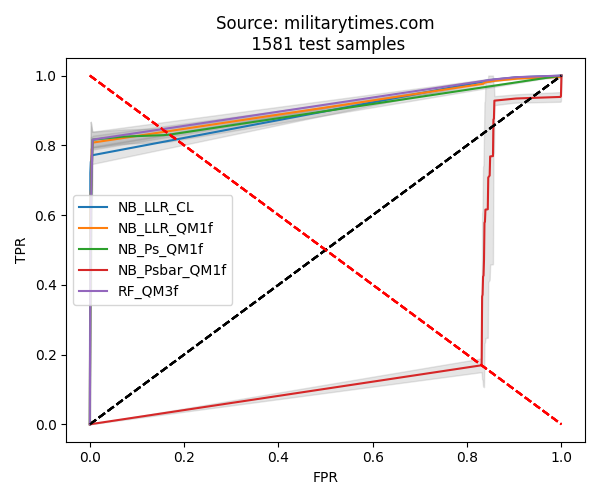

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
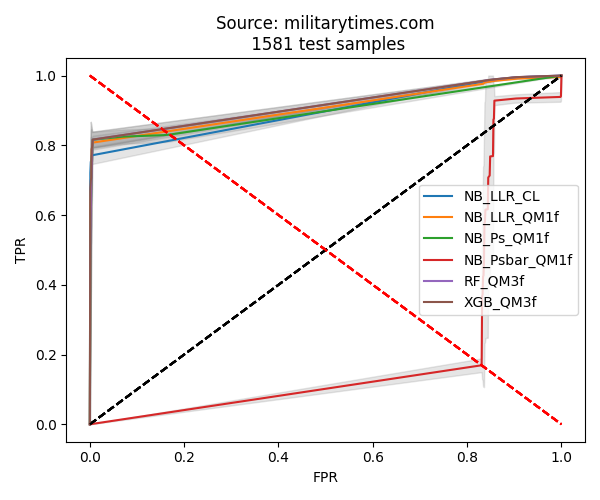

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
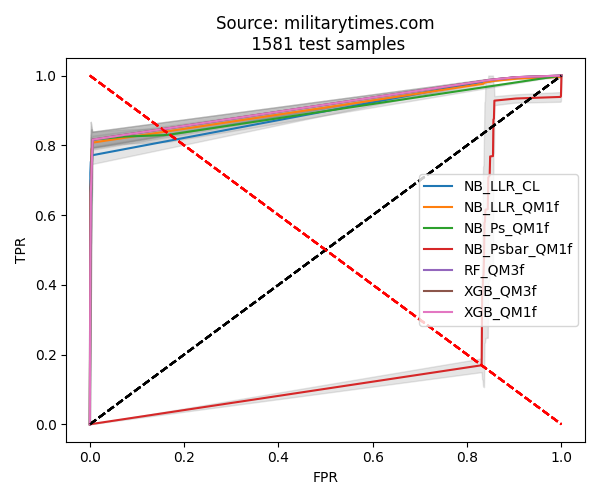

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
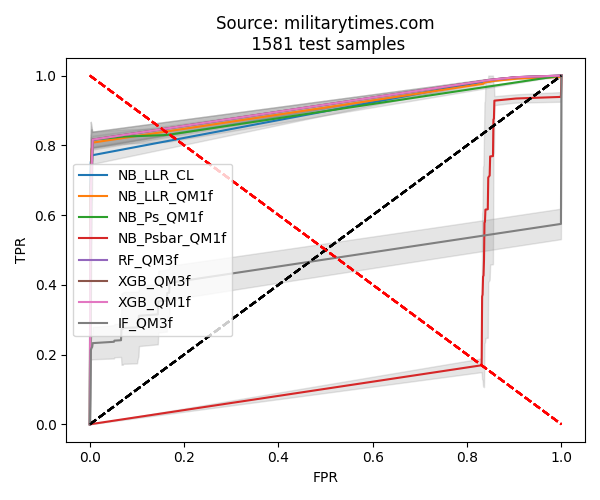

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
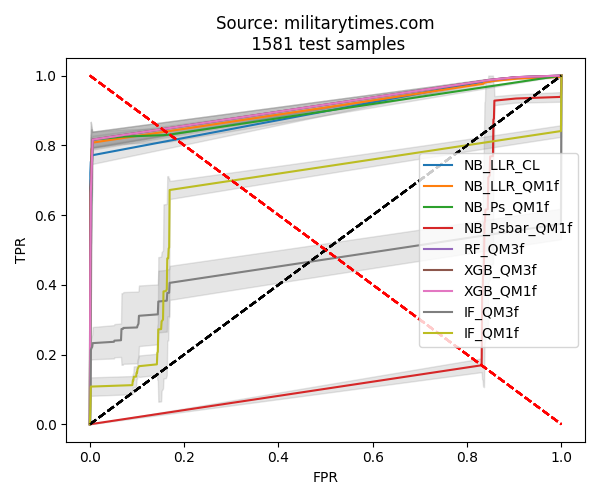

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
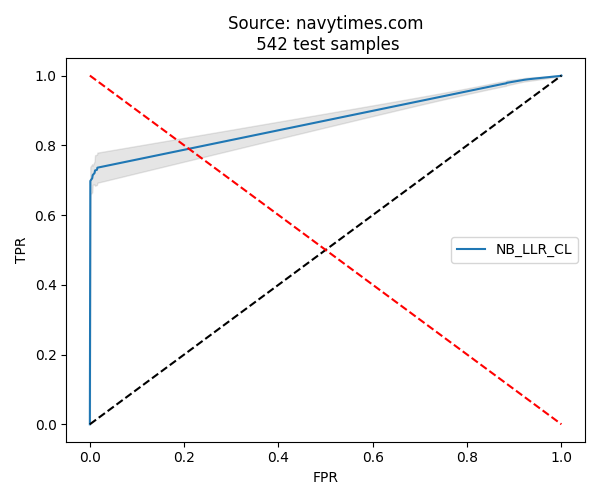

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
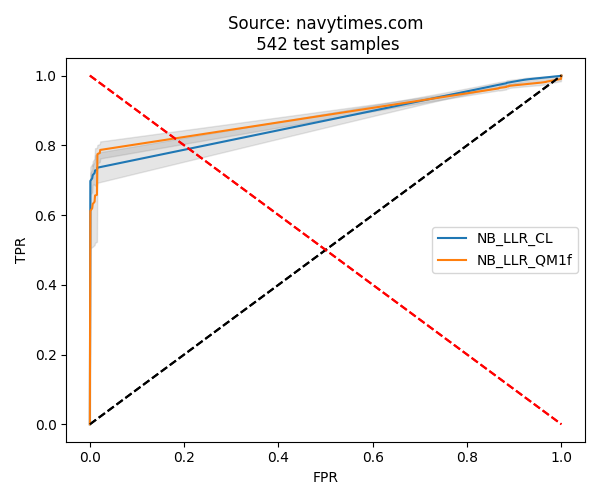

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
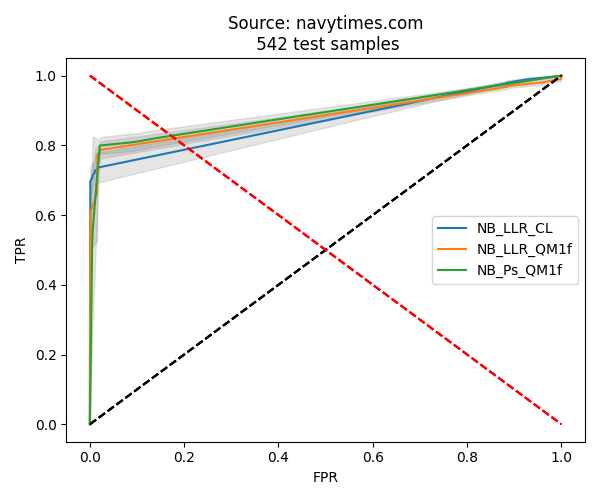

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
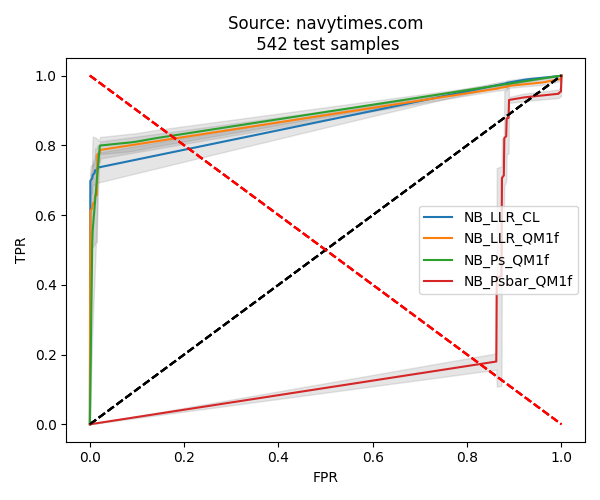

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
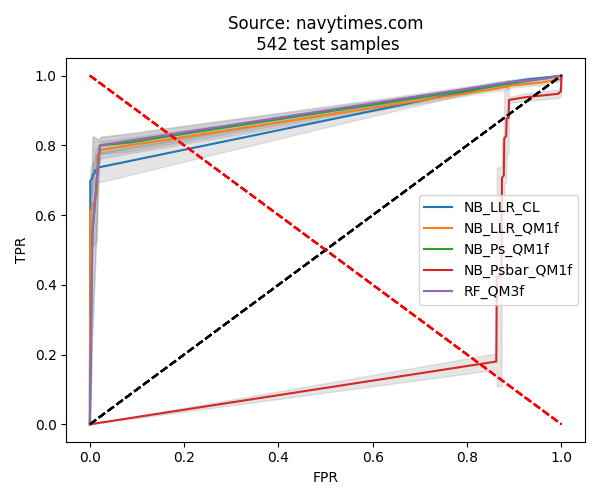

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
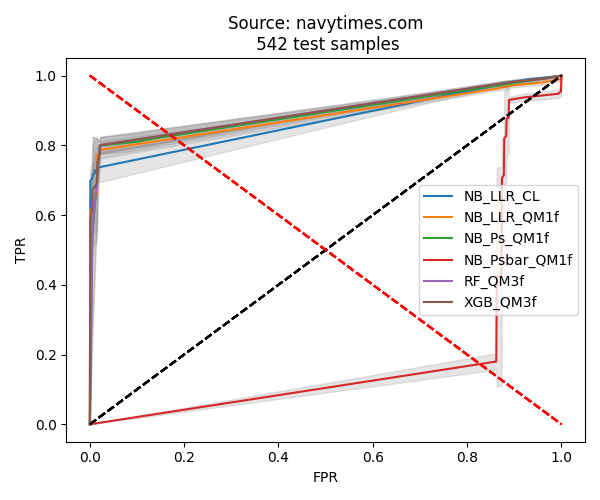

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
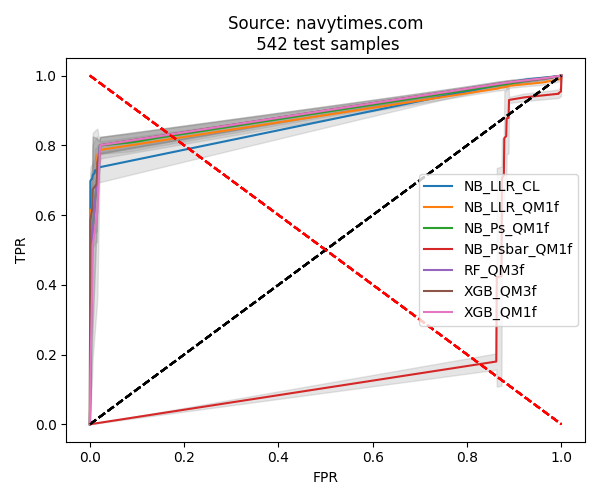

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
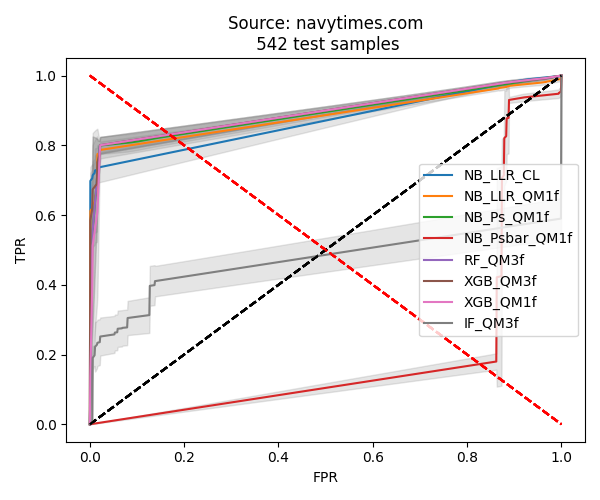

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
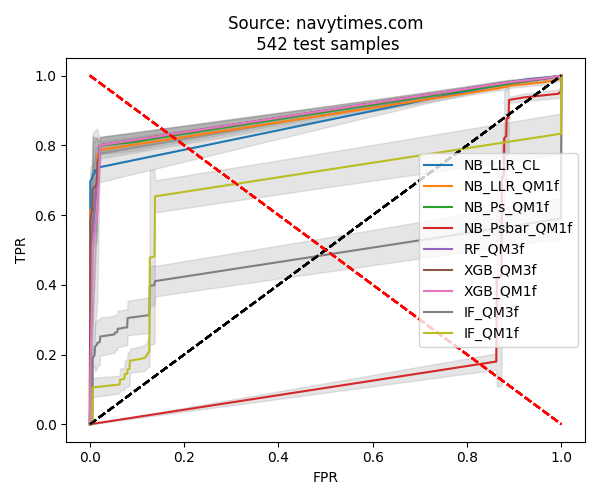

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
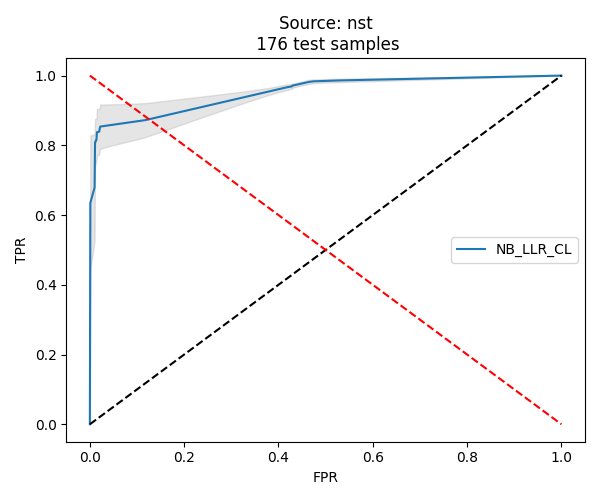

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
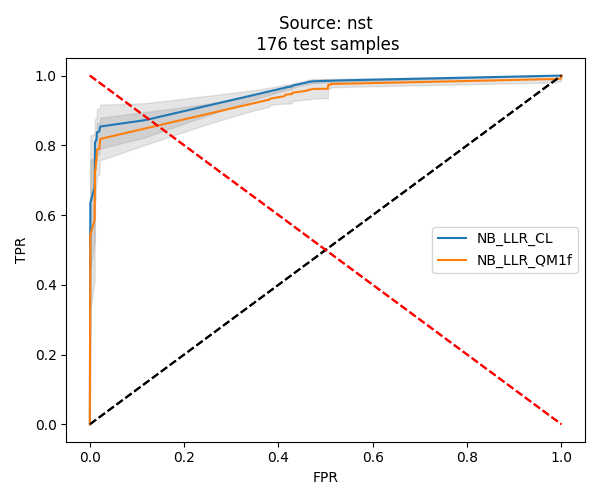

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
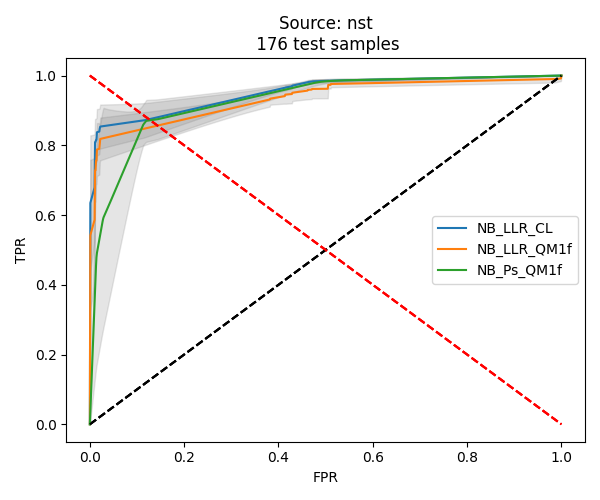

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
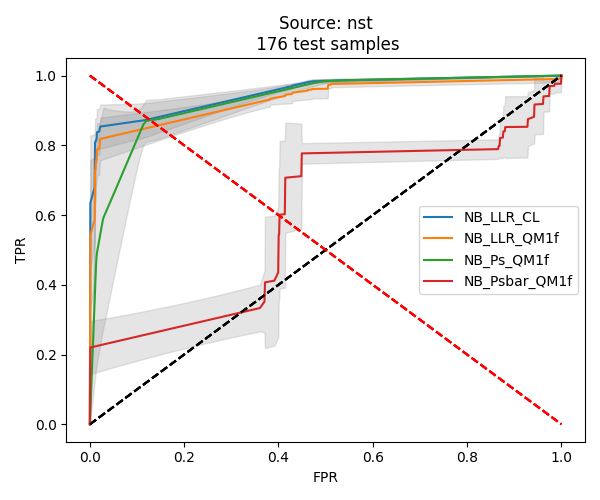

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
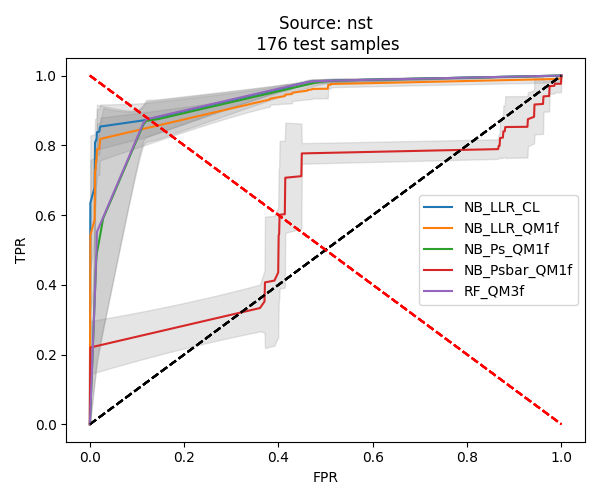

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
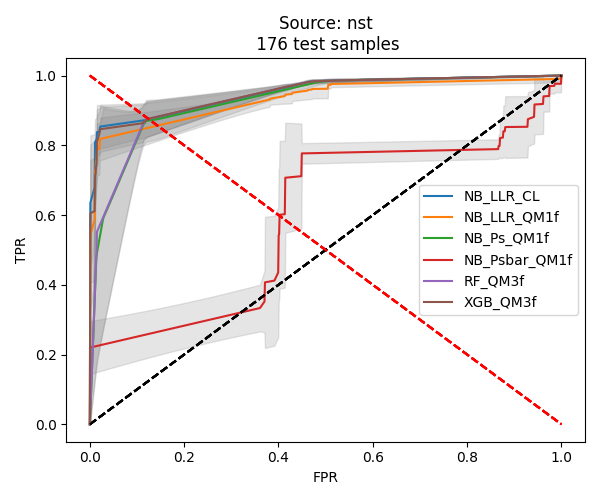

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
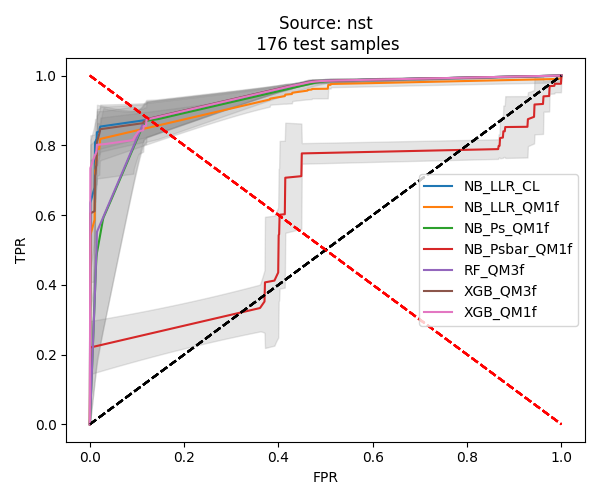

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
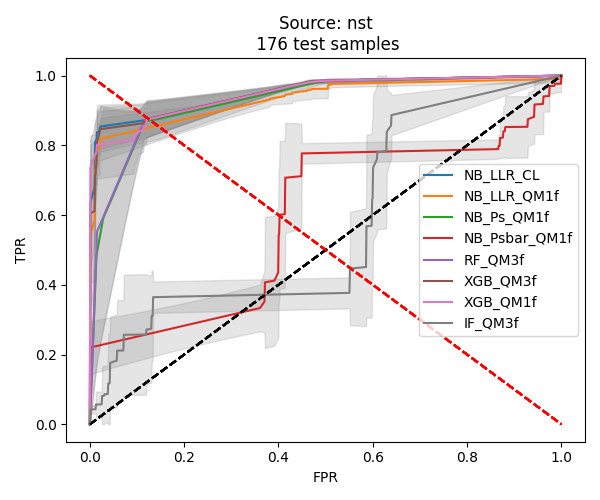

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
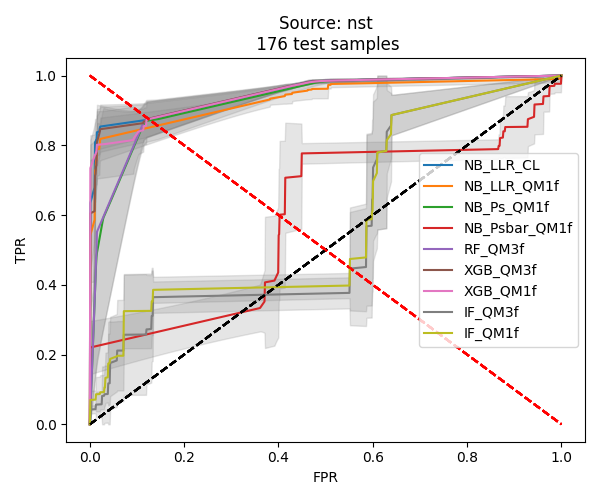

/tmp/ipykernel_13/4126265305.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(6,5))


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
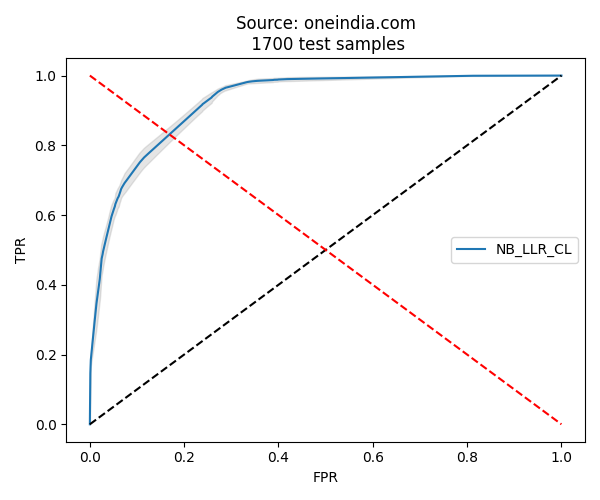

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
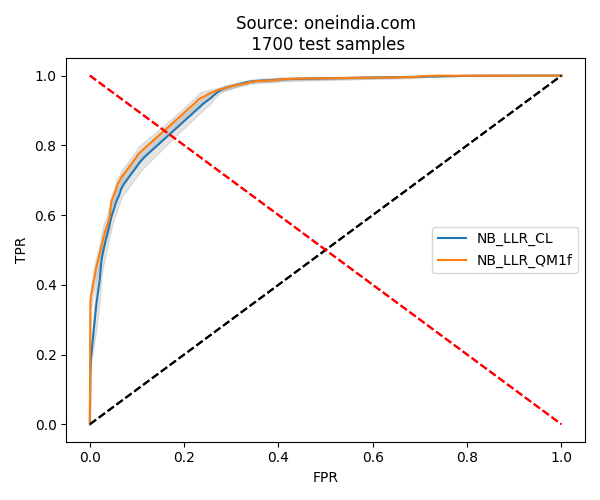

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
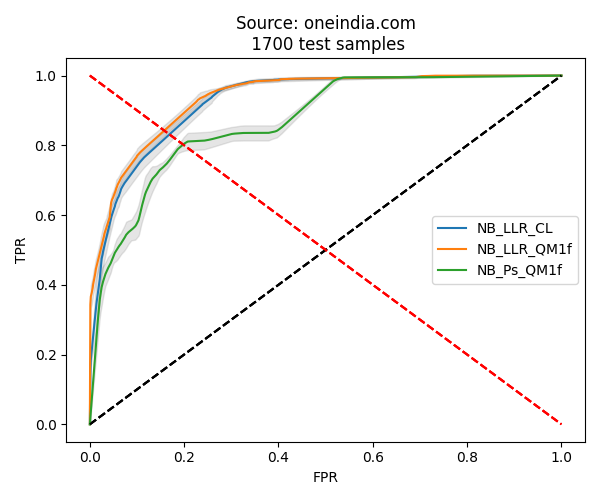

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
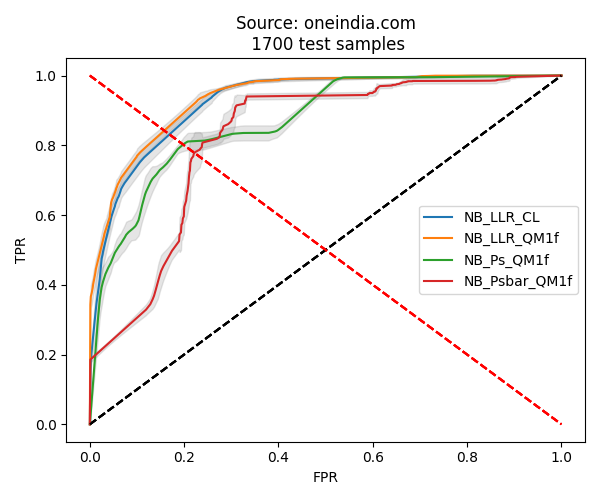

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
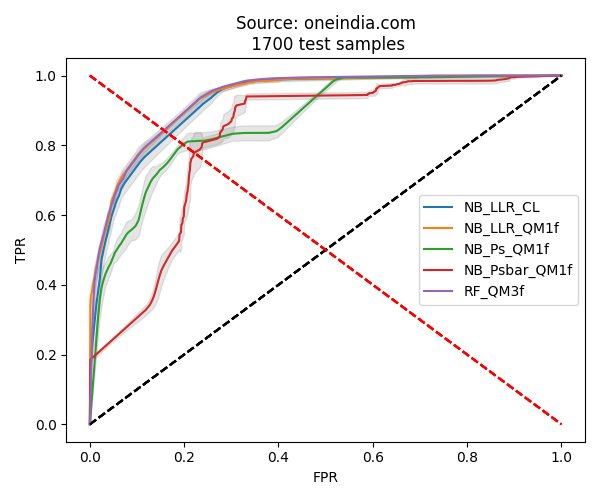

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
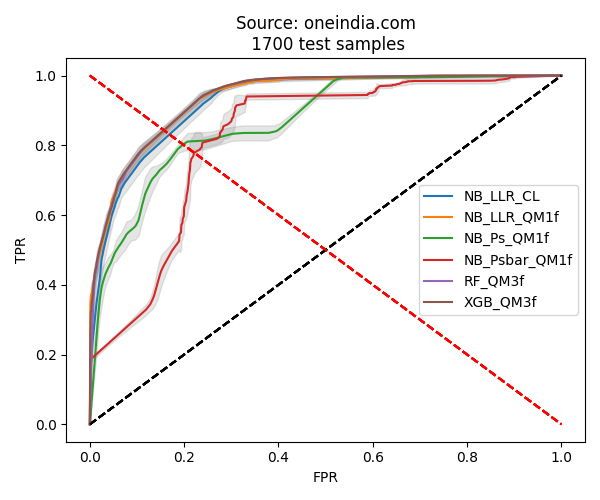

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
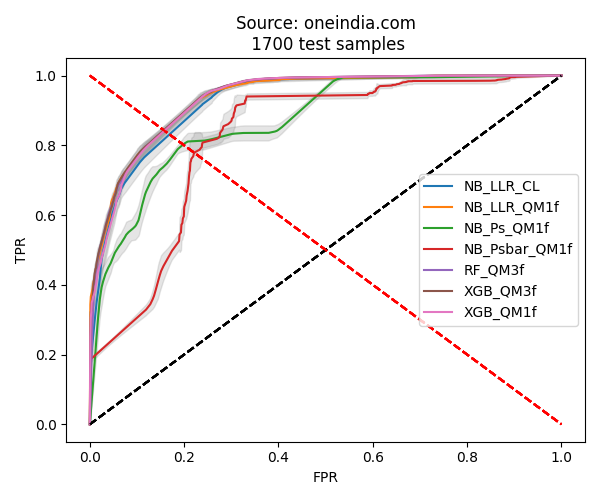

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
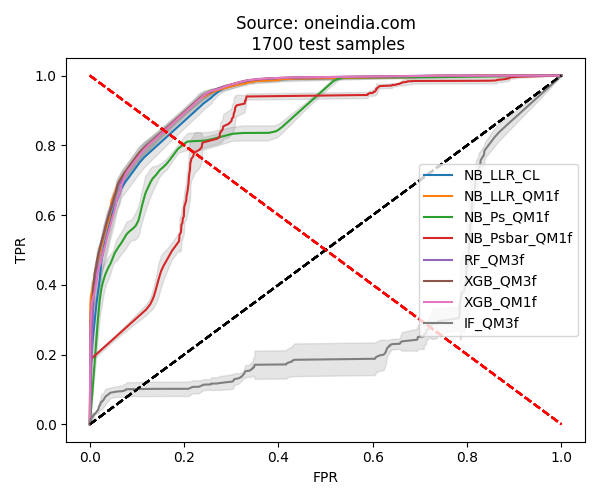

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
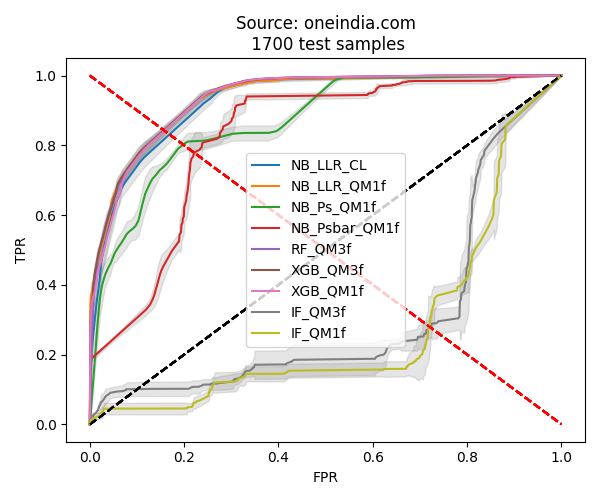

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
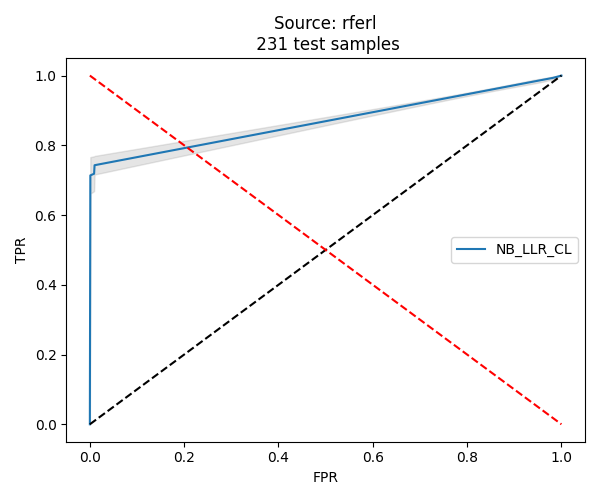

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
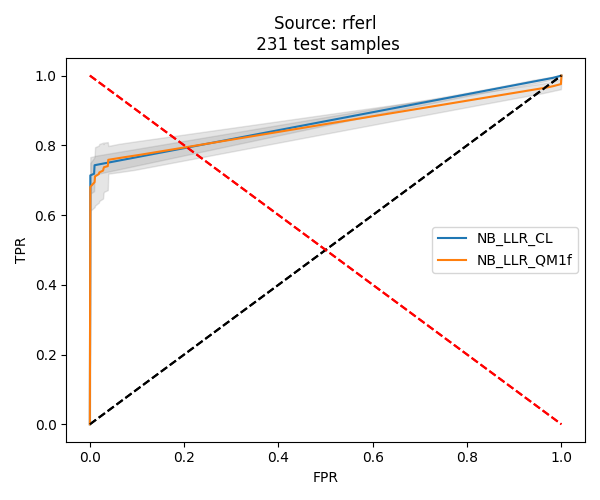

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
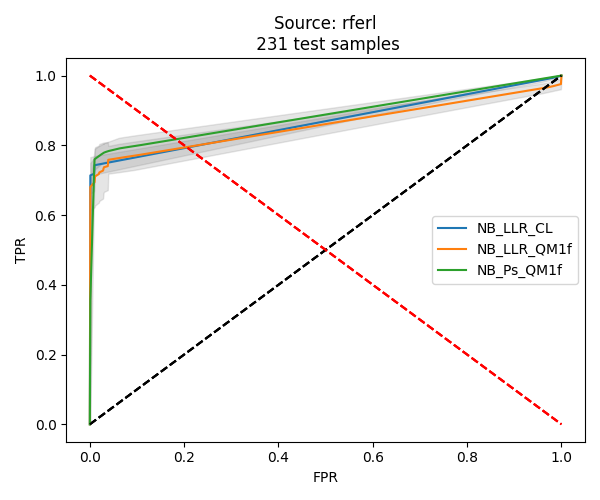

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
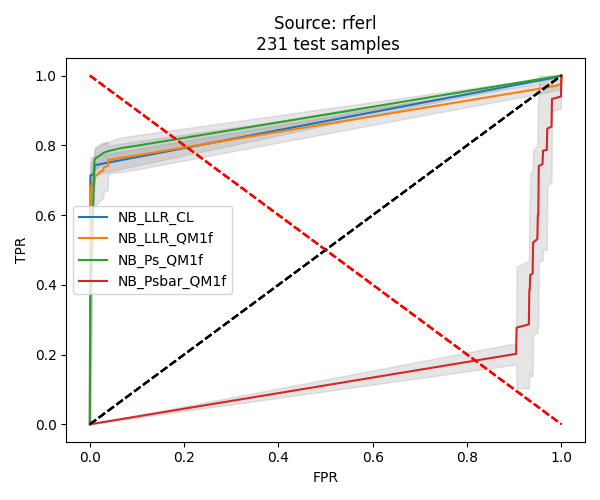

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
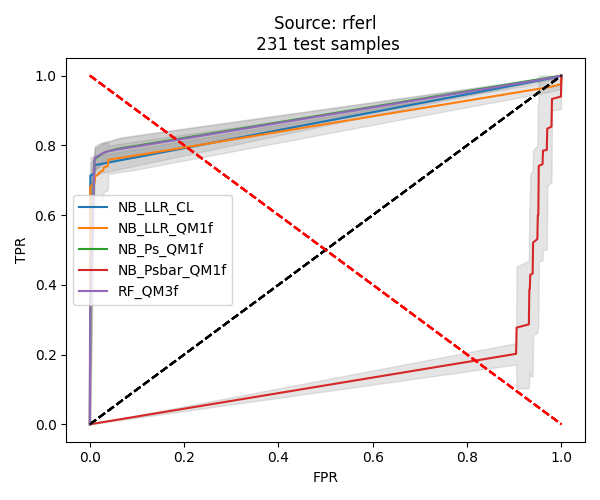

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
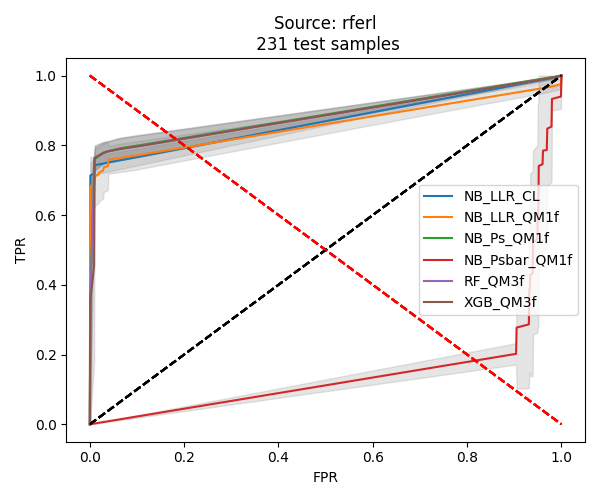

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
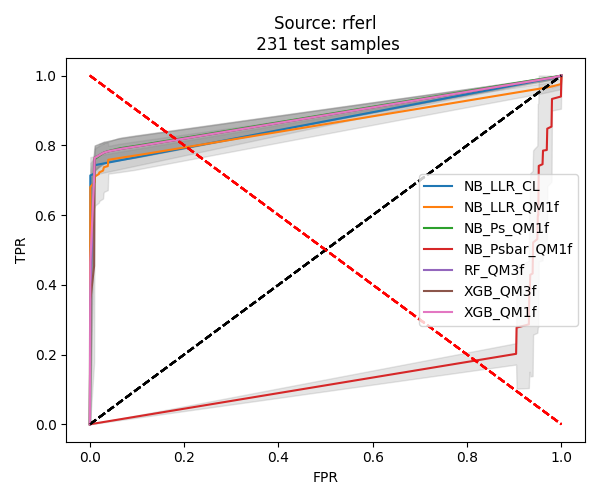

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
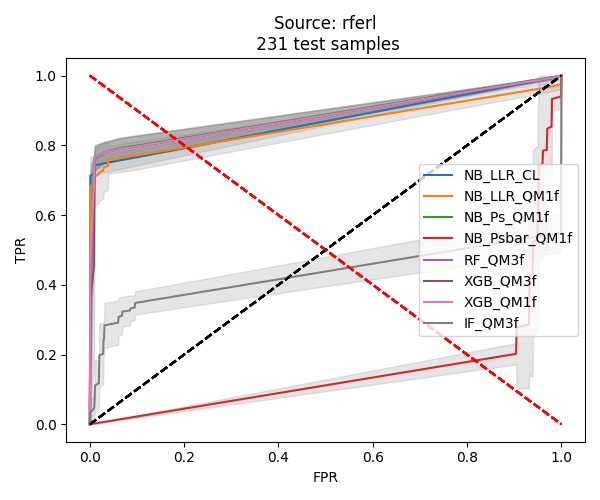

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
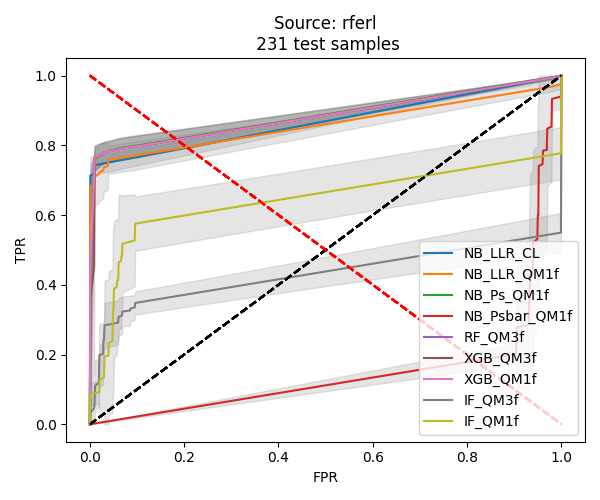

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
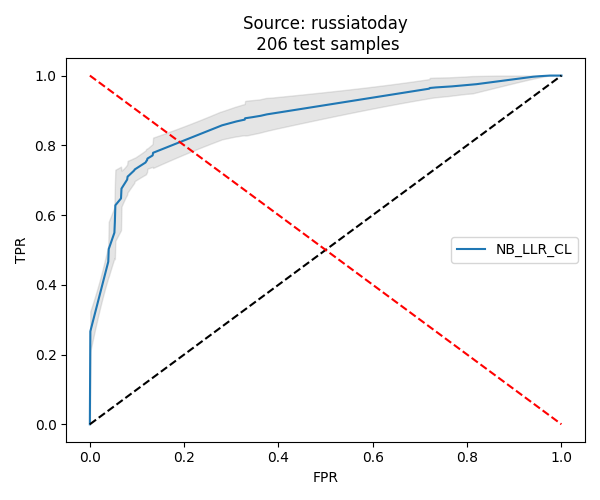

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
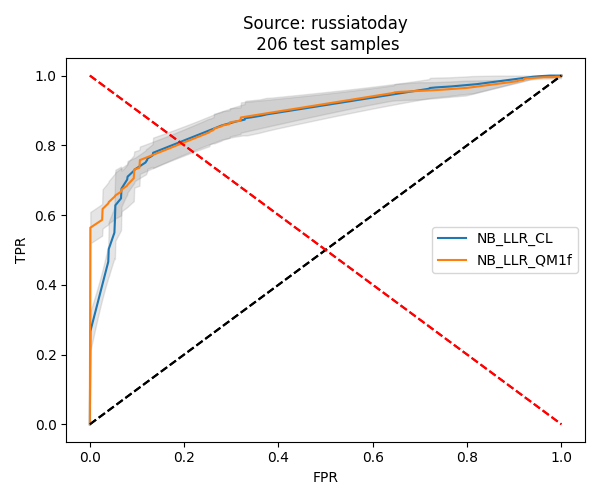

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
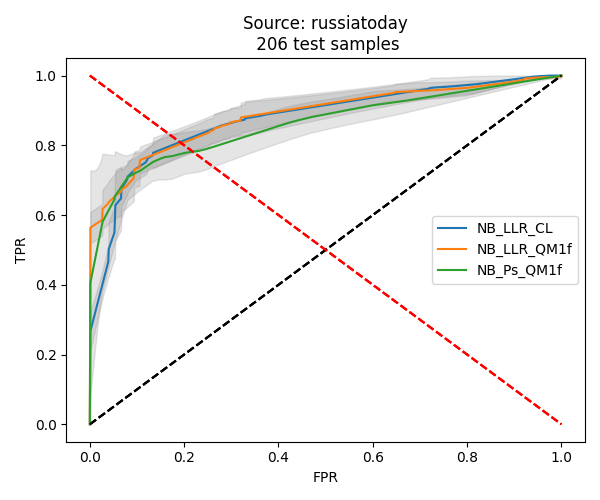

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
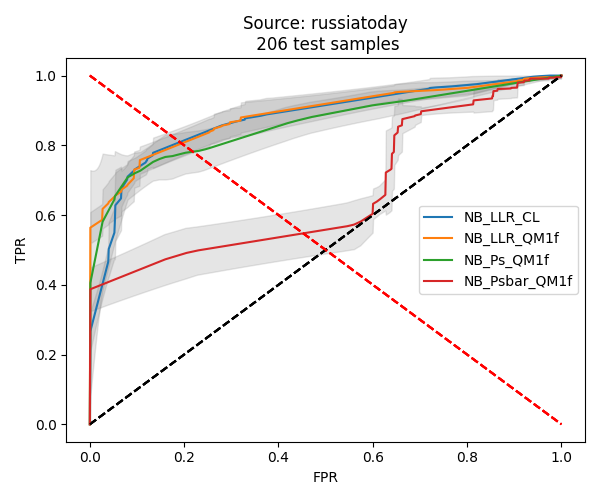

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
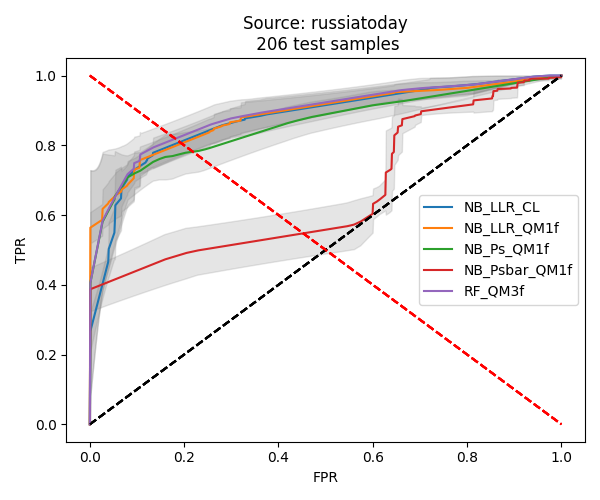

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
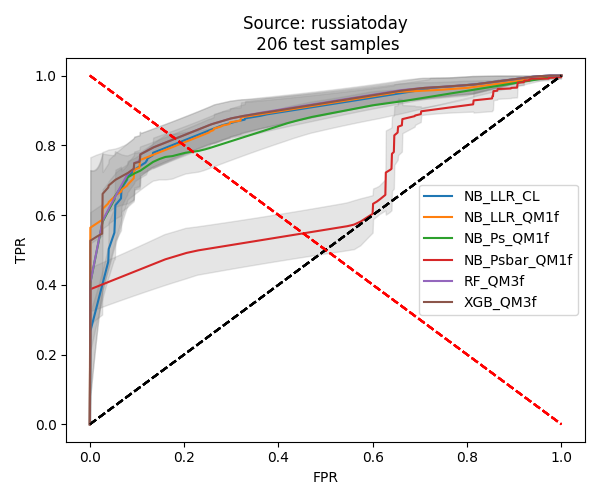

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
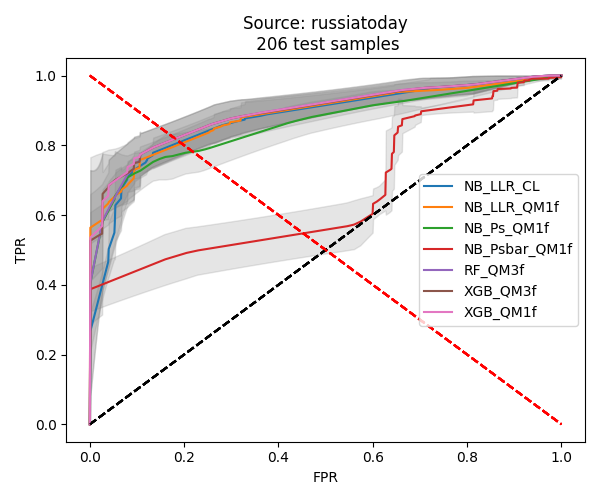

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
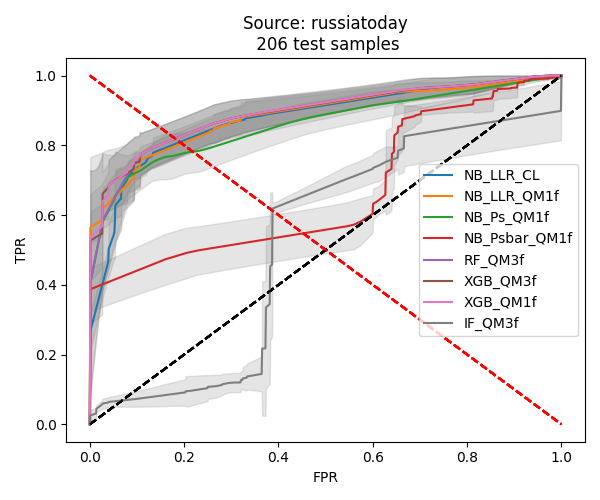

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
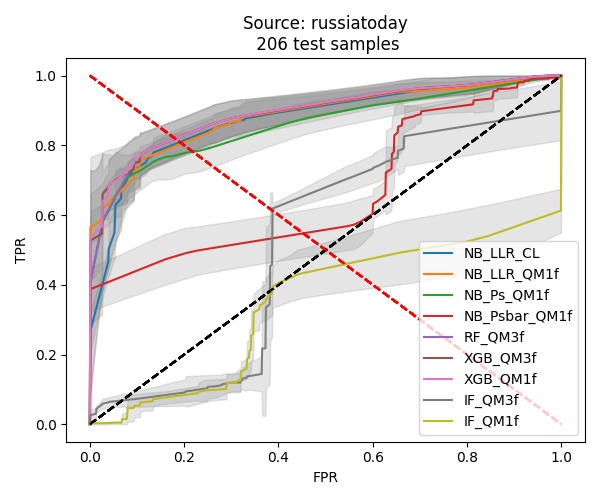

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
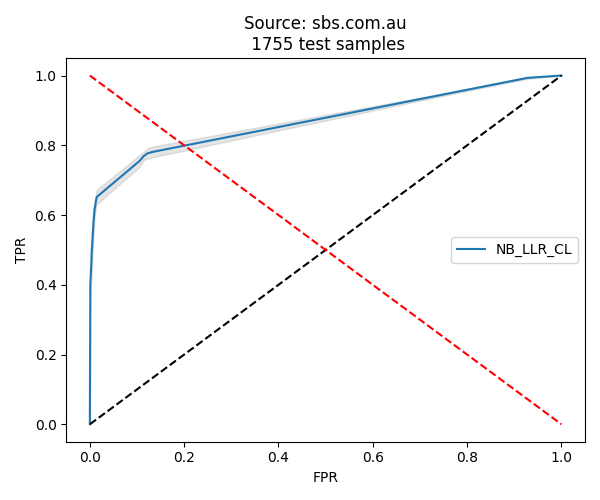

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
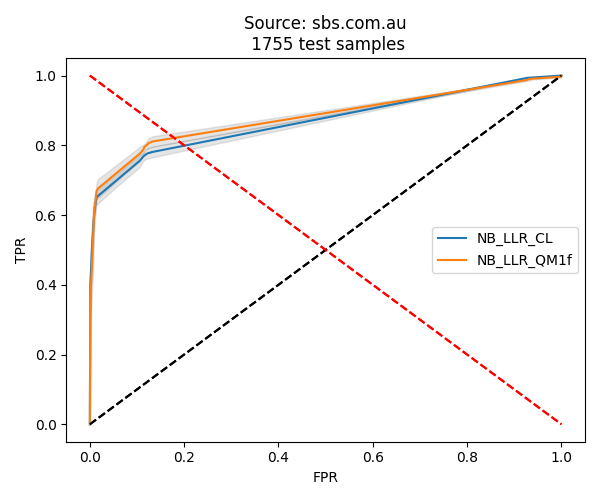

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
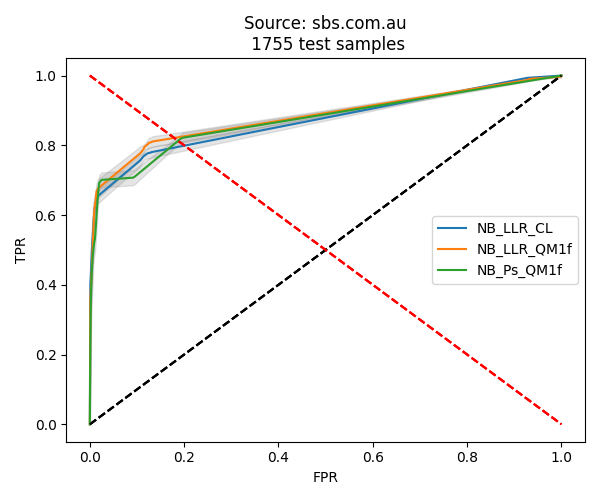

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
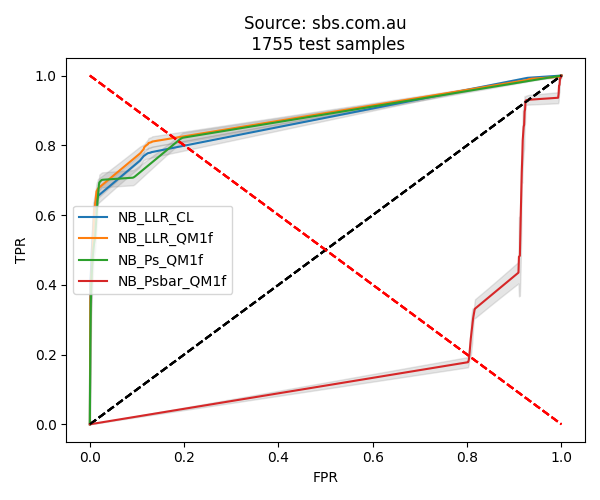

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
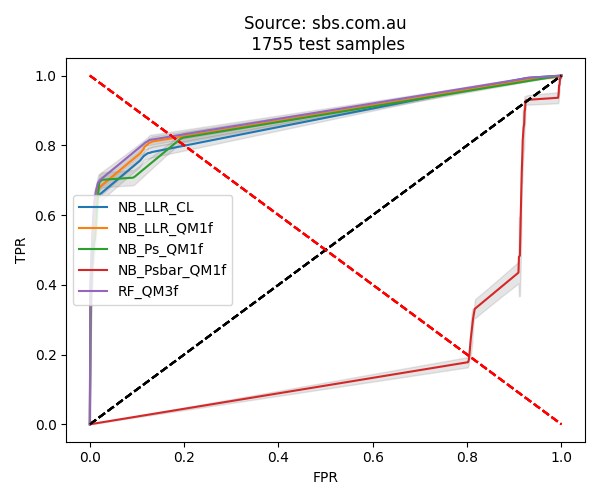

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
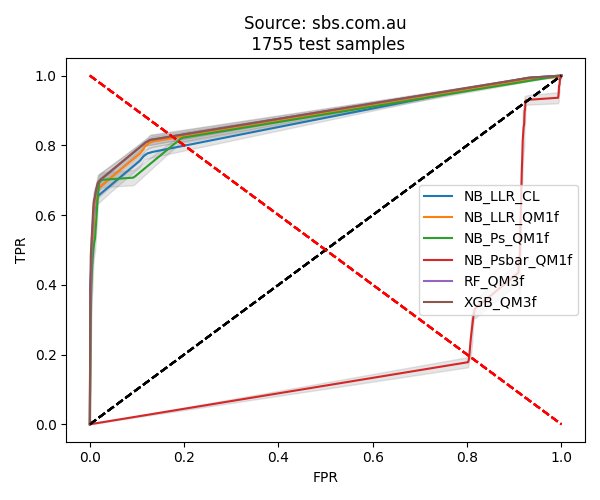

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
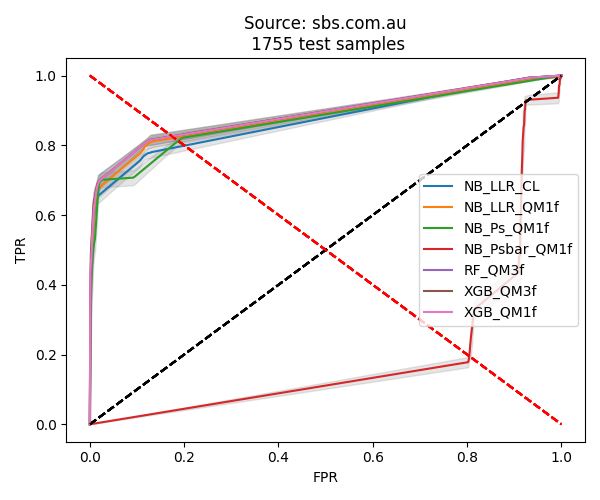

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
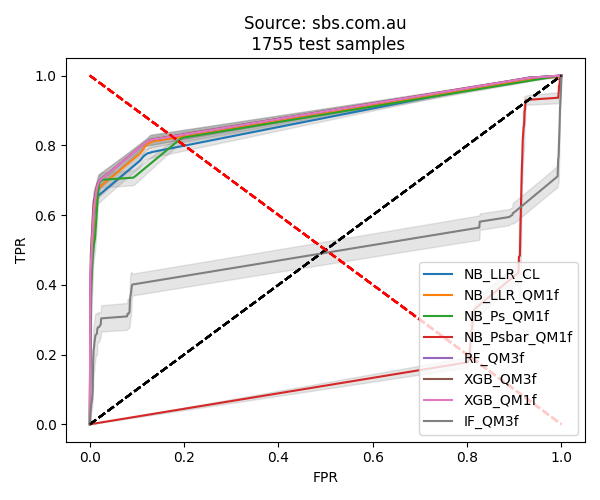

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
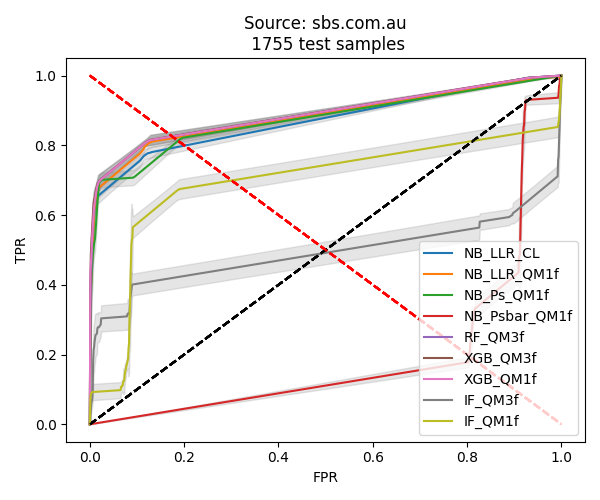

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
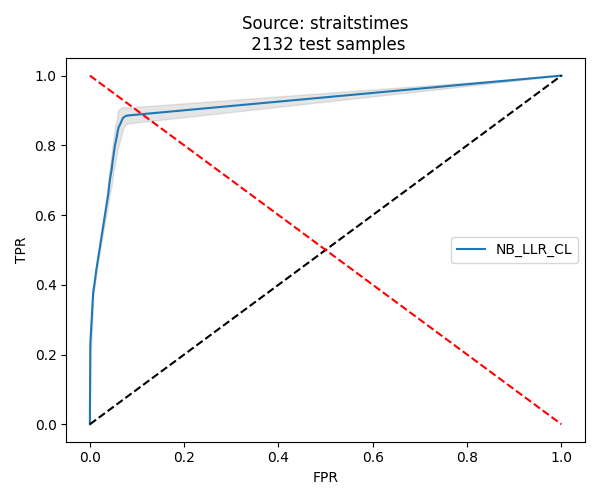

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
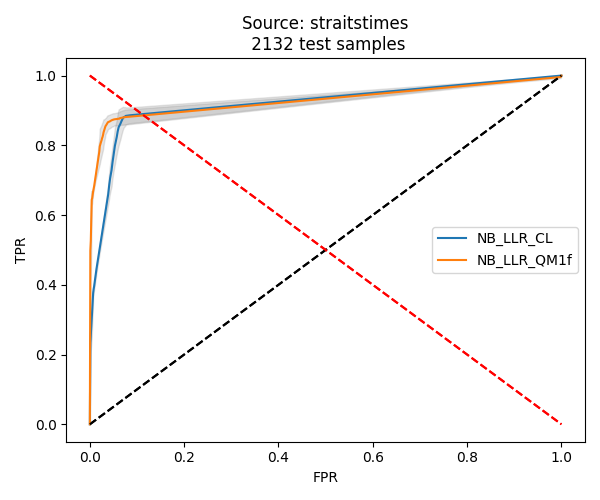

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
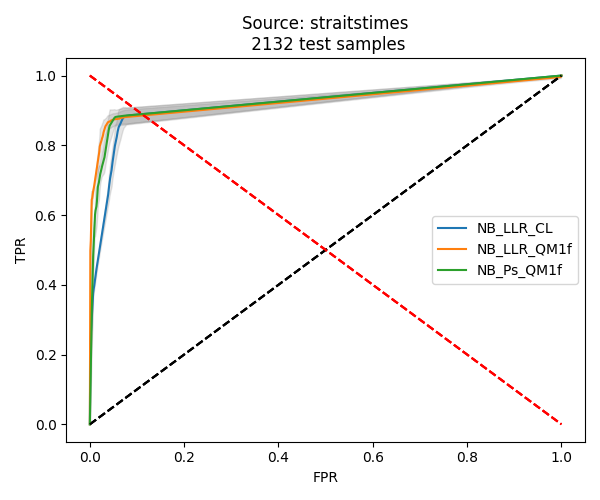

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
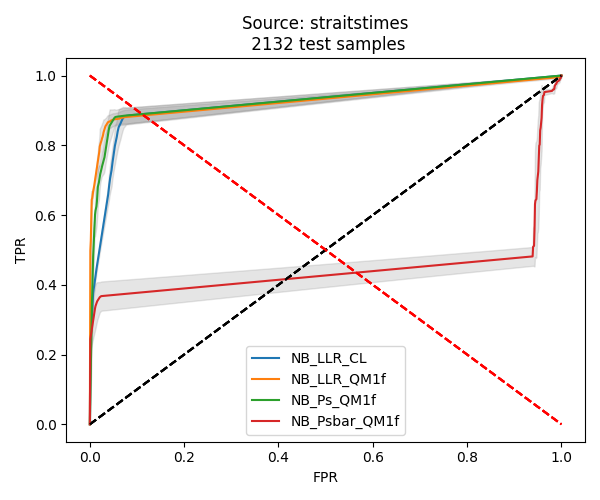

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
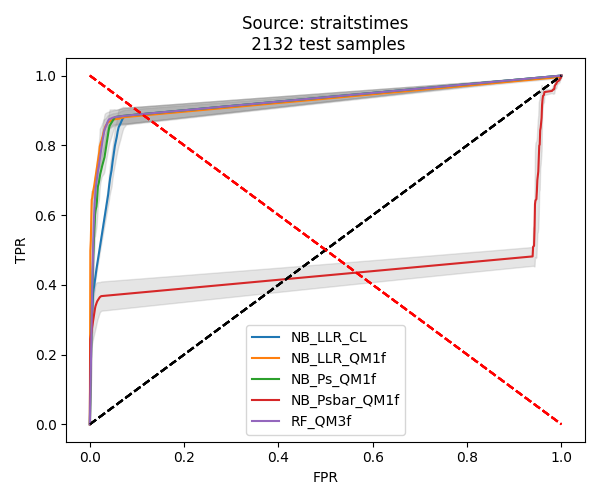

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
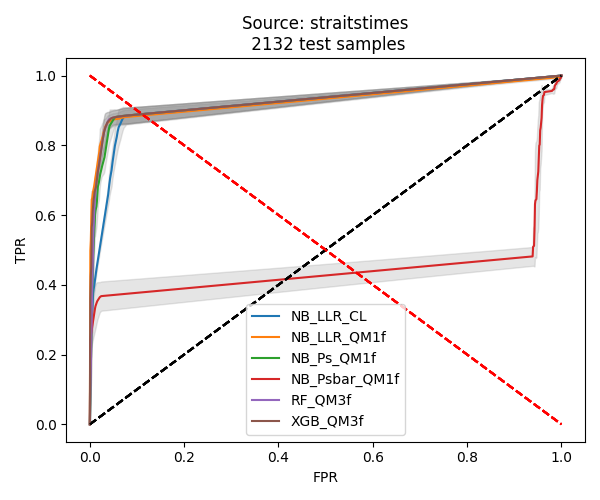

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
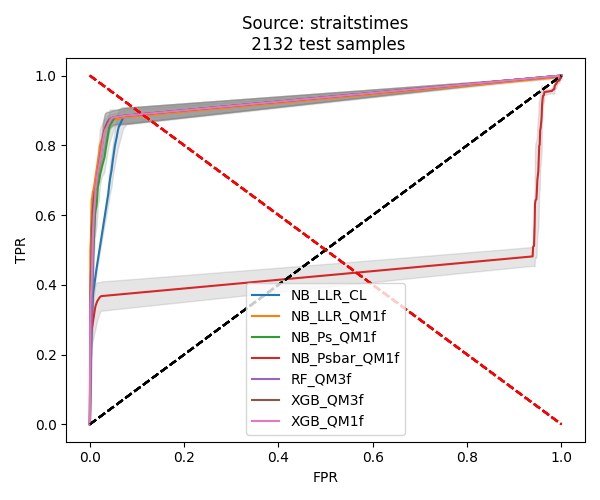

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
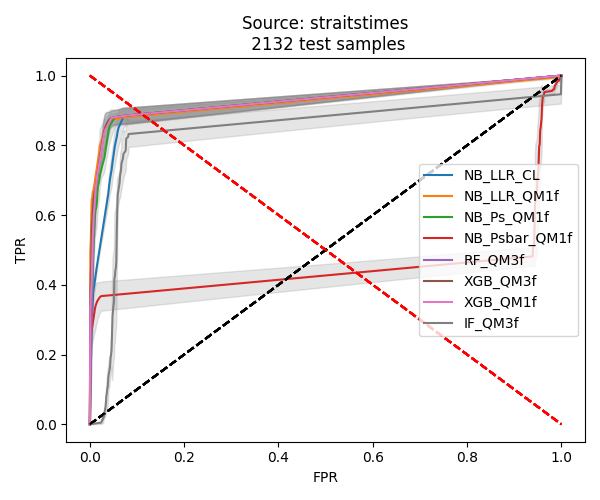

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
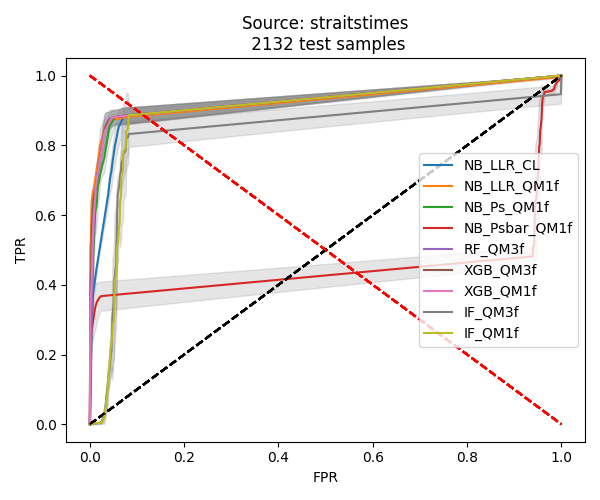

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
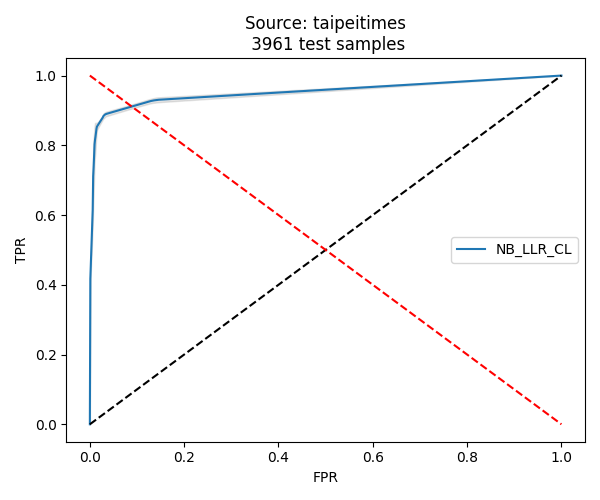

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
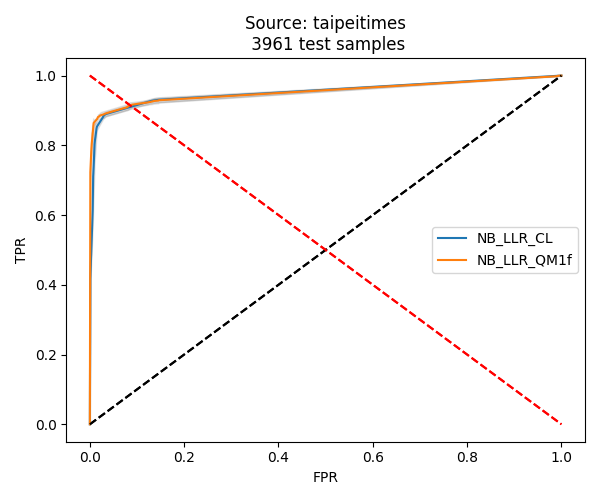

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
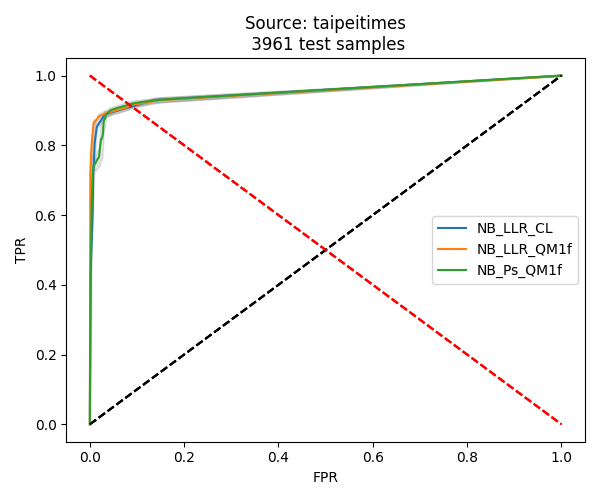

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
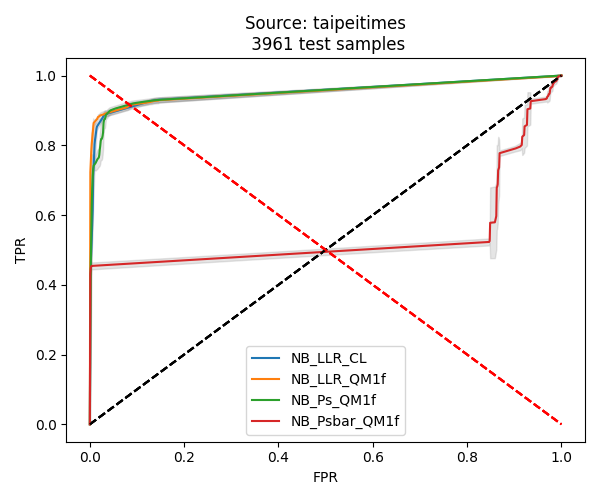

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
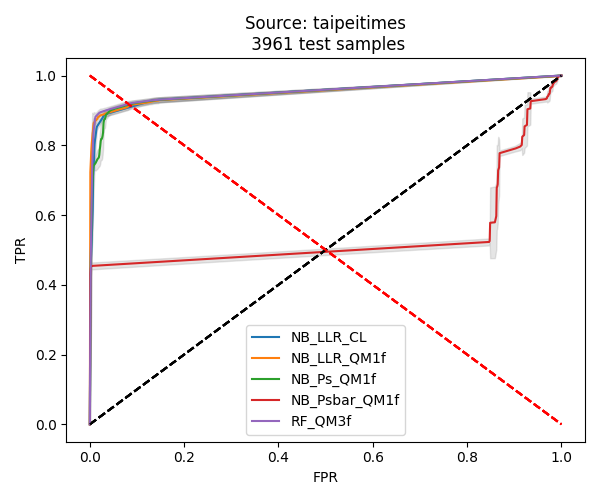

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
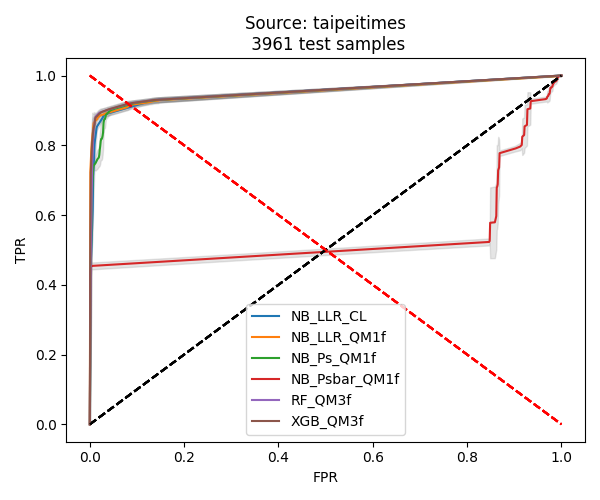

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
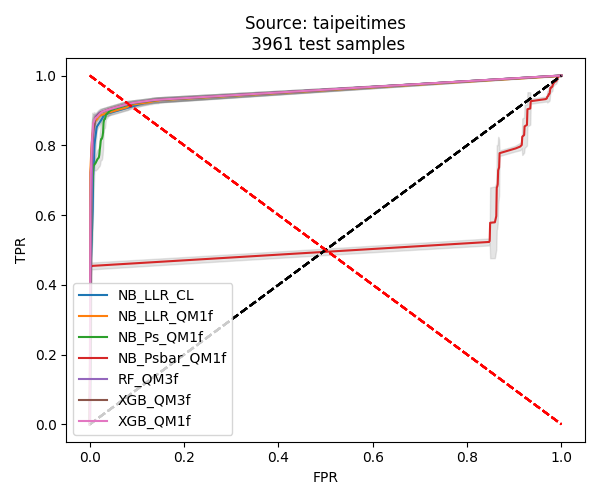

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
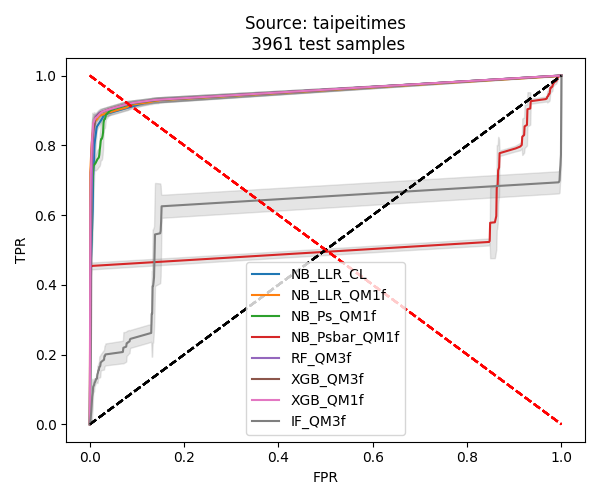

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
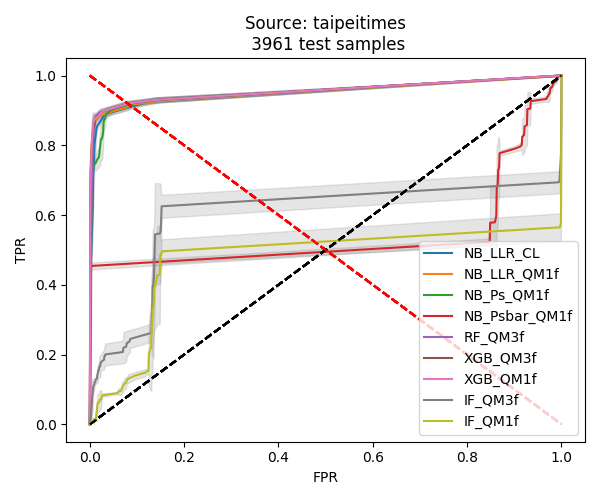

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
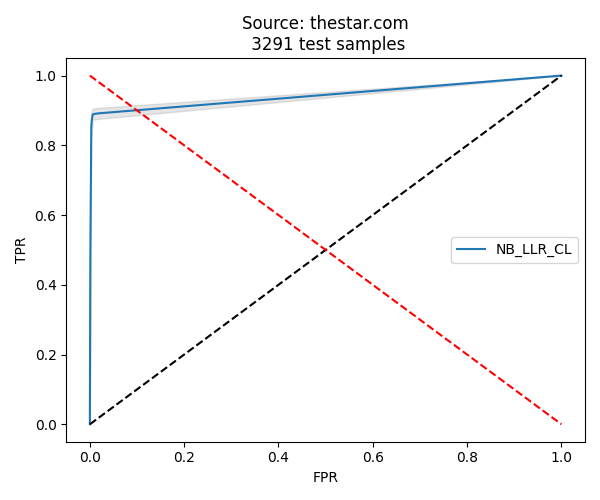

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
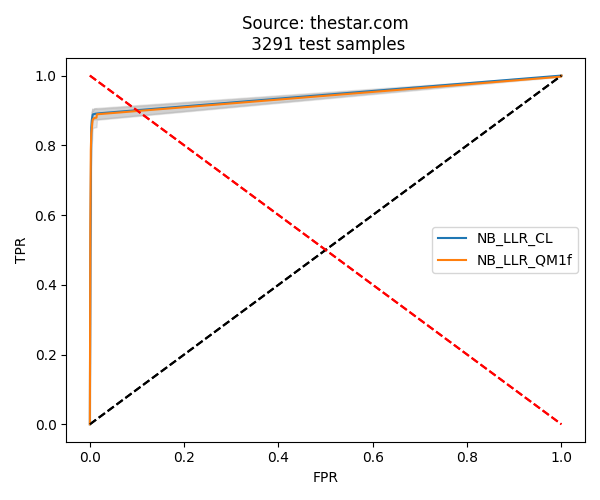

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
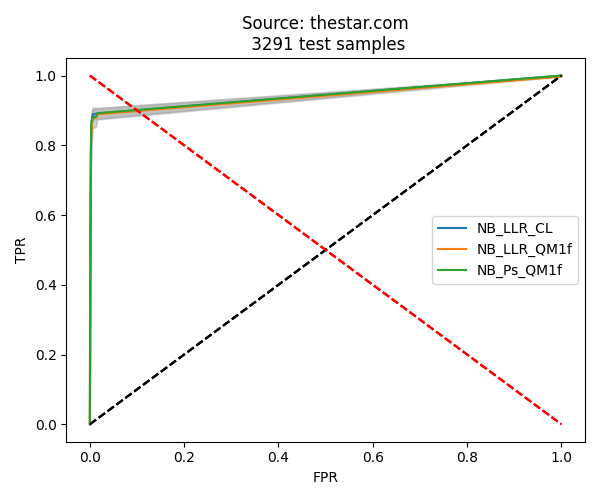

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
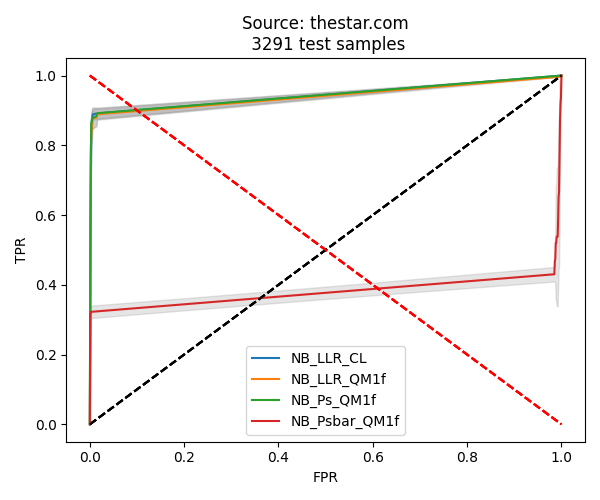

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
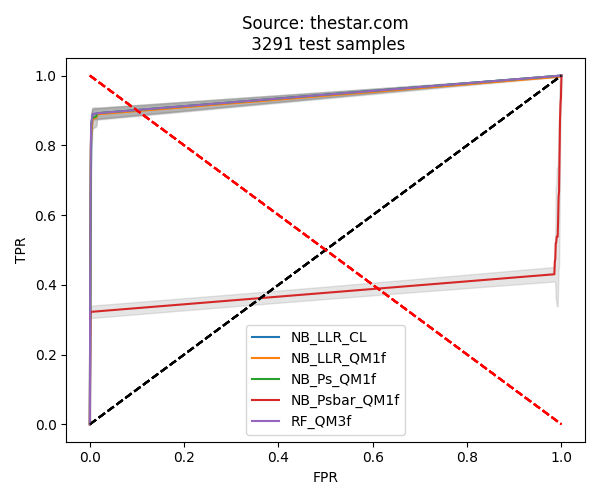

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
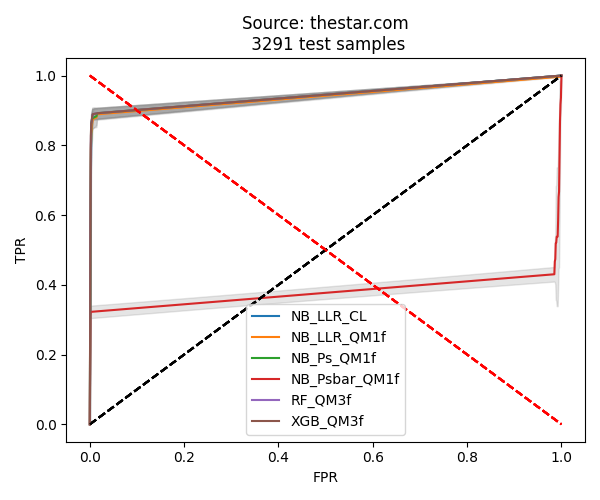

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
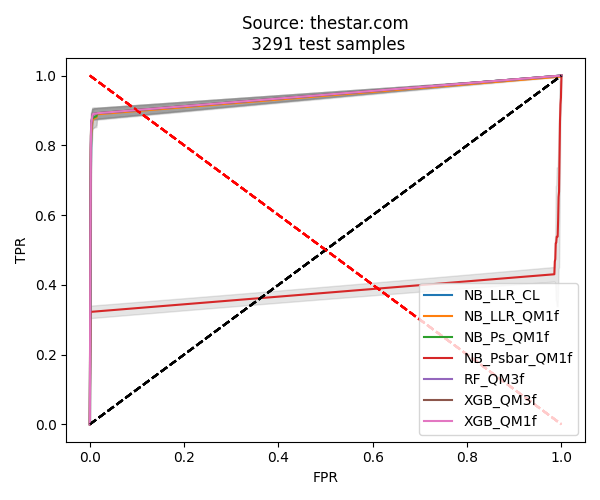

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
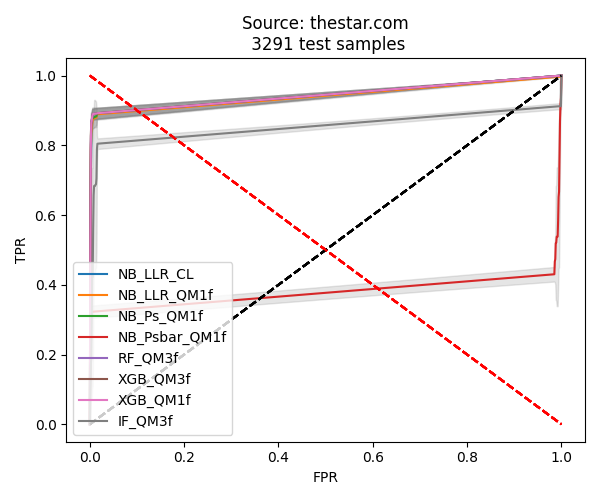

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
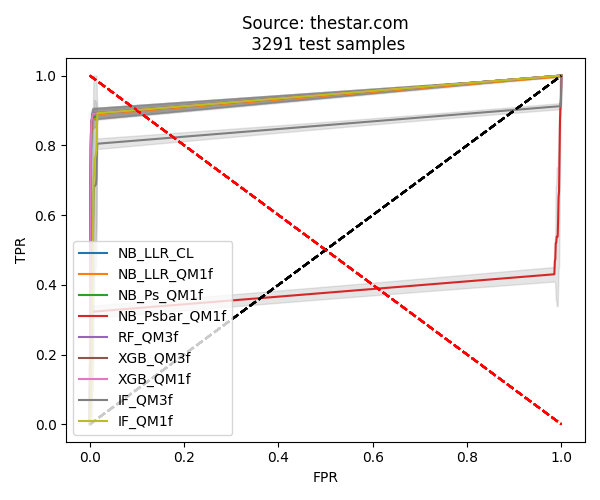

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
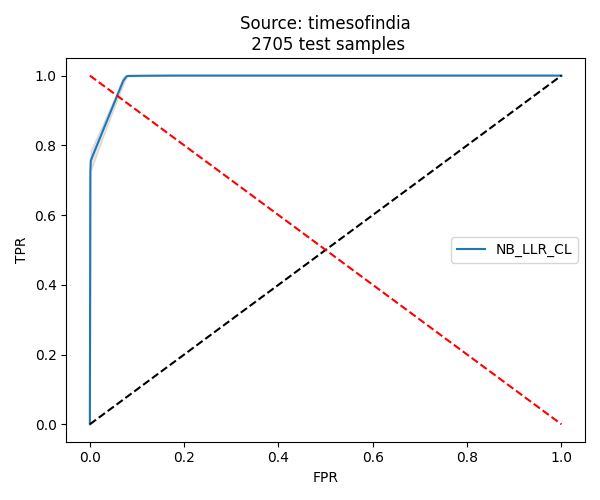

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
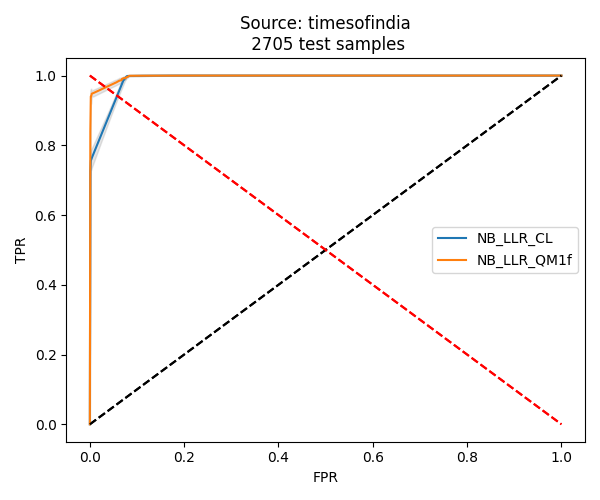

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
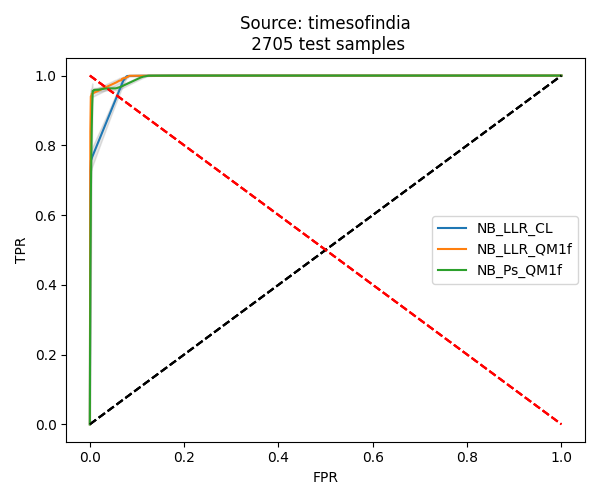

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
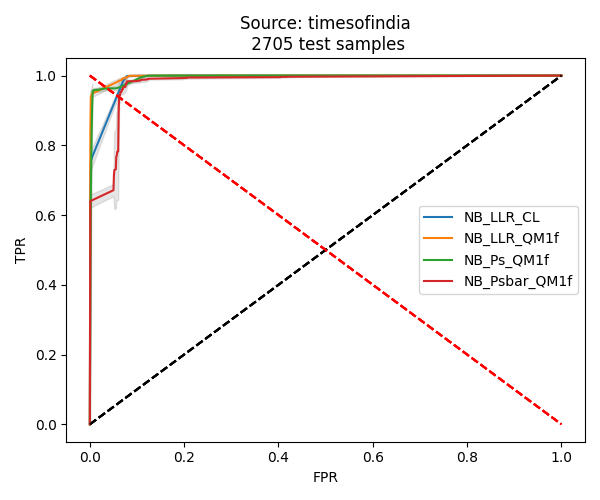

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
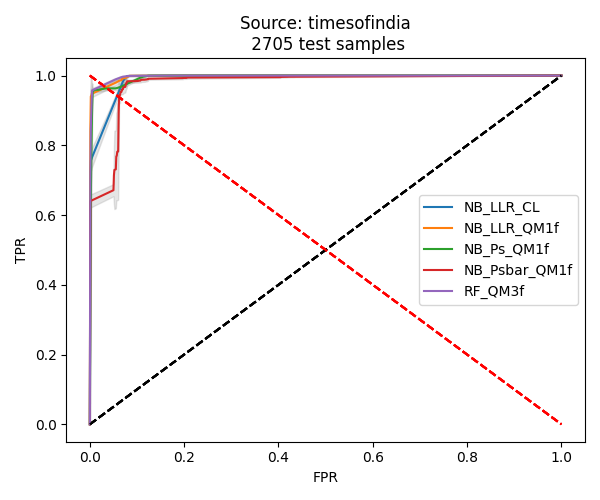

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
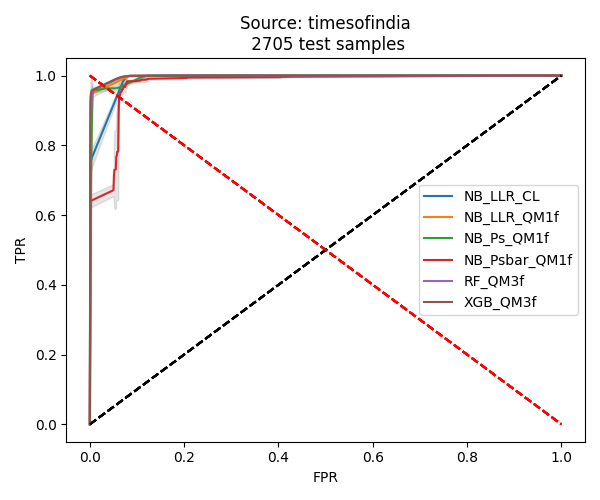

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
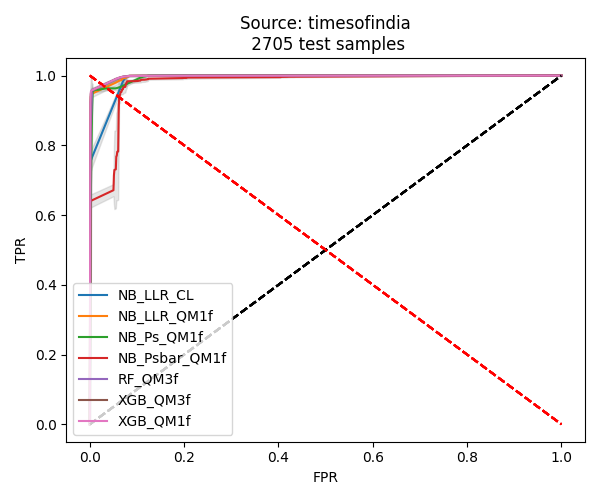

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
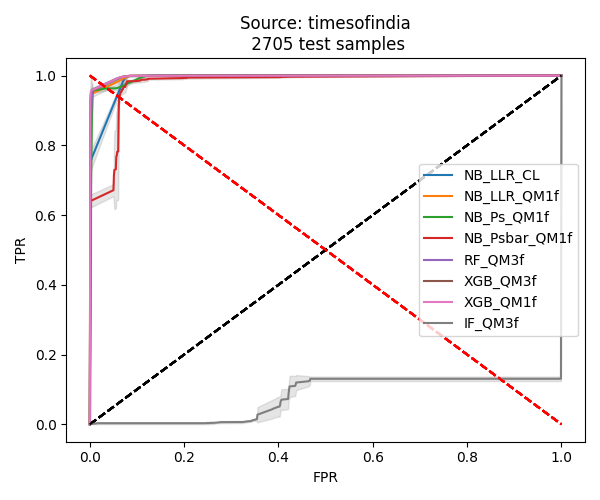

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
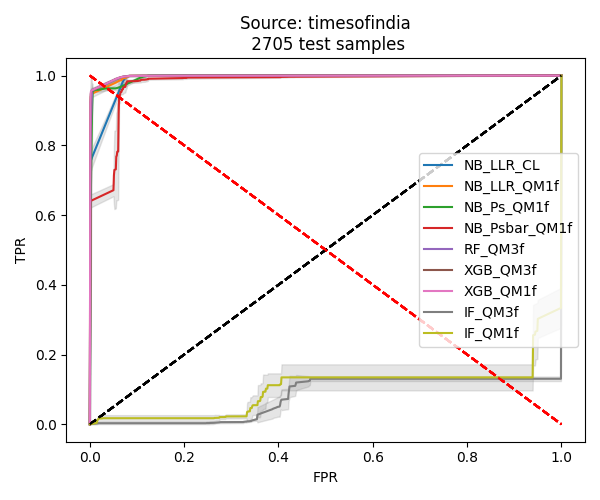

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
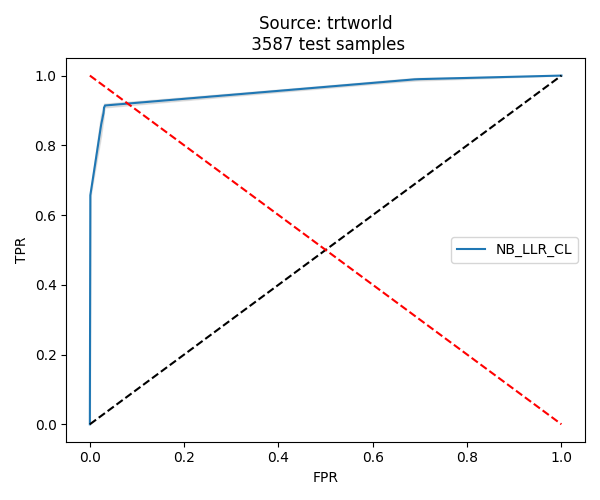

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
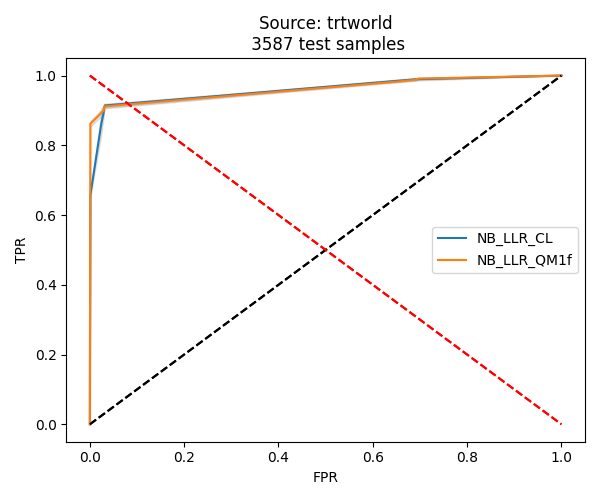

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
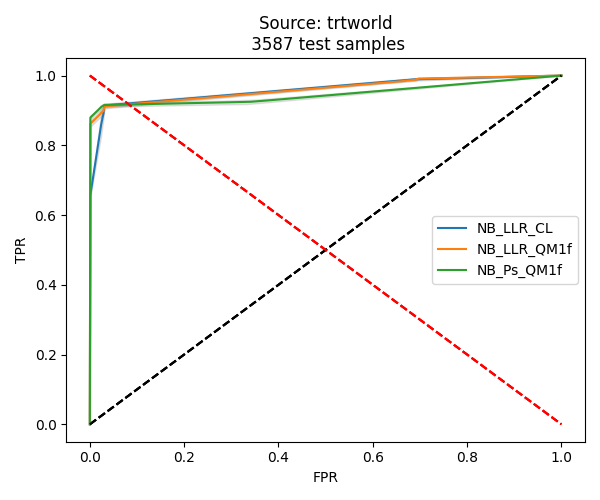

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
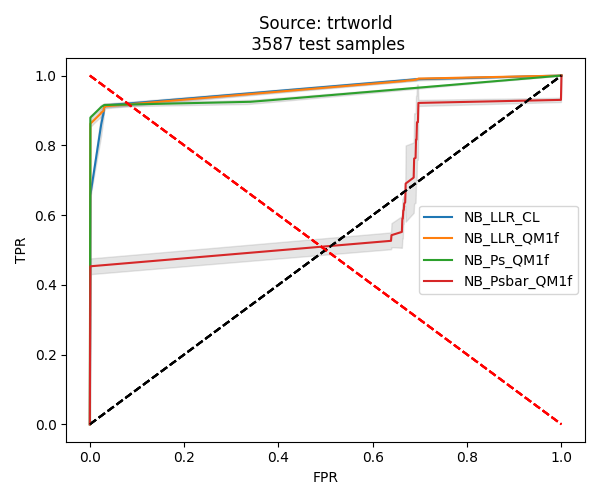

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
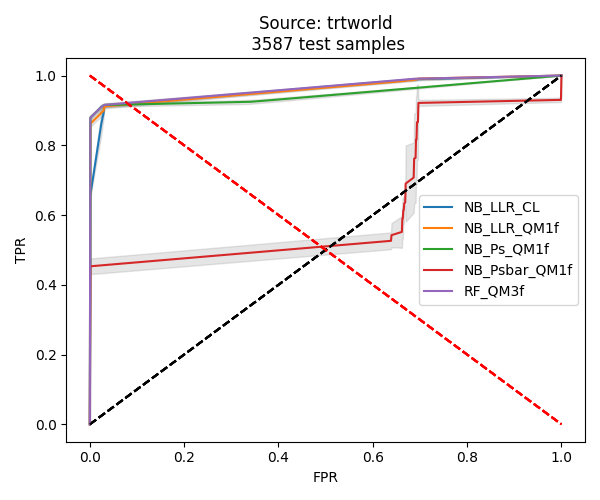

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
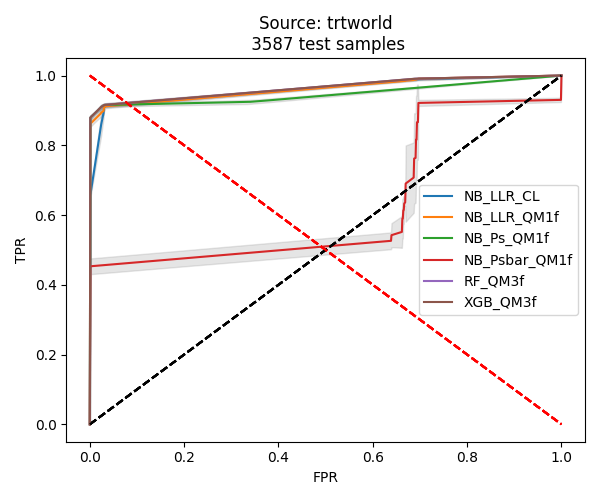

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
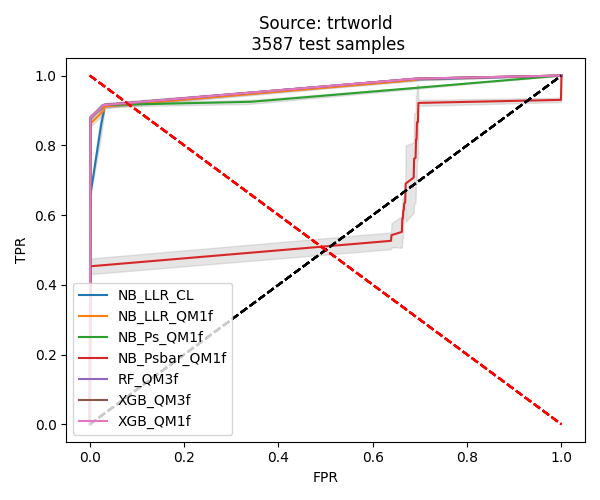

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
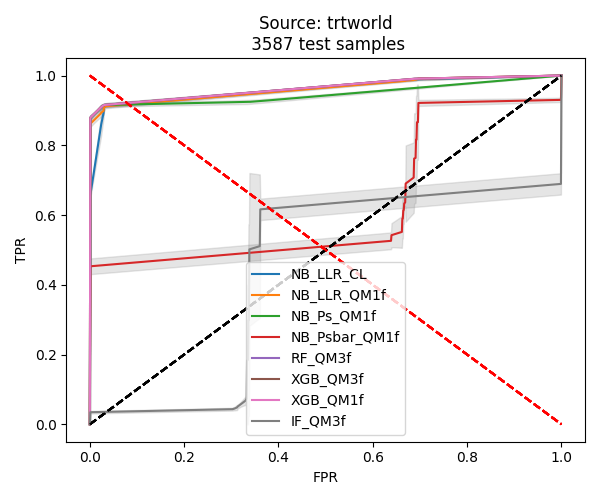

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
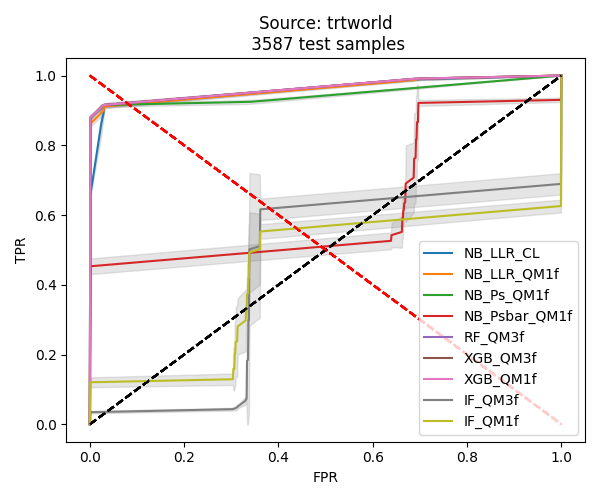

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
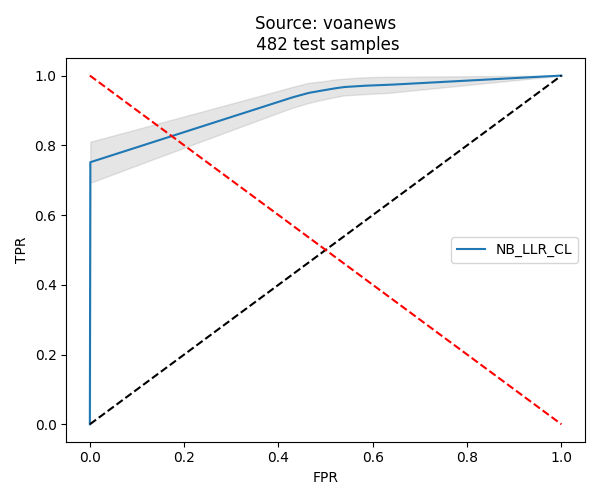

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
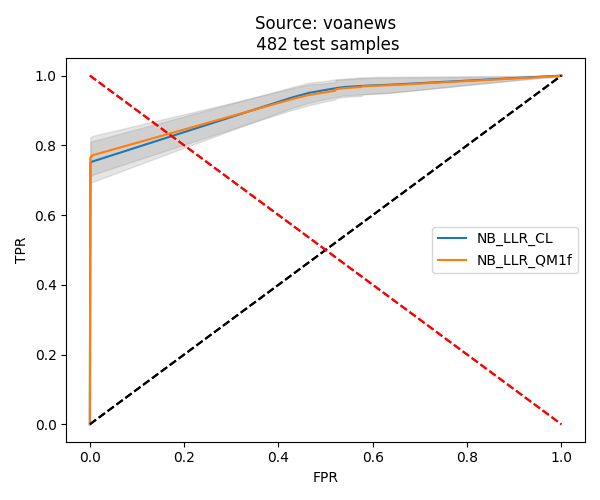

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
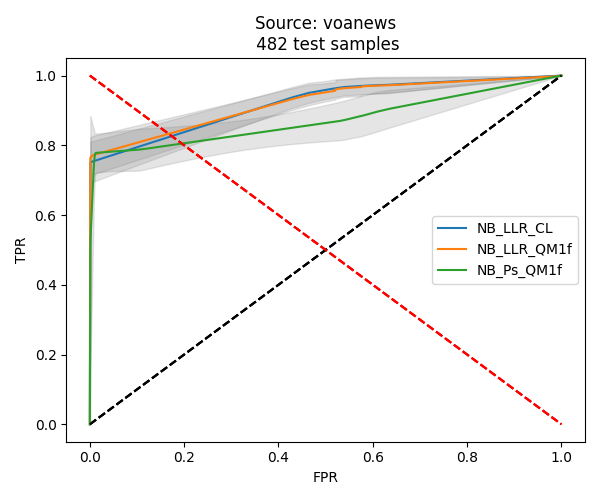

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
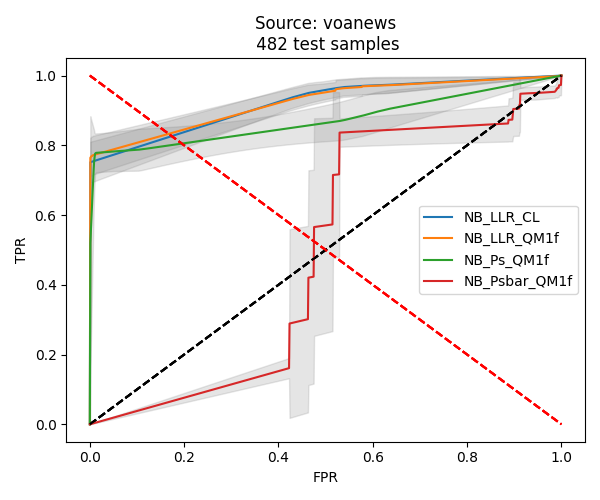

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
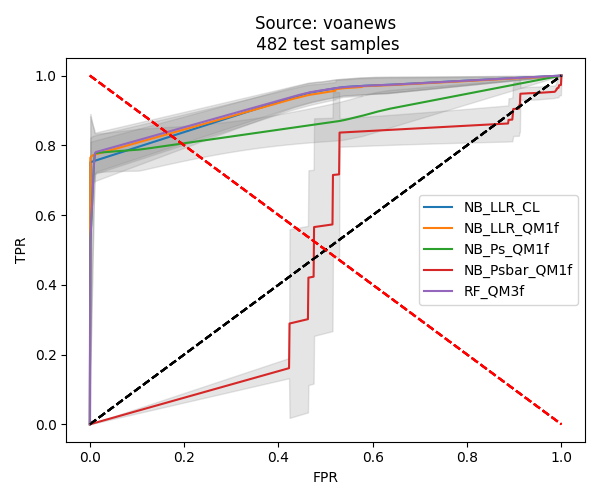

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
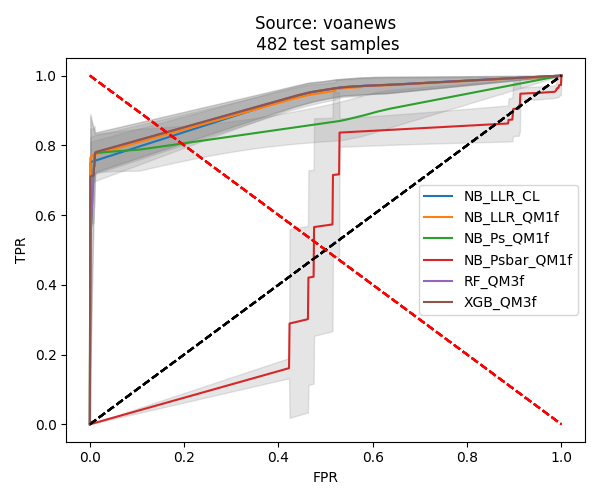

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
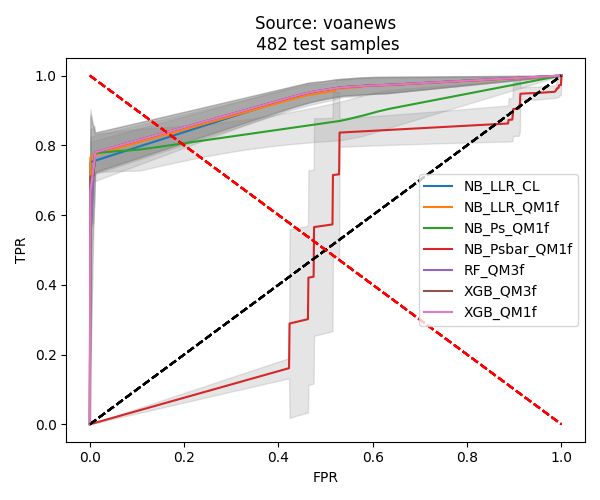

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
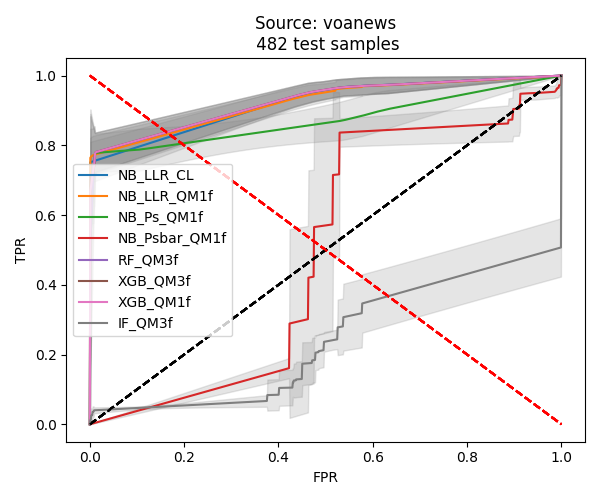

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
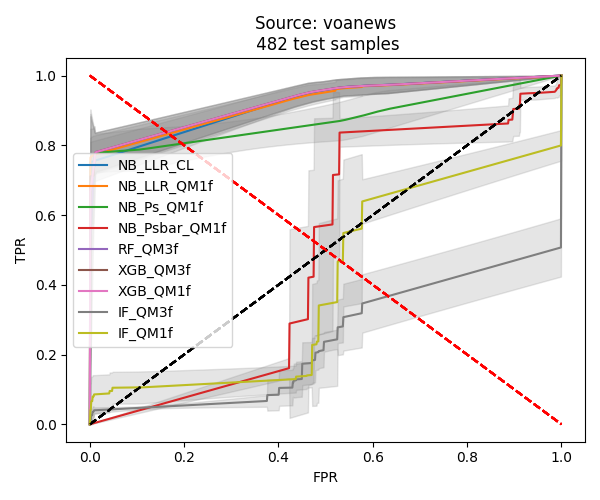

In [25]:
EERs_summary = {}
for model_name in model_names:
  EERs_summary[model_name] = {"EERs_over_trials":[], #each entry is array of 5 EERs from the 5 trials for a source
                              "EERs_mean":[],        #each entry is mean over trials for a source source
                              "EERs_std":[]          #each entry is std over trials for a source
                             }

interp_fpr = np.linspace(0, 1, 1000)

for source in sources:

  plt.figure(figsize=(6,5))

  #-----------------------------------------------
  #Plot performance of each model

  for model_name in model_names:

    #Arrays, one entry per source. One array per model.
    EERs_over_trials = []
    EERs_mean = []  
    EERs_std = [] 

    interp_tprs_over_trials = []
    #interpolate between fpr,tpr datapoints to compute tpr at regular fpr intervals
    for trial in range(NUM_TRIALS):
      fpr = results[source][model_name][trial]['fpr'] 
      tpr = results[source][model_name][trial]['tpr'] 
      interp_tpr = np.interp(interp_fpr, fpr, tpr)
      interp_tpr[0] = 0.0
      interp_tprs_over_trials.append(interp_tpr)  #array of interpolated tpr values, of length 5 for the 5 trials
    #------------
      EERs_over_trials.append(calculate_eer(interp_fpr, interp_tpr)) #get EER for this trial for this source
    EERs_summary[model_name]['EERs_over_trials'].append(EERs_over_trials)    #'EERs_over_trials' holds list of 5 EERs from 5 trials (for this source & model)
    EERs_summary[model_name]['EERs_std'].append(np.std(EERs_over_trials))  #gives a std of EER across all 5 trials (for this source & model)
    #------------

    #mean roc curve, across all 5 trails
    mean_tpr = np.mean(interp_tprs_over_trials, axis=0)
    mean_tpr[-1] = 1.0

    #from the 'mean roc curve' mean_tpr compute an EER, and call it the 'mean EER'
    EERs_summary[model_name]['EERs_mean'].append(calculate_eer(interp_fpr, mean_tpr))

    std_tpr = np.std(interp_tprs_over_trials, axis=0)
    tprs_upper = np.minimum(mean_tpr + std_tpr, 1)
    tprs_lower = np.maximum(mean_tpr - std_tpr, 0)

    plt.plot(interp_fpr, mean_tpr,  linestyle="-", label=model_name)
    plt.fill_between(interp_fpr, tprs_lower, tprs_upper, color='grey', alpha=.2)

    auc_mean = float(df_summary.loc[df_summary['source']==source, 'AUC_mean_{}'.format(model_name)])
    auc_std = float(df_summary.loc[ df_summary['source']==source, 'AUC_std_{}'.format(model_name)])
    tpr_at_fpr_mean = float(df_summary.loc[ df_summary['source']==source, 'tpr_at_fpr_mean_{}'.format(model_name)])
    numsamples = int(df_summary.loc[ df_summary['source']==source, 'test_size_mean'])

    #-----------------------------------------------

    plt.plot([0, 1], [0, 1], color="black", linestyle="--")
    plt.plot(np.linspace(0,1,100), 1-np.linspace(0,1,100), color="red", linestyle="--")
    plt.title('Source: {}\n {} test samples'.format(
        source, numsamples))
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.legend()
    plt.tight_layout() 
    plt.show()
  
  
for model_name in model_names:
  df_summary['EER_mean_{}'.format(model_name)] = EERs_summary[model_name]['EERs_mean']
  df_summary['EER_std_{}'.format(model_name)] = EERs_summary[model_name]['EERs_std']


In [26]:
df_summary

,source,test_size_mean,AUC_mean_NB_LLR_CL,AUC_mean_NB_LLR_QM1f,AUC_mean_NB_Ps_QM1f,AUC_mean_NB_Psbar_QM1f,AUC_mean_RF_QM3f,AUC_mean_XGB_QM3f,AUC_mean_XGB_QM1f,AUC_mean_IF_QM3f,AUC_mean_IF_QM1f,AUC_std_NB_LLR_CL,AUC_std_NB_LLR_QM1f,AUC_std_NB_Ps_QM1f,AUC_std_NB_Psbar_QM1f,AUC_std_RF_QM3f,AUC_std_XGB_QM3f,AUC_std_XGB_QM1f,AUC_std_IF_QM3f,AUC_std_IF_QM1f,tpr_at_fpr_mean_NB_LLR_CL,tpr_at_fpr_mean_NB_LLR_QM1f,tpr_at_fpr_mean_NB_Ps_QM1f,tpr_at_fpr_mean_NB_Psbar_QM1f,tpr_at_fpr_mean_RF_QM3f,tpr_at_fpr_mean_XGB_QM3f,tpr_at_fpr_mean_XGB_QM1f,tpr_at_fpr_mean_IF_QM3f,tpr_at_fpr_mean_IF_QM1f,EER_mean_NB_LLR_CL,EER_std_NB_LLR_CL,EER_mean_NB_LLR_QM1f,EER_std_NB_LLR_QM1f,EER_mean_NB_Ps_QM1f,EER_std_NB_Ps_QM1f,EER_mean_NB_Psbar_QM1f,EER_std_NB_Psbar_QM1f,EER_mean_RF_QM3f,EER_std_RF_QM3f,EER_mean_XGB_QM3f,EER_std_XGB_QM3f,EER_mean_XGB_QM1f,EER_std_XGB_QM1f,EER_mean_IF_QM3f,EER_std_IF_QM3f,EER_mean_IF_QM1f,EER_std_IF_QM1f
0,abc.net.au,3044,0.886784,0.899313,0.881207,0.335246,0.896354,0.899465,0.900356,0.439156,0.676881,0.013907,0.010433,0.011879,0.022772,0.010642,0.010806,0.011227,0.059329,0.024441,0.474841,0.428431,0.156653,0.138469,0.168449,0.363887,0.361304,0.038178,0.009373,0.184894,0.019733,0.161173,0.016215,0.167672,0.019027,0.716391,0.028917,0.159028,0.017062,0.159105,0.017194,0.159105,0.017194,0.530843,0.058638,0.283609,0.028917
1,airforcetimes.com,455,0.880578,0.880233,0.900806,0.177688,0.905129,0.905842,0.904813,0.475216,0.685700,0.018681,0.013608,0.020522,0.018303,0.019321,0.018680,0.019732,0.034040,0.042809,0.720026,0.596524,0.715856,0.000982,0.715312,0.752497,0.778791,0.142225,0.119335,0.194087,0.026561,0.180251,0.021072,0.164171,0.028508,0.835829,0.023469,0.160049,0.027103,0.160049,0.027103,0.161224,0.028332,0.507641,0.026948,0.296723,0.033859
2,aljazeera,2150,0.947289,0.958426,0.901325,0.869751,0.956296,0.957396,0.957492,0.198108,0.150552,0.005827,0.006160,0.006396,0.024190,0.004507,0.003524,0.003359,0.034410,0.019399,0.288713,0.528564,0.176164,0.329136,0.304787,0.405149,0.426483,0.001130,0.001130,0.105245,0.010709,0.098003,0.009064,0.166774,0.017588,0.135046,0.020782,0.097757,0.008456,0.097573,0.008041,0.098051,0.008072,0.805235,0.029302,0.837721,0.022924
3,allafrica.com,179,1.000000,1.000000,1.000000,0.977026,1.000000,1.000000,1.000000,0.246568,0.112348,0.000000,0.000000,0.000000,0.028287,0.000000,0.000000,0.000000,0.063507,0.023717,1.000000,1.000000,1.000000,0.975994,1.000000,1.000000,1.000000,0.246568,0.112348,0.001000,0.000000,0.001000,0.000000,0.001000,0.000000,0.023966,0.029828,0.001000,0.000000,0.001000,0.000000,0.001000,0.000000,0.753432,0.063507,0.887652,0.023717
4,americanfreepress,584,0.950334,0.976640,0.969569,0.879950,0.983158,0.984012,0.983160,0.248744,0.194778,0.008312,0.002563,0.002935,0.021422,0.002531,0.002054,0.002822,0.036546,0.031183,0.327499,0.632023,0.550639,0.408250,0.662099,0.690450,0.638215,0.001727,0.001727,0.103082,0.018859,0.078549,0.013377,0.099035,0.012139,0.132778,0.019139,0.059410,0.008718,0.060194,0.008590,0.060405,0.009168,0.664517,0.047512,0.712868,0.042038
5,asahi.com,513,0.957075,0.964268,0.968800,0.597473,0.970729,0.970729,0.970729,0.733560,0.399752,0.013899,0.010320,0.012377,0.047118,0.012521,0.012521,0.012521,0.123320,0.047679,0.701989,0.933322,0.939689,0.537871,0.939841,0.939841,0.939841,0.000961,0.000161,0.081083,0.010285,0.063048,0.019898,0.058588,0.022997,0.435222,0.044753,0.056912,0.022702,0.056912,0.022702,0.056912,0.022702,0.223896,0.109929,0.564778,0.044753
6,bbc,1752,0.955057,0.957135,0.894660,0.666715,0.958764,0.959141,0.958980,0.500210,0.503598,0.026786,0.025205,0.068558,0.021983,0.025096,0.025442,0.025294,0.013876,0.032983,0.594751,0.822048,0.701937,0.260149,0.705738,0.729820,0.698506,0.062249,0.096211,0.116996,0.053478,0.121317,0.051879,0.137676,0.088034,0.479483,0.004387,0.117133,0.053227,0.117133,0.053227,0.117133,0.053227,0.520482,0.004409,0.516239,0.004406
7,canadiandimension,2700,0.958306,0.970872,0.972906,0.578841,0.972906,0.973080,0.973307,0.731622,0.467424,0.007396,0.

In [27]:
cols_to_show = ['source'] + [x for x in df_summary.columns if x.startswith('EER_mean')]
df_summary[cols_to_show]

,source,EER_mean_NB_LLR_CL,EER_mean_NB_LLR_QM1f,EER_mean_NB_Ps_QM1f,EER_mean_NB_Psbar_QM1f,EER_mean_RF_QM3f,EER_mean_XGB_QM3f,EER_mean_XGB_QM1f,EER_mean_IF_QM3f,EER_mean_IF_QM1f
0,abc.net.au,0.184894,0.161173,0.167672,0.716391,0.159028,0.159105,0.159105,0.530843,0.283609
1,airforcetimes.com,0.194087,0.180251,0.164171,0.835829,0.160049,0.160049,0.161224,0.507641,0.296723
2,aljazeera,0.105245,0.098003,0.166774,0.135046,0.097757,0.097573,0.098051,0.805235,0.837721
3,allafrica.com,0.001000,0.001000,0.001000,0.023966,0.001000,0.001000,0.001000,0.753432,0.887652
4,americanfreepress,0.103082,0.078549,0.099035,0.132778,0.059410,0.060194,0.060405,0.664517,0.712868
5,asahi.com,0.081083,0.063048,0.058588,0.435222,0.056912,0.056912,0.056912,0.223896,0.564778
6,bbc,0.116996,0.121317,0.137676,0.479483,0.117133,0.117133,0.117133,0.520482,0.516239
7,canadiandimension,0.098911,0.068595,0.060684,0.440909,0.060844,0.060949,0.060844,0.194834,0.509310
8,ceasefire,0.148938,0.132811,0.173022,0.460965,0.136839,0.136446,0.136929,0.460583,0.517892
9,centurywire,0.228106,0.120676,0.155216,0.211851,0.156458,0.151660,0.142856,0.695098,0.739990


In [28]:
df_summary[cols_to_show].mean().sort_values()

/tmp/ipykernel_13/31404166.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df_summary[cols_to_show].mean().sort_values()


EER_mean_XGB_QM3f         0.112555
EER_mean_XGB_QM1f         0.112833
EER_mean_RF_QM3f          0.112856
EER_mean_NB_LLR_QM1f      0.116198
EER_mean_NB_Ps_QM1f       0.132580
EER_mean_NB_LLR_CL        0.133869
EER_mean_NB_Psbar_QM1f    0.437515
EER_mean_IF_QM1f          0.532386
EER_mean_IF_QM3f          0.538768
dtype: float64

### EER conclusions:
1. Using 3f or 1f features doesn't matter, get comparable results
1. RF comparable to XGB but RF is slighlty worse
1. NB_LLR_QM1f is pretty comparable to XGBoost in terms of EER (though much faster to train and run)
1. CL is worse than QM
1. Variants of NB (\_Ps\_ and \_Psbar\_) hurt performance, were the worse
1. Isolation forest IF had very bad performance.

In [29]:
cols_to_show = ['source'] + [x for x in df_summary.columns if x.startswith('AUC_mean')]
df_summary[cols_to_show].mean().sort_values()

/tmp/ipykernel_13/3000237413.py:2: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df_summary[cols_to_show].mean().sort_values()


AUC_mean_IF_QM3f          0.428298
AUC_mean_IF_QM1f          0.434830
AUC_mean_NB_Psbar_QM1f    0.602142
AUC_mean_NB_Ps_QM1f       0.920510
AUC_mean_NB_LLR_CL        0.927370
AUC_mean_NB_LLR_QM1f      0.939461
AUC_mean_RF_QM3f          0.939649
AUC_mean_XGB_QM1f         0.941373
AUC_mean_XGB_QM3f         0.941929
dtype: float64

In [30]:
cols_to_show = ['source'] + [x for x in df_summary.columns if x.startswith('tpr')]
df_summary[cols_to_show]

,source,tpr_at_fpr_mean_NB_LLR_CL,tpr_at_fpr_mean_NB_LLR_QM1f,tpr_at_fpr_mean_NB_Ps_QM1f,tpr_at_fpr_mean_NB_Psbar_QM1f,tpr_at_fpr_mean_RF_QM3f,tpr_at_fpr_mean_XGB_QM3f,tpr_at_fpr_mean_XGB_QM1f,tpr_at_fpr_mean_IF_QM3f,tpr_at_fpr_mean_IF_QM1f
0,abc.net.au,0.474841,0.428431,0.156653,0.138469,0.168449,0.363887,0.361304,0.038178,0.009373
1,airforcetimes.com,0.720026,0.596524,0.715856,0.000982,0.715312,0.752497,0.778791,0.142225,0.119335
2,aljazeera,0.288713,0.528564,0.176164,0.329136,0.304787,0.405149,0.426483,0.001130,0.001130
3,allafrica.com,1.000000,1.000000,1.000000,0.975994,1.000000,1.000000,1.000000,0.246568,0.112348
4,americanfreepress,0.327499,0.632023,0.550639,0.408250,0.662099,0.690450,0.638215,0.001727,0.001727
5,asahi.com,0.701989,0.933322,0.939689,0.537871,0.939841,0.939841,0.939841,0.000961,0.000161
6,bbc,0.594751,0.822048,0.701937,0.260149,0.705738,0.729820,0.698506,0.062249,0.096211
7,canadiandimension,0.685959,0.896679,0.910650,0.537934,0.912308,0.912308,0.912443,0.030006,0.064031
8,ceasefire,0.231443,0.507271,0.116725,0.302680,0.266878,0.426475,0.434219,0.030715,0.007588
9,centurywire,0.330468,0.585837,0.025757,0.463106,0.025757,0.132254,0.097590,0.023796,0.007500


In [31]:
df_summary[cols_to_show].mean().sort_values(ascending=False)

/tmp/ipykernel_13/1524768226.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df_summary[cols_to_show].mean().sort_values(ascending=False)


tpr_at_fpr_mean_NB_LLR_QM1f      0.689197
tpr_at_fpr_mean_XGB_QM3f         0.634095
tpr_at_fpr_mean_XGB_QM1f         0.628170
tpr_at_fpr_mean_NB_LLR_CL        0.553685
tpr_at_fpr_mean_RF_QM3f          0.552934
tpr_at_fpr_mean_NB_Ps_QM1f       0.507312
tpr_at_fpr_mean_NB_Psbar_QM1f    0.327567
tpr_at_fpr_mean_IF_QM3f          0.058199
tpr_at_fpr_mean_IF_QM1f          0.057930
dtype: float64

In [32]:
model_names

['NB_LLR_CL',
 'NB_LLR_QM1f',
 'NB_Ps_QM1f',
 'NB_Psbar_QM1f',
 'RF_QM3f',
 'XGB_QM3f',
 'XGB_QM1f',
 'IF_QM3f',
 'IF_QM1f']

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
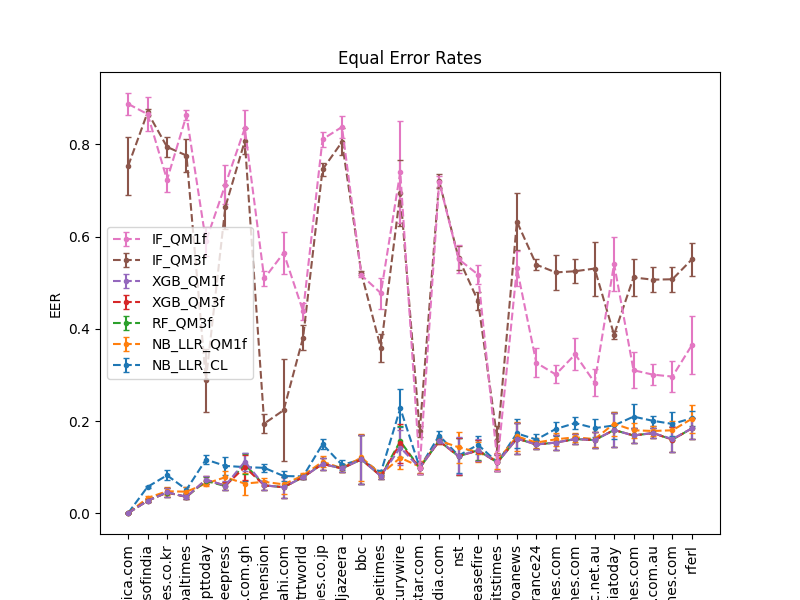

In [33]:
model_names_to_plot = ['NB_LLR_CL',  'NB_LLR_QM1f',   
                       'RF_QM3f',
                       'XGB_QM3f', 'XGB_QM1f',
                       'IF_QM3f', 'IF_QM1f']


df_metricplot =  df_summary.sort_values(by='AUC_mean_NB_LLR_QM1f', ascending=False).reset_index(drop=True)
sources_metricplot = list(df_metricplot['source'])

plt.figure(figsize=(8,6))
x_vals = [i for i,_ in enumerate(sources_metricplot)]

for model_name in model_names_to_plot:
  plt.errorbar(x_vals, df_metricplot['EER_mean_{}'.format(model_name)], 
               yerr=df_metricplot['EER_std_{}'.format(model_name)],
               fmt=".", linestyle="--", label=model_name, capsize=2)
               #color="tab:purple", mfc="tab:purple", mec='tab:purple', ecolor="tab:purple", )

    
plt.xticks(x_vals, sources_metricplot, rotation=90)

handles, labels = plt.gca().get_legend_handles_labels()
handles.reverse()
labels.reverse()
plt.legend(handles, labels, loc="center left")

plt.title("Equal Error Rates")

plt.ylabel("EER")

# plt.tight_layout()
plt.show()

### Conclusion: Isolation Forests didn't work well at all. Using 3 features slightly helped isolation forests vs 1 feature.  (But made no difference for XGB.)

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
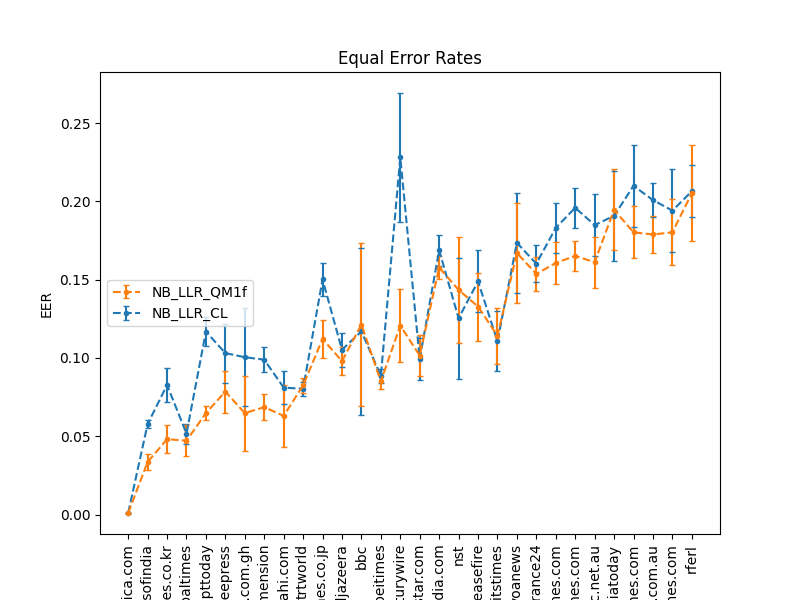

In [34]:
model_names_to_plot = ['NB_LLR_CL',  'NB_LLR_QM1f',   
                       ]


df_metricplot =  df_summary.sort_values(by='AUC_mean_NB_LLR_QM1f', ascending=False).reset_index(drop=True)
sources_metricplot = list(df_metricplot['source'])

plt.figure(figsize=(8,6))
x_vals = [i for i,_ in enumerate(sources_metricplot)]

for model_name in model_names_to_plot:
  plt.errorbar(x_vals, df_metricplot['EER_mean_{}'.format(model_name)], 
               yerr=df_metricplot['EER_std_{}'.format(model_name)],
               fmt=".", linestyle="--", label=model_name, capsize=2)
               #color="tab:purple", mfc="tab:purple", mec='tab:purple', ecolor="tab:purple", )

    
plt.xticks(x_vals, sources_metricplot, rotation=90)

handles, labels = plt.gca().get_legend_handles_labels()
handles.reverse()
labels.reverse()
plt.legend(handles, labels, loc="center left")

plt.title("Equal Error Rates")

plt.ylabel("EER")

# plt.tight_layout()
plt.show()

### Conclusion: QM features better than CL
We see using QM features with Naive Bayes Classifier gives consistent performance boost (lower EER scores)

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
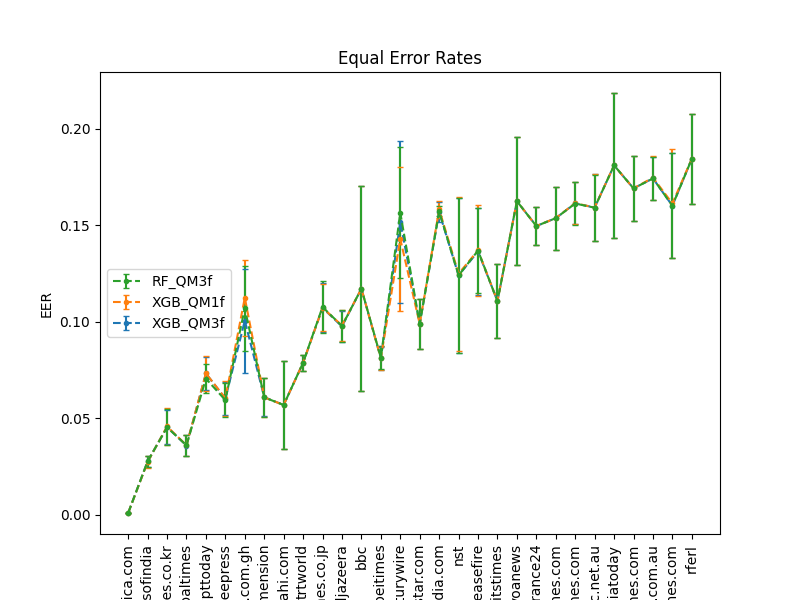

In [35]:
model_names_to_plot = ['XGB_QM3f', 'XGB_QM1f', 'RF_QM3f']


df_metricplot =  df_summary.sort_values(by='AUC_mean_NB_LLR_QM1f', ascending=False).reset_index(drop=True)
sources_metricplot = list(df_metricplot['source'])

plt.figure(figsize=(8,6))
x_vals = [i for i,_ in enumerate(sources_metricplot)]

for model_name in model_names_to_plot:
  plt.errorbar(x_vals, df_metricplot['EER_mean_{}'.format(model_name)], 
               yerr=df_metricplot['EER_std_{}'.format(model_name)],
               fmt=".", linestyle="--", label=model_name, capsize=2)
               #color="tab:purple", mfc="tab:purple", mec='tab:purple', ecolor="tab:purple", )

    
plt.xticks(x_vals, sources_metricplot, rotation=90)

handles, labels = plt.gca().get_legend_handles_labels()
handles.reverse()
labels.reverse()
plt.legend(handles, labels, loc="center left")

plt.title("Equal Error Rates")

plt.ylabel("EER")

# plt.tight_layout()
plt.show()

### Conclusion: XGB and RF close, maybe XGB slighly better than RF. 1f and 3f features performed the same.

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
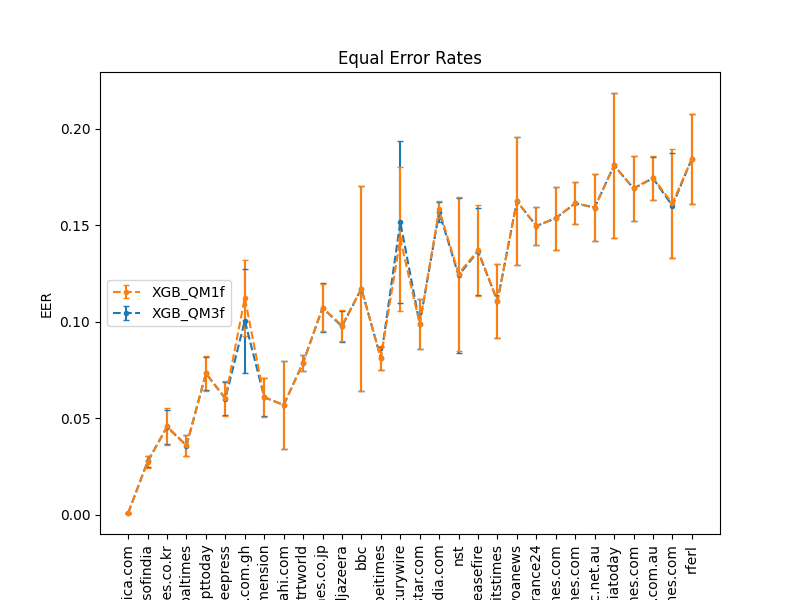

In [36]:
model_names_to_plot = ['XGB_QM3f', 'XGB_QM1f']


df_metricplot =  df_summary.sort_values(by='AUC_mean_NB_LLR_QM1f', ascending=False).reset_index(drop=True)
sources_metricplot = list(df_metricplot['source'])

plt.figure(figsize=(8,6))
x_vals = [i for i,_ in enumerate(sources_metricplot)]

for model_name in model_names_to_plot:
  plt.errorbar(x_vals, df_metricplot['EER_mean_{}'.format(model_name)], 
               yerr=df_metricplot['EER_std_{}'.format(model_name)],
               fmt=".", linestyle="--", label=model_name, capsize=2)
               #color="tab:purple", mfc="tab:purple", mec='tab:purple', ecolor="tab:purple", )

    
plt.xticks(x_vals, sources_metricplot, rotation=90)

handles, labels = plt.gca().get_legend_handles_labels()
handles.reverse()
labels.reverse()
plt.legend(handles, labels, loc="center left")

plt.title("Equal Error Rates")

plt.ylabel("EER")

# plt.tight_layout()
plt.show()
                       

### Conclusion: Using 1 combined feature or 3 separate featurews doesn't matter for XGBoost. (It did for Isolation Forests, but those performed badly in general.)
Tried XGB with 1 combined categorical feature, or 3 separate features. Didn't matter.

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
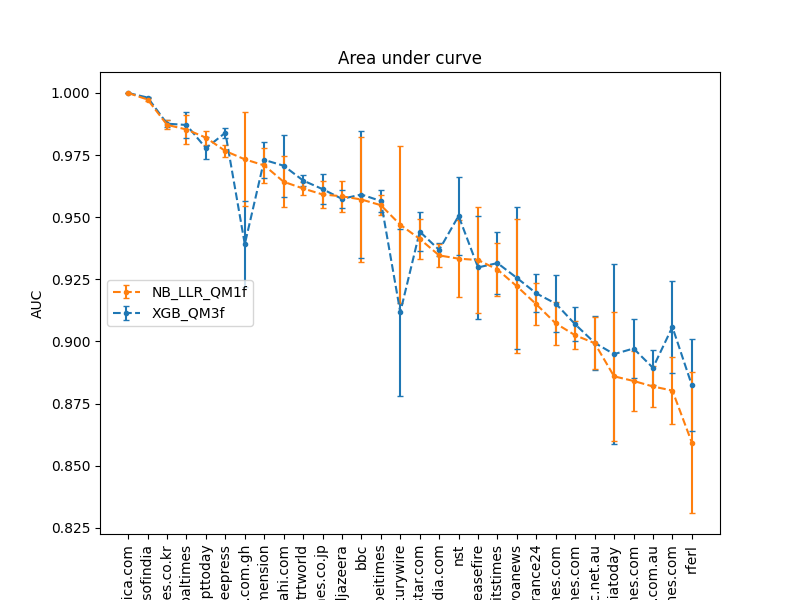

In [37]:
model_names_to_plot = ['XGB_QM3f', 'NB_LLR_QM1f']


df_metricplot =  df_summary.sort_values(by='AUC_mean_NB_LLR_QM1f', ascending=False).reset_index(drop=True)
sources_metricplot = list(df_metricplot['source'])

plt.figure(figsize=(8,6))
x_vals = [i for i,_ in enumerate(sources_metricplot)]

for model_name in model_names_to_plot:
  plt.errorbar(x_vals, df_metricplot['AUC_mean_{}'.format(model_name)], 
               yerr=df_metricplot['AUC_std_{}'.format(model_name)],
               fmt=".", linestyle="--", label=model_name, capsize=2)
               #color="tab:purple", mfc="tab:purple", mec='tab:purple', ecolor="tab:purple", )

    
plt.xticks(x_vals, sources_metricplot, rotation=90)

handles, labels = plt.gca().get_legend_handles_labels()
handles.reverse()
labels.reverse()
plt.legend(handles, labels, loc="center left")

plt.title("Area under curve")

plt.ylabel("AUC")

# plt.tight_layout()
plt.show()

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
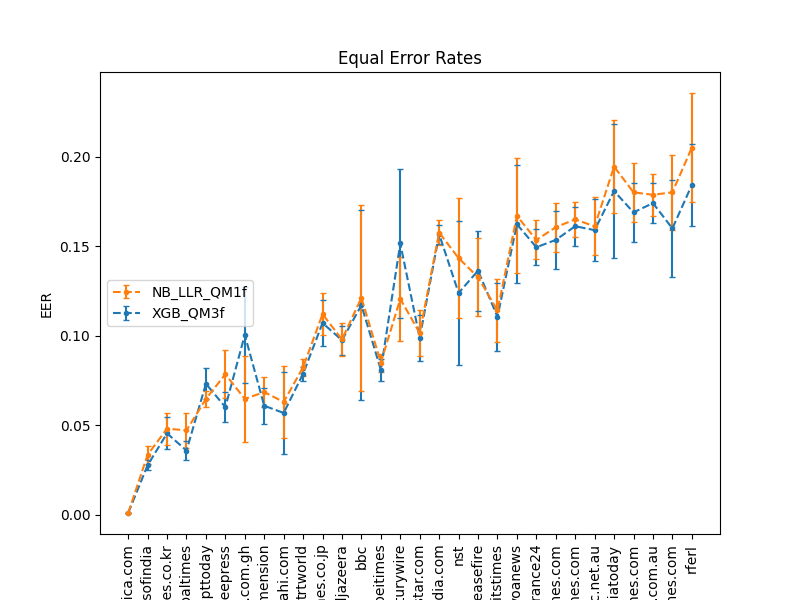

In [38]:
model_names_to_plot = ['XGB_QM3f', 'NB_LLR_QM1f']


df_metricplot =  df_summary.sort_values(by='AUC_mean_NB_LLR_QM1f', ascending=False).reset_index(drop=True)
sources_metricplot = list(df_metricplot['source'])

plt.figure(figsize=(8,6))
x_vals = [i for i,_ in enumerate(sources_metricplot)]

for model_name in model_names_to_plot:
  plt.errorbar(x_vals, df_metricplot['EER_mean_{}'.format(model_name)], 
               yerr=df_metricplot['EER_std_{}'.format(model_name)],
               fmt=".", linestyle="--", label=model_name, capsize=2)
               #color="tab:purple", mfc="tab:purple", mec='tab:purple', ecolor="tab:purple", )

    
plt.xticks(x_vals, sources_metricplot, rotation=90)

handles, labels = plt.gca().get_legend_handles_labels()
handles.reverse()
labels.reverse()
plt.legend(handles, labels, loc="center left")

plt.title("Equal Error Rates")

plt.ylabel("EER")

# plt.tight_layout()
plt.show()

### Conclusion: NB and XGB close performance wise, considering error bars.